In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os,glob
import seaborn as sns
from open_ephys.analysis import Session

from pynwb import NWBHDF5IO, NWBFile
from pynwb.file import Subject

from datetime import datetime
from dateutil.tz import tzlocal

from jlh_ephys.analysis import Analysis
from jlh_ephys.utils import choose_stim_parameter, OE
from jlh_ephys.psth_raster import psth_arr 
#from jlh_ephys import spatial_tools as st  ## compatability issues maybe need to install from allensdk.core.mouse_connectivity_cache import MouseConnectivityCache in its own env 
from jlh_ephys.raw import find_artifact_start, align_data, raw_heatmap

from ccf_3D.tools import herbs_processing as hp
from ccf_3D.tools.metrics import distance

import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

from scipy.ndimage import gaussian_filter1d

In [114]:
jlh31 = Analysis('jlh31', '2023-01-24') # all probes, many params and sites
jlh32 = Analysis('jlh32', '2023-02-18') # all probes, many params and sites
jlh33 = Analysis('jlh33', '2023-02-22') # probe B and C, many params and trains in diff recordings
jlh34 = Analysis('jlh34', '2023-05-15') # all 3 many params
jlh39 = Analysis('jlh39', '2023-08-16') # 3 probes for bi, no A for mono
jlh40 = Analysis('jlh40', '2023-08-21') # probeB and probe C only: monopolar -- with diff pulse width
jlh48 = Analysis('jlh48', '2024-11-05') # bb test, sorted only no bb portion (full bi and mono)
jlh49 = Analysis('jlh49v1', '2024-07-11') # bb test, just no bb portion (full bi only)
jlh53 = Analysis('jlh53concat', '2024-09-03') # regular, all 3 probes, probe A broke sometime. 

recordings = [jlh31, jlh32, jlh33, jlh34, jlh39, jlh40, jlh48, jlh49, jlh53]
slope_path = r"C:\Users\jordan\Documents\combined_figs\single_unit\unit_qual"
for r in recordings:
    r.get_brain_regs()
    r.get_electrode_coords()
    r.get_fs_rs(plot = False)
    slope_npy = glob.glob(os.path.join(slope_path, f'*{r.mouse}*'))[0]
    slope_outliers = np.load(slope_npy)
    r.units['slope_outlier'] = slope_outliers
    r.units['unit_id'] = r.units['probe'] + r.units['unit_id']

nn_contacts_labels = [6,11,3,14,1,16,2,15,5,12,4,13,7,10,8,9]

amp_alphas = {5: 0.3, 25: 0.5, 50: 0.7, 100: 1.0}
bipolar_color = '#82A69D'
cathodal_color = '#161943'
anodal_color = '#D99551'

c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


NWB found. Trials and Units loaded


c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\hdmf\spec\namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded


NWB found. Trials and Units loaded


INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded
INFO:root:Final adjusted brain regions loaded
INFO:root:Final adjusted coordinates loaded


In [115]:
import pickle as pkl
points_dict = pkl.load(open(r"C:\Users\jordan\Documents\combined_figs\evoked_potentials\points_dict.pkl", 'rb')) # oops natively in ap, dv, ml
recordings_dict = pkl.load(open(r"C:\Users\jordan\Documents\combined_figs\evoked_potentials\rec_dict_forpoints.pkl",'rb'))

stim_points = pkl.load(open(r"C:\Users\jordan\Documents\combined_figs\evoked_potentials\rec_dict_for_stimpoints.pkl", 'rb')) # natively in ap, ml, dv no need to convert

for k, v in points_dict.items():
    new_list = []
    for arr in v:
        arr = arr[:, [0, 2, 1]]  # keep AP, swap DV<->ML
        new_list.append(arr)
    points_dict[k] = new_list
    

#stim_points = {k: v[..., [0, 2, 1]] for k, v in stim_points.items()} # ap, ml, dv now!


In [153]:
recordings_dict

{'bipolar_-25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_-50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_-100': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_50': ['jlh31', 'jlh32', 'jlh34'],
 'bipolar_100': ['jlh32', 'jlh48'],
 'monopolar_-25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_-50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_-100': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_5': ['jlh32'],
 'monopolar_25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_100': ['jlh31', 'jlh32', 'jlh34', 'jlh48']}

In [151]:
points_dict

{'bipolar_-25': [array([[8225., 3168.,  702.],
         [9033., 3984., 1817.],
         [8515., 3519.,  742.],
         [7878., 3511., 1406.],
         [8181., 3396.,  810.],
         [8941., 2636., 1885.]]),
  array([[7470, 2950,  750],
         [7830, 3450, 1690],
         [8440, 3310,  580],
         [7740, 3310, 1320],
         [7370, 4190,  330],
         [7980, 3270, 1570]], dtype=int32),
  array([[7470., 2950.,  750.],
         [8679., 3503., 1238.],
         [8741., 3349.,  516.],
         [7836., 3325., 1421.],
         [8281., 3396.,  760.],
         [9004., 2657., 1819.]]),
  array([[7470., 2950.,  750.],
         [8937., 3428., 1668.],
         [8894., 3408.,  627.],
         [7774., 3392., 1771.],
         [7913., 3497.,  607.],
         [8575., 2302., 2012.]])],
 'bipolar_-50': [array([[8184., 3129.,  646.],
         [8930., 3866., 1690.],
         [8543., 3495.,  714.],
         [7779., 3519., 1477.],
         [7944., 3597.,  498.],
         [8944., 2598., 1912.]]),
  ar

In [150]:
stim_points

{'jlh31_bipolar_-25': array([8428., 3303., 1288.]),
 'jlh32_bipolar_-25': array([7840, 3404, 1380]),
 'jlh34_bipolar_-25': array([8428., 3303., 1100.]),
 'jlh48_bipolar_-25': array([8508., 3176., 1234.]),
 'jlh31_bipolar_-50': array([8428., 3303., 1288.]),
 'jlh32_bipolar_-50': array([7840, 3404, 1380]),
 'jlh34_bipolar_-50': array([8428., 3303., 1100.]),
 'jlh48_bipolar_-50': array([8508., 3176., 1234.]),
 'jlh31_bipolar_-100': array([8428., 3303., 1288.]),
 'jlh32_bipolar_-100': array([7840, 3404, 1380]),
 'jlh34_bipolar_-100': array([8428., 3303., 1100.]),
 'jlh48_bipolar_-100': array([8508., 3176., 1234.]),
 'jlh31_bipolar_25': array([8428., 3303., 1288.]),
 'jlh32_bipolar_25': array([7840, 3404, 1380]),
 'jlh34_bipolar_25': array([8428., 3303., 1100.]),
 'jlh48_bipolar_25': array([8508., 3176., 1234.]),
 'jlh31_bipolar_50': array([8428., 3303., 1288.]),
 'jlh32_bipolar_50': array([7840, 3404, 1380]),
 'jlh34_bipolar_50': array([8428., 3303., 1100.]),
 'jlh32_bipolar_100': array([7

## specific comparison of Probe B and ProbeC

In [54]:
for r in recordings:
    print(f'{r.mouse}: {r.probes}')

jlh31: ['probeA', 'probeB', 'probeC']
jlh32: ['probeA', 'probeB', 'probeC']
jlh33: ['probeB', 'probeC']
jlh34: ['probeA', 'probeB', 'probeC']
jlh39: ['probeA', 'probeB', 'probeC']
jlh40: ['probeB', 'probeC']
jlh48: ['probeA', 'probeB', 'probeC']
jlh49v1: ['probeA', 'probeB', 'probeC']
jlh53concat: ['probeA', 'probeB', 'probeC']


In [55]:
## load the spatial data for each recording (from figure 2) and lets see if we can do some sub analyses for probe B and C
# probe B directly crosses the cc boundary while probe C largely remains in the neocortex 

import pickle

df_results = pd.read_pickle(os.path.join('intermediates', 'EP_boundaries_w_array_distances_curated.pkl'))


recording_names = ['jlh31', 'jlh32', 'jlh33', 'jlh34', 'jlh39', 'jlh40', 'jlh48', 'jlh49v1', 'jlh53concat']
recordings = [jlh31, jlh32, jlh33, jlh34, jlh39, jlh40, jlh48, jlh49, jlh53]

# Create the recording map
recording_map = {name: recording for name, recording in zip(recording_names, recordings)}

with open(r'intermediates\mean_aligned_sub_data.pkl', 'rb') as f:
    array_list = pickle.load(f)

df_results['mean_aligned_sub_data'] = array_list

In [56]:
df_results.head()

,recording,probe,run,stim_parameters,max_idx,max_volt,half_max,half_max_upper_idx,half_max_lower_idx,lower_bound_idx,...,half_max_upper_idx_aligned,half_max_lower_idx_aligned,lower_bound_idx_aligned,upper_bound_idx_aligned,half_max_AUC,full_AUC,half_max_upper_dist,half_max_lower_dist,upper_bound_dist,lower_bound_dist
0,jlh31,probeA,0,"amp: -25 ua, pw: 100 us, contacts: 16r_2b",123,54.988943,27.494471,170,52,22,...,447,329,299,458,4679.986692,5702.399165,-393.883231,820.877579,-505.895246,1138.256122
1,jlh31,probeA,1,"amp: 25 ua, pw: 100 us, contacts: 16r_2b",125,115.154814,57.577407,181,84,63,...,456,359,338,470,9035.814406,10383.721875,-505.895246,511.055770,-622.460441,748.248622
2,jlh31,probeA,2,"amp: -50 ua, pw: 100 us, contacts: 16r_2b",122,123.950754,61.975377,171,77,40,...,449,355,318,467,9064.809696,11288.498274,-399.443363,591.261364,-581.271021,938.870066
3,jlh31,probeA,3,"amp: 50 ua, pw: 100 us, contacts: 16r_2b",121,70.689208,35.344604,184,78,70,...,463,357,349,477,5769.294662,6459.269968,-538.558261,590.364294,-656.912475,667.479588
4,jlh31,probeA,4,"amp: -100 ua, pw: 100 us, contacts: 16r_2b",113,161.665679,80.832839,160,92,51,...,447,379,338,483,8474.709654,12383.661506,-318.084894,435.219485,-654.854946,865.060114


C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\973366355.py:57: RuntimeWarning: Mean of empty slice
  data_to_plot = np.nanmean(combined_array, axis=0).T
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\973366355.py:57: RuntimeWarning: Mean of empty slice
  data_to_plot = np.nanmean(combined_array, axis=0).T
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\973366355.py:57: RuntimeWarning: Mean of empty slice
  data_to_plot = np.nanmean(combined_array, axis=0).T
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\973366355.py:57: RuntimeWarning: Mean of empty slice
  data_to_plot = np.nanmean(combined_array, axis=0).T
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\973366355.py:57: RuntimeWarning: Mean of empty slice
  data_to_plot = np.nanmean(combined_array, axis=0).T
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\973366355.py:57: RuntimeWarning: Mean of empty slice
  data_to_plot = np.nanmean(combined_array, axis=0).T
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\9

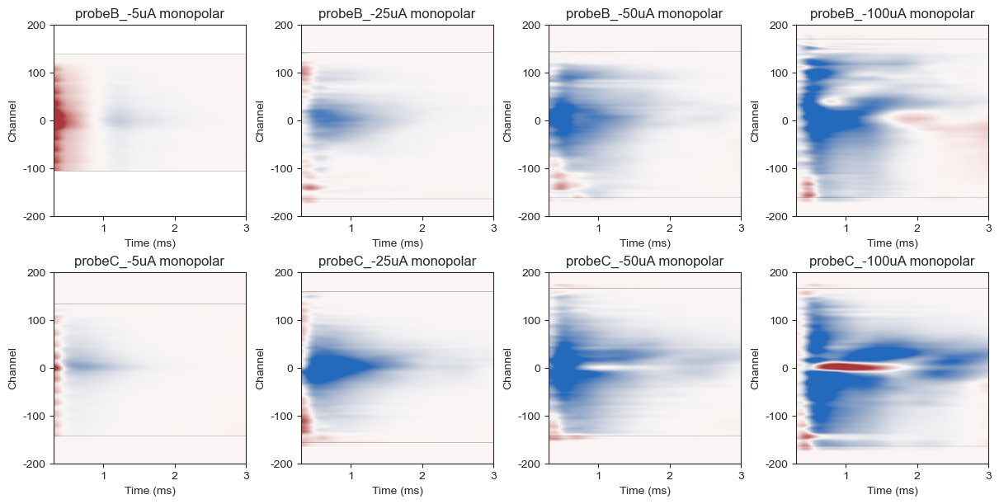

In [71]:
from scipy.ndimage import gaussian_filter

amp = -50 
polarity = 'monopolar'
df_results_w_array = df_results.copy()

pre = -0.3
post = 5 

fig, axs = plt.subplots(2, 4, figsize=(12, 6), constrained_layout=True)

pad = 400 
mean_array_bycondition = {}
for i, amp in enumerate([-5, -25, -50, -100]):
    for j, probe in enumerate(['probeB', 'probeC']):
        df = df_results_w_array[
            (df_results_w_array['max_volt'] > 40) & 
            (df_results_w_array['amplitude'] == amp) & 
            (df_results_w_array['polarity'] == polarity) &
            (df_results_w_array['probe'] == probe) &
            (df_results_w_array['half_max_lower_idx'] != -1) &
            (df_results_w_array['half_max_upper_idx'] != -1) &
            (df_results_w_array['lower_bound_idx'] != -1) &
            (df_results_w_array['upper_bound_idx'] != -1)
        ].reset_index()

        ax = axs[j, i]
        
        combined_array = np.zeros((len(df), df.iloc[0]['mean_aligned_sub_data'].shape[0], 800)) #800 for padded
        
        for _, dfrow in df.iterrows():
            array = dfrow['mean_aligned_sub_data']
            gauss_array = gaussian_filter1d(array, sigma=1, axis=1)
            
            ## pad it
            max_idx = dfrow['max_idx']
            upper_gauss = gauss_array[:, max_idx:]
            lower_gauss = gauss_array[:, :max_idx]
            
            if upper_gauss.shape[1] < pad:
                upper_pad = [np.nan] * (pad - upper_gauss.shape[1])
                padded_upper_gauss = np.zeros((upper_gauss.shape[0], pad))
                for jj in range(upper_gauss.shape[0]):
                    padded_upper_gauss[jj] = np.concatenate([upper_gauss[jj], upper_pad])
            
            if lower_gauss.shape[1] < pad:
                lower_pad = [np.nan] * (pad - lower_gauss.shape[1])
                padded_lower_gauss = np.zeros((lower_gauss.shape[0], pad))
                for ii in range(lower_gauss.shape[0]):
                    padded_lower_gauss[ii] = np.concatenate([lower_pad, lower_gauss[ii]])
            
            padded_gauss = np.concatenate([padded_lower_gauss, padded_upper_gauss], axis=1)

            combined_array[_, :, :] = padded_gauss
            
            mean_array_bycondition[f'{polarity}_{amp}'] = combined_array #3D n (probe, run, etc) x samples x channels 
            data_to_plot = np.nanmean(combined_array, axis=0).T
            data_to_plot = gaussian_filter(data_to_plot, sigma=2)
            #data_to_plot = gaussian_filter1d(data_to_plot, sigma=2, axis=1)
            #data_to_plot = gaussian_filter1d(data_to_plot, sigma = 2, axis=0)
            time_ms = np.linspace(-pre, post, data_to_plot.shape[0])
            ax.imshow(data_to_plot, aspect='auto', vmax=200, vmin=-200, origin='lower', cmap='vlag',
                    extent=[time_ms[0], time_ms[-1], 0, data_to_plot.shape[0]])
            
            ax.set_ylim(200, 600)
            ax.set_title(f'{probe}_{amp}uA {polarity}')
            ax.set_xlim(-pre, 3)
            ax.set_xlabel('Time (ms)')
    
            ax.set_ylabel('Channel')
            
            ax.set_yticks([200, 300, 400, 500, 600], [-200, -100, 0, 100, 200])
            #ax.set_yticklabels(np.arange(-100, 101, 50))
        



In [78]:
polarity

'monopolar'

C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\1210755278.py:23: RuntimeWarning: Mean of empty slice
  mean_aligned_matrix = np.nanmean(aligned_matrix, axis=0)
c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\numpy\lib\_nanfunctions_impl.py:2019: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


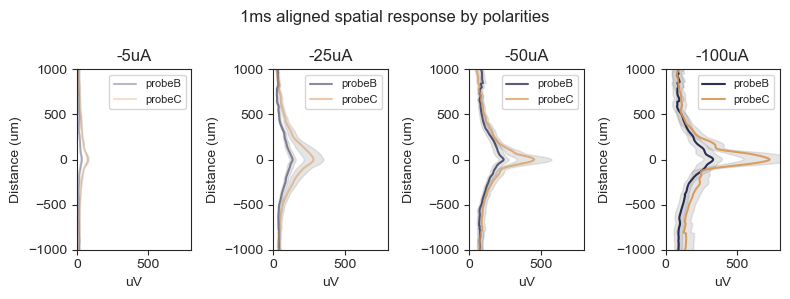

In [80]:
mean_boundaries_bycondition = {}

fig, axs = plt.subplots(1, 4, figsize=(8, 3))  # 2 rows for polarities, 2 columns for amplitude sign
fig.suptitle('1ms aligned spatial response by polarities', fontsize=12)
colors = [cathodal_color, anodal_color, bipolar_color]
polarity = 'monopolar'
amps = [-5, -25, -50, -100]
for i, probe in enumerate(['probeB', 'probeC']):
    for k, amp in enumerate(amps):
        ax = axs[k]
        df = df_results[
            (df_results['max_volt'] > 40) & 
            (df_results['amplitude'] == amp) & 
            (df_results['polarity'] == polarity) &
            (df_results['probe'] == probe) &
            (df_results['half_max_lower_idx'] != -1) & 
            (df_results['half_max_upper_idx'] != -1) &
            (df_results['lower_bound_idx'] != -1) & 
            (df_results['upper_bound_idx'] != -1)
        ]

        aligned_matrix = np.array(df['aligned_mean_gauss'].tolist())
        mean_aligned_matrix = np.nanmean(aligned_matrix, axis=0)
        sem_aligned_matrix = np.nanstd(aligned_matrix, axis=0) / np.sqrt(np.sum(~np.isnan(aligned_matrix), axis=0))

        normalized_distances = np.arange(-4000, 4000, 10)

        # Plot SEM error cloud
        ax.fill_betweenx(
            normalized_distances, 
            mean_aligned_matrix - sem_aligned_matrix, 
            mean_aligned_matrix + sem_aligned_matrix, 
            color='gray', alpha=0.2   # Use different colors for each amplitude
        )

        # Plot the mean response
        ax.plot(mean_aligned_matrix, normalized_distances, label=f'{probe}', color=colors[i], alpha = 0.3 + (k * 0.2))


        ax.set_xlim([0, 800])
        ax.set_ylim([-1000, 1000])
        ax.set_title(f'{amp}uA')
        ax.set_xlabel('uV')
        ax.set_ylabel('Distance (um)')
        ax.legend(loc='upper right', fontsize=8)

# Adjust layout and save figures
plt.tight_layout()

probeB ccf -5uA: upper mean -503.89 ± 0.00; lower mean 821.52 ± 0.00
probeB ccf -25uA: upper mean -685.05 ± 175.76; lower mean 585.26 ± 205.51
probeB ccf -50uA: upper mean -784.82 ± 163.82; lower mean 732.10 ± 233.08
probeB ccf -100uA: upper mean -721.93 ± 162.16; lower mean 829.53 ± 312.61
[R^2] probeB ccf upper:  R^2=0.015, slope=0.707, p=0.505, n=32
[R^2] probeB ccf lower:  R^2=0.100, slope=-2.736, p=0.0779, n=32
probeC ccf -5uA: upper mean -466.12 ± 235.20; lower mean 404.14 ± 182.12
probeC ccf -25uA: upper mean -866.45 ± 277.18; lower mean 755.32 ± 325.25
probeC ccf -50uA: upper mean -930.14 ± 324.94; lower mean 809.74 ± 276.24
probeC ccf -100uA: upper mean -908.49 ± 346.08; lower mean 1031.95 ± 329.59
[R^2] probeC ccf upper:  R^2=0.047, slope=2.442, p=0.243, n=31
[R^2] probeC ccf lower:  R^2=0.187, slope=-4.941, p=0.0151, n=31
probeB peak_aligned -5uA: upper mean -870.00 ± 0.00; lower mean 330.00 ± 0.00
probeB peak_aligned -25uA: upper mean -665.83 ± 260.72; lower mean 555.00 ± 2

C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\1711088619.py:95: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(frameon=False, fontsize=7, loc='best')
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\1711088619.py:95: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(frameon=False, fontsize=7, loc='best')


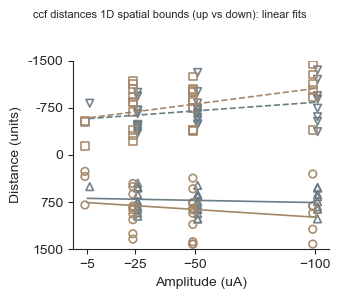

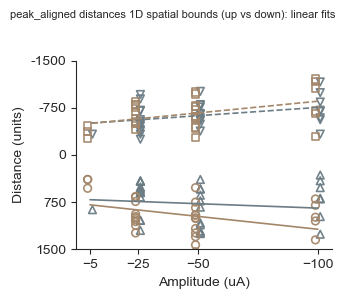

In [197]:
from scipy.stats import sem, linregress

# neutral, discernable colors and per-probe offsets/markers
probe_styles = {
    'probeB': {'color': '#6B7C85', 'marker_up': '^', 'marker_down': 'v', 'offset': -1},  # cool gray-blue
    'probeC': {'color': '#A4876A', 'marker_up': 'o', 'marker_down': 's', 'offset': +1},  # warm taupe
}

amps = [-5, -25, -50, -100]

for dist_type in ['ccf', 'peak_aligned']:
    fig, ax = plt.subplots(figsize=(3.5, 3))
    fig.suptitle(f'{dist_type} distances 1D spatial bounds (up vs down): linear fits', fontsize=8)

    ax.set_xlabel('Amplitude (uA)')
    ax.set_ylabel('Distance (units)')
    ax.invert_xaxis()

    for probe, style in probe_styles.items():
        color = style['color']
        marker_upper = style['marker_up']
        marker_lower = style['marker_down']
        offset = style['offset']

        all_upper_dists, all_lower_dists, all_amps = [], [], []

        for amp in amps:
            df = df_results[
                (df_results['max_volt'] > 40) &
                (df_results['amplitude'] == amp) &
                (df_results['polarity'] == polarity) &
                (df_results['probe'] == probe) &
                (df_results['half_max_lower_idx'] != -1) &
                (df_results['half_max_upper_idx'] != -1) &
                (df_results['lower_bound_idx'] != -1) &
                (df_results['upper_bound_idx'] != -1)
            ]

            if dist_type == 'ccf':
                upper_dists = df['upper_bound_dist'].to_numpy()
                lower_dists = df['lower_bound_dist'].to_numpy()
            else:
                normalized_distances = np.arange(-4000, 4000, 10)[::-1]
                upper_dists = normalized_distances[df['upper_bound_idx_aligned'].to_numpy()]
                lower_dists = normalized_distances[df['lower_bound_idx_aligned'].to_numpy()]

            all_upper_dists.extend(upper_dists.tolist())
            all_lower_dists.extend(lower_dists.tolist())
            all_amps.extend([amp] * len(upper_dists))

            if len(upper_dists) > 0 and len(lower_dists) > 0:
                mu_u, sd_u = float(np.mean(upper_dists)), float(np.std(upper_dists))
                mu_l, sd_l = float(np.mean(lower_dists)), float(np.std(lower_dists))
                print(f'{probe} {dist_type} {amp}uA: upper mean {mu_u:.2f} ± {sd_u:.2f}; lower mean {mu_l:.2f} ± {sd_l:.2f}')

            amp_offset = amp + offset
            # open-face markers: facecolors='none', edgecolors=color
            ax.scatter(
                np.full(len(upper_dists), amp_offset), upper_dists,
                s=30, alpha=0.95, marker=marker_upper,
                facecolors='none', edgecolors=color, linewidths=1.2
            )
            ax.scatter(
                np.full(len(lower_dists), amp_offset), lower_dists,
                s=30, alpha=0.95, marker=marker_lower,
                facecolors='none', edgecolors=color, linewidths=1.2
            )

        # linear regression fits (per probe)
        if len(np.unique(all_amps)) >= 2:
            x = np.asarray(all_amps, float)
            y_upper = np.asarray(all_upper_dists, float)
            y_lower = np.asarray(all_lower_dists, float)

            slope_u, intercept_u, r_u, p_u, stderr_u = linregress(x, y_upper)
            slope_l, intercept_l, r_l, p_l, stderr_l = linregress(x, y_lower)
            r2_u, r2_l = r_u**2, r_l**2
            # print r^2 summaries
            print(f"[R^2] {probe} {dist_type} upper:  R^2={r2_u:.3f}, slope={slope_u:.3f}, p={p_u:.3g}, n={len(y_upper)}")
            print(f"[R^2] {probe} {dist_type} lower:  R^2={r2_l:.3f}, slope={slope_l:.3f}, p={p_l:.3g}, n={len(y_lower)}")
            xx = np.linspace(np.min(x), np.max(x), 100)
            ax.plot(xx, slope_u * xx + intercept_u,
                    color=color, linestyle='-', linewidth=1.2)

                    #label=f'{probe} upper (R²={r2_u:.2f})')
            ax.plot(xx, slope_l * xx + intercept_l,
                    color=color, linestyle='--', linewidth=1.2)
                    #label=f'{probe} lower (R²={r2_l:.2f})')

    ax.set_xticks(amps)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_ylim([-1500, 1500])
    ax.set_yticks([-1500, -750, 0, 750, 1500], [1500, 750, 0, -750, -1500])
    ax.legend(frameon=False, fontsize=7, loc='best')
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    #plt.savefig(os.path.join(path, f'distances_{dist_type}_with_linearfits_probeBprobeC.png'))
    #plt.savefig(os.path.join(path, f'distances_{dist_type}_with_linearfits_probeBprobeC.pdf'))

In [110]:
# statsmodels is needed here
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.anova import anova_lm

# ------- helpers to gather data into long form -------

def _gather_long(df_results, amps, polarity, dist_type):
    # build a long df with columns: distance, amplitude, extent, probe, dist_type
    rows = []
    for probe in ['probeB', 'probeC']:
        for amp in amps:
            df = df_results[
                (df_results['max_volt'] > 40) &
                (df_results['amplitude'] == amp) &
                (df_results['polarity'] == polarity) &
                (df_results['probe'] == probe) &
                (df_results['half_max_lower_idx'] != -1) &
                (df_results['half_max_upper_idx'] != -1) &
                (df_results['lower_bound_idx'] != -1) &
                (df_results['upper_bound_idx'] != -1)
            ]

            if dist_type == 'ccf':
                up = df['upper_bound_dist'].to_numpy()
                down = df['lower_bound_dist'].to_numpy()
            else:
                # peak-aligned distances are indexed into a normalized axis
                normalized_distances = np.arange(-4000, 4000, 10)[::-1]
                up = normalized_distances[df['upper_bound_idx_aligned'].to_numpy()]
                down = normalized_distances[df['lower_bound_idx_aligned'].to_numpy()]

            # append both extents
            for d in up:
                rows.append({'distance': float(d), 'amplitude': float(amp),
                             'extent': 'up', 'probe': probe, 'dist_type': dist_type})
            for d in down:
                rows.append({'distance': float(d), 'amplitude': float(amp),
                             'extent': 'down', 'probe': probe, 'dist_type': dist_type})
    return pd.DataFrame(rows)


def _add_partial_eta2(aov):
    # compute partial eta-squared for each effect: ss_effect / (ss_effect + ss_resid)
    if 'Residual' not in aov.index:
        return aov
    ss_res = aov.loc['Residual', 'sum_sq']
    eta = {}
    for term in aov.index:
        if term == 'Residual':
            eta[term] = np.nan
        else:
            ss_eff = aov.loc[term, 'sum_sq']
            eta[term] = ss_eff / (ss_eff + ss_res) if (ss_eff + ss_res) > 0 else np.nan
    aov['partial_eta2'] = pd.Series(eta)
    return aov


# ------- run anova for each distance type -------

results = {}
for dist_type in ['ccf', 'peak_aligned']:
    df_lm = _gather_long(df_results, amps=amps, polarity=polarity, dist_type=dist_type)

    # ensure categorical encodings for factors
    df_lm['extent'] = df_lm['extent'].astype('category')
    df_lm['probe'] = df_lm['probe'].astype('category')

    # model: distance ~ amplitude (linear) + extent + probe + 2-way interactions
    # keep it linear and interpretable; you can add extent:probe:amplitude if you care
    formula = 'distance ~ amplitude + extent + probe + amplitude:extent + amplitude:probe + extent:probe'
    model = smf.ols(formula, data=df_lm).fit()

    # type-II anova controls for other terms without order dependence
    aov = anova_lm(model, typ=2)
    aov = _add_partial_eta2(aov)
    results[dist_type] = (model, aov)

    print(f'\n==== {dist_type} anova (type II) ====')
    print(aov.round(4))
    print('\nmodel summary (truncated):')
    print(model.summary().tables[1])  # coef table

# ------- optional: mixed effects if repeated measures per recording -------
# if distances include repeated observations per recording, a random intercept can be more appropriate.
# uncomment and run if you want that analysis.
#
# import statsmodels.formula.api as smf
# for dist_type in ['ccf', 'peak_aligned']:
#     df_lm = _gather_long(df_results, amps=amps, polarity=polarity, dist_type=dist_type)
#     df_lm['extent'] = df_lm['extent'].astype('category')
#     df_lm['probe'] = df_lm['probe'].astype('category')
#     # requires df_results to have a 'recording' column; otherwise skip
#     if 'recording' in df_results.columns:
#         md = smf.mixedlm("distance ~ amplitude + extent + probe",
#                          df_lm, groups=df_lm["recording"])
#         mfit = md.fit(method='lbfgs')
#         print(f'\n==== {dist_type} mixedlm (random intercept by recording) ====')
#         print(mfit.summary())



==== ccf anova (type II) ====
                        sum_sq     df         F  PR(>F)  partial_eta2
extent            7.470044e+07    1.0  962.4376  0.0000        0.8900
probe             1.002703e+04    1.0    0.1292  0.7199        0.0011
extent:probe      5.016859e+05    1.0    6.4637  0.0123        0.0515
amplitude         1.436062e+05    1.0    1.8502  0.1763        0.0153
amplitude:extent  8.033699e+05    1.0   10.3506  0.0017        0.0800
amplitude:probe   1.557349e+03    1.0    0.0201  0.8876        0.0002
Residual          9.236290e+06  119.0       NaN     NaN           NaN

model summary (truncated):
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
Intercept                      513.8471     88.256      5.822      0.000     339.091     688.603
extent[T.up]                 -1151.3482    110.440    -10.425      0.000   -1370.031    -9

## center of mass shift calculations (analagous to the one free center shift i did before but just using shift from stim site to center of mass of EP)

In [ ]:
# build center-of-mass vs. stim-center dataframe for all conditions/recordings
# expects: recordings_dict, points_dict, stim_points in memory

def build_com_shift_df(recordings_dict, points_dict, stim_points):
    # helper: safe array -> float
    def _as_float(a):
        a = np.asarray(a, dtype=float)
        return a

    rows = []
    missing = []
    for condition, rec_list in recordings_dict.items():
        # sanity: points_dict must have same number of per-recording arrays as recs listed
        pts_list = points_dict.get(condition, None)
        if pts_list is None:
            missing.append(f"no points for condition {condition}")
            continue
        if len(pts_list) != len(rec_list):
            missing.append(f"length mismatch for {condition}: {len(pts_list)} point-sets vs {len(rec_list)} recs")
        # iterate over whichever is shorter to avoid index errors
        for i, rec in enumerate(rec_list[:len(pts_list)]):
            pts = _as_float(pts_list[i])  # shape (6,3)
            if pts.ndim != 2 or pts.shape[1] != 3:
                missing.append(f"bad shape for {rec}_{condition}: {pts.shape}")
                continue
            # center of mass (mean of the six points)
            com = pts.mean(axis=0)  # [ap, ml, dv]

            # stim center lookup
            stim_key = f"{rec}_{condition}"
            stim = stim_points.get(stim_key, None)
            if stim is None:
                missing.append(f"missing stim_points[{stim_key}]")
                continue
            stim = _as_float(stim)

            # vector from stim center to COM (com - stim)
            delta = com - stim
            delta_mag = float(np.linalg.norm(delta))

            rows.append({
                'rec': rec,
                'condition': condition,
                # stim center (x->ap, y->ml, z->dv)
                'stim_ap': float(stim[0]),
                'stim_ml': float(stim[1]),
                'stim_dv': float(stim[2]),
                # center of mass of the 6 points
                'com_ap': float(com[0]),
                'com_ml': float(com[1]),
                'com_dv': float(com[2]),
                # shift vector components (COM minus stim)
                'delta_ap': float(delta[0]),
                'delta_ml': float(delta[1]),
                'delta_dv': float(delta[2]),
                'delta_mag': delta_mag,
                'n_points': int(pts.shape[0]),
            })

    df = pd.DataFrame(rows, columns=[
        'rec','condition',
        'stim_ap','stim_ml','stim_dv',
        'com_ap','com_ml','com_dv',
        'delta_ap','delta_ml','delta_dv','delta_mag',
        'n_points'
    ])

    return df

com_shift_df = build_com_shift_df(recordings_dict, points_dict, stim_points)
com_shift_df.head()

# add unit vector columns (direction only)
d = com_shift_df[['delta_ap','delta_ml','delta_dv']].to_numpy()
n = np.linalg.norm(d, axis=1, keepdims=True)
n[n == 0] = 1.0  # avoid div by zero
unit = d / n
com_shift_df[['delta_ap_unit','delta_ml_unit','delta_dv_unit']] = unit



In [155]:
com_shift_df.head()

,rec,condition,stim_ap,stim_ml,stim_dv,com_ap,com_ml,com_dv,delta_ap,delta_ml,delta_dv,delta_mag,n_points,delta_ap_unit,delta_ml_unit,delta_dv_unit
0,jlh31,bipolar_-25,8428.0,3303.0,1288.0,8462.166667,3369.000000,1227.000000,34.166667,66.000000,-61.000000,96.147601,6,0.355356,0.686445,-0.634441
1,jlh32,bipolar_-25,7840.0,3404.0,1380.0,7805.000000,3413.333333,1040.000000,-35.000000,9.333333,-340.000000,341.924131,6,-0.102362,0.027297,-0.994373
2,jlh34,bipolar_-25,8428.0,3303.0,1100.0,8335.166667,3196.666667,1084.000000,-92.833333,-106.333333,-16.000000,142.059162,6,-0.653484,-0.748514,-0.112629
3,jlh48,bipolar_-25,8508.0,3176.0,1234.0,8260.500000,3162.833333,1239.166667,-247.500000,-13.166667,5.166667,247.903823,6,-0.998371,-0.053112,0.020841
4,jlh31,bipolar_-50,8428.0,3303.0,1288.0,8387.333333,3367.333333,1156.166667,-40.666667,64.333333,-131.833333,152.225436,6,-0.267148,0.422619,-0.866040


In [172]:
com_shift_df.condition.unique()

array(['bipolar_-25', 'bipolar_-50', 'bipolar_-100', 'bipolar_25',
       'bipolar_50', 'bipolar_100', 'monopolar_-25', 'monopolar_-50',
       'monopolar_-100', 'monopolar_5', 'monopolar_25', 'monopolar_50',
       'monopolar_100'], dtype=object)

In [180]:
from brainglobe_atlasapi import BrainGlobeAtlas

bg_atlas = BrainGlobeAtlas("allen_mouse_10um", check_latest=False)

mask_VISp = bg_atlas.get_structure_mask('VISp')
mask_cc = bg_atlas.get_structure_mask('cc')
mask_root = bg_atlas.get_structure_mask('root') # root mask is important for brain shape

# The mask images have pixel values equal to the ID of the parent area, so we change these for
# plotting purposes. 
mask_root[mask_root>0]=1
mask_VISp[mask_VISp>0]=2
mask_VISp_root = mask_VISp + mask_root

mask_cc[mask_cc>0]=2
mask_cc_root = mask_cc + mask_root

In [181]:
mask_cc.shape

(1320, 800, 1140)

In [ ]:
mask_cc.shape

(1320, 800, 1140)

In [178]:
stim_aps = com_shift_df['stim_ap'].unique() 
stim_mls = com_shift_df['stim_ml'].unique()
stim_dvs = com_shift_df['stim_dv'].unique() 

stim_ccf_avg = np.array([stim_aps.mean(), stim_mls.mean(), stim_dvs.mean()])

In [179]:
stim_ccf_avg

array([8258.66666667, 3294.33333333, 1250.5       ])

In [184]:
from scipy.spatial import cKDTree

def cc_shift_from_stim(mask_cc, stim_ccf_um, voxel_um=10.0):
    """
    find nearest cc voxel to stim point and return vector shift.
    returns:
      delta_um: np.array([Δap, Δml, Δdv]) = cc_point - stim
      delta_mag_um: float distance (µm)
      cc_point_um: np.array([ap, ml, dv]) nearest cc voxel in µm
    """
    cc = (mask_cc > 0)
    coords_vox = np.argwhere(cc)
    if coords_vox.size == 0:
        raise ValueError("no cc voxels found (mask_cc > 0 is empty).")

    stim_vox = np.asarray(stim_ccf_um, float) / float(voxel_um)
    tree = cKDTree(coords_vox.astype(float))
    dist_vox, idx = tree.query(stim_vox)
    nearest_vox = coords_vox[idx]
    cc_point_um = nearest_vox.astype(float) * float(voxel_um)

    delta_um = cc_point_um - np.asarray(stim_ccf_um, float)
    delta_mag_um = np.linalg.norm(delta_um)
    return delta_um, delta_mag_um, cc_point_um


delta_cc_um, delta_cc_mag_um, cc_near_um = cc_shift_from_stim(mask_cc, stim_ccf_avg, voxel_um=10.0)

print("nearest cc voxel (µm):", cc_near_um)
print("delta shift (µm):", delta_cc_um)
print("distance to cc (µm):", delta_cc_mag_um)

nearest cc voxel (µm): [8290. 3370. 1480.]
delta shift (µm): [ 31.33333333  75.66666667 229.5       ]
distance to cc (µm): 243.6749314609891


In [187]:
# needs: scipy installed; mask_cc is a 3d array (ap, ml, dv) with cc voxels > 0

def attach_cc_nearest_per_recording(com_shift_df, mask_cc, voxel_um=10.0):
    # guard
    if com_shift_df.empty:
        raise ValueError("com_shift_df is empty")

    # 1) get one stim point per recording (mean across condition rows; should be identical anyway)
    stim_by_rec = (
        com_shift_df.groupby('rec')[['stim_ap','stim_ml','stim_dv']].mean().reset_index()
    )

    # 2) build kd-tree of cc voxels in µm
    cc = (mask_cc > 0)
    coords_vox = np.argwhere(cc)
    if coords_vox.size == 0:
        raise ValueError("no cc voxels found (mask_cc > 0 is empty).")
    coords_um = coords_vox.astype(float) * float(voxel_um)

    # local import (needed)
    from scipy.spatial import cKDTree
    tree = cKDTree(coords_um)

    # 3) query nearest cc point for each recording
    cc_records = []
    for _, r in stim_by_rec.iterrows():
        rec = r['rec']
        stim_um = r[['stim_ap','stim_ml','stim_dv']].to_numpy(dtype=float)
        dist_um, idx = tree.query(stim_um)
        cc_pt_um = coords_um[idx]
        cc_records.append({
            'rec': rec,
            'cc_ap': cc_pt_um[0],
            'cc_ml': cc_pt_um[1],
            'cc_dv': cc_pt_um[2],
            'cc_dist_to_stim_um': float(dist_um)
        })

    cc_ref_rec = pd.DataFrame(cc_records)

    # 4) merge onto all rows for that recording
    merged = com_shift_df.merge(cc_ref_rec, on='rec', how='left')

    # 5) add deltas (vector = cc - target)
    for src, pre in [('stim','cc_minus_stim'), ('com','cc_minus_com')]:
        dx = merged['cc_ap'] - merged[f'{src}_ap']
        dy = merged['cc_ml'] - merged[f'{src}_ml']
        dz = merged['cc_dv'] - merged[f'{src}_dv']
        merged[f'{pre}_ap'] = dx
        merged[f'{pre}_ml'] = dy
        merged[f'{pre}_dv'] = dz
        merged[f'{pre}_mag'] = np.sqrt(dx*dx + dy*dy + dz*dz)

    return merged, cc_ref_rec

# usage
cc_merged_df, cc_ref_by_rec = attach_cc_nearest_per_recording(com_shift_df, mask_cc, voxel_um=10.0)
print(cc_ref_by_rec)
cc_merged_df.head()


     rec   cc_ap   cc_ml   cc_dv  cc_dist_to_stim_um
0  jlh31  8440.0  3380.0  1450.0          179.769297
1  jlh32  7930.0  3450.0  1580.0          224.089268
2  jlh34  8460.0  3400.0  1440.0          355.011267
3  jlh48  8520.0  3290.0  1480.0          271.396389


,rec,condition,stim_ap,stim_ml,stim_dv,com_ap,com_ml,com_dv,delta_ap,delta_ml,...,cc_dv,cc_dist_to_stim_um,cc_minus_stim_ap,cc_minus_stim_ml,cc_minus_stim_dv,cc_minus_stim_mag,cc_minus_com_ap,cc_minus_com_ml,cc_minus_com_dv,cc_minus_com_mag
0,jlh31,bipolar_-25,8428.0,3303.0,1288.0,8462.166667,3369.000000,1227.000000,34.166667,66.000000,...,1450.0,179.769297,12.0,77.0,162.0,179.769297,-22.166667,11.000000,223.000000,224.368806
1,jlh32,bipolar_-25,7840.0,3404.0,1380.0,7805.000000,3413.333333,1040.000000,-35.000000,9.333333,...,1580.0,224.089268,90.0,46.0,200.0,224.089268,125.000000,36.666667,540.000000,555.490274
2,jlh34,bipolar_-25,8428.0,3303.0,1100.0,8335.166667,3196.666667,1084.000000,-92.833333,-106.333333,...,1440.0,355.011267,32.0,97.0,340.0,355.011267,124.833333,203.333333,356.000000,428.560154
3,jlh48,bipolar_-25,8508.0,3176.0,1234.0,8260.500000,3162.833333,1239.166667,-247.500000,-13.166667,...,1480.0,271.396389,12.0,114.0,246.0,271.396389,259.500000,127.166667,240.833333,376.181214
4,jlh31,bipolar_-50,8428.0,3303.0,1288.0,8387.333333,3367.333333,1156.166667,-40.666667,64.333333,...,1450.0,179.769297,12.0,77.0,162.0,179.769297,52.666667,12.666667,293.833333,298.784621


INFO:fontTools.subset:maxp pruned
INFO:fontTools.subset:LTSH dropped
INFO:fontTools.subset:cmap pruned
INFO:fontTools.subset:kern dropped
INFO:fontTools.subset:post pruned
INFO:fontTools.subset:PCLT dropped
INFO:fontTools.subset:JSTF dropped
INFO:fontTools.subset:meta dropped
INFO:fontTools.subset:DSIG dropped
INFO:fontTools.subset:GPOS pruned
INFO:fontTools.subset:GSUB pruned
INFO:fontTools.subset:glyf pruned
INFO:fontTools.subset:Added gid0 to subset
INFO:fontTools.subset:Added first four glyphs to subset
INFO:fontTools.subset:Closing glyph list over 'GSUB': 28 glyphs before
INFO:fontTools.subset:Glyph names: ['.notdef', 'a', 'b', 'c', 'd', 'e', 'emdash', 'five', 'four', 'glyph00001', 'glyph00002', 'hyphen', 'i', 'l', 'm', 'minus', 'o', 'one', 'p', 'r', 's', 'space', 't', 'three', 'two', 'underscore', 'v', 'zero']
INFO:fontTools.subset:Glyph IDs:   [0, 1, 2, 3, 16, 19, 20, 21, 22, 23, 24, 66, 68, 69, 70, 71, 72, 76, 79, 80, 82, 83, 85, 86, 87, 89, 178, 237]
INFO:fontTools.subset:Clos

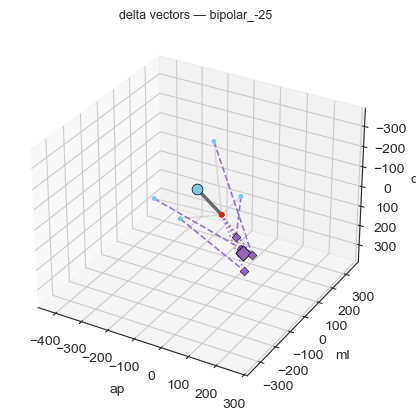

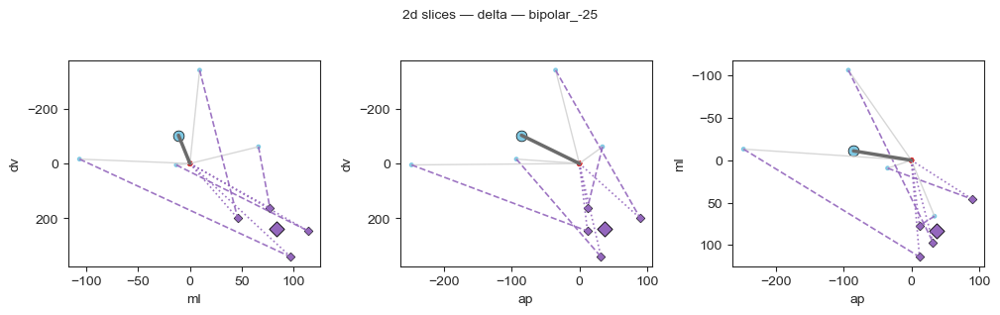

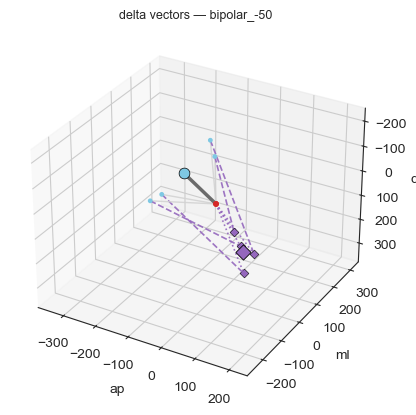

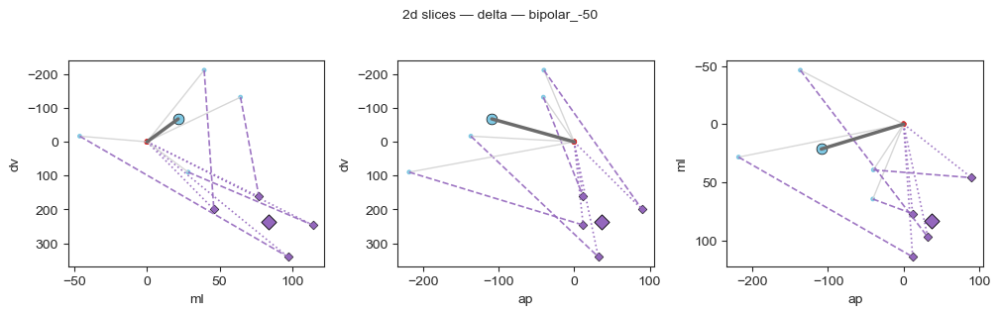

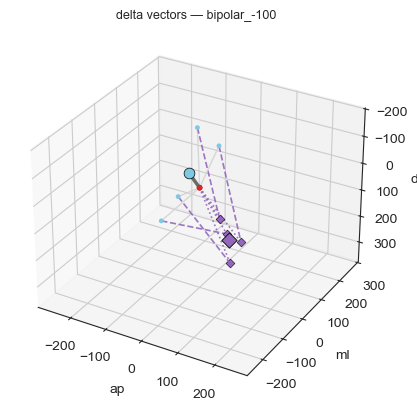

...

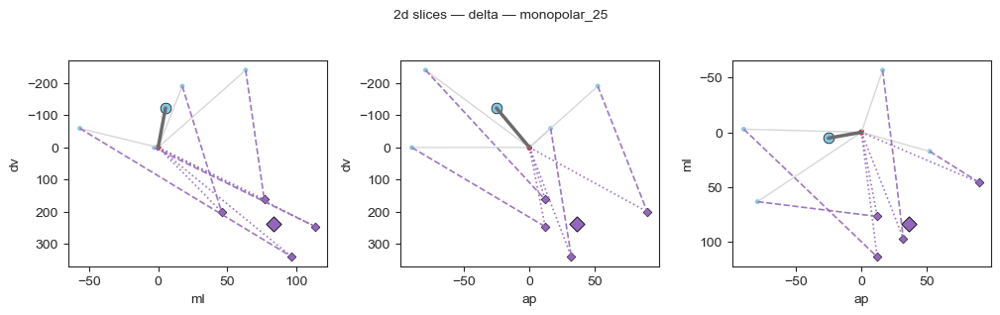

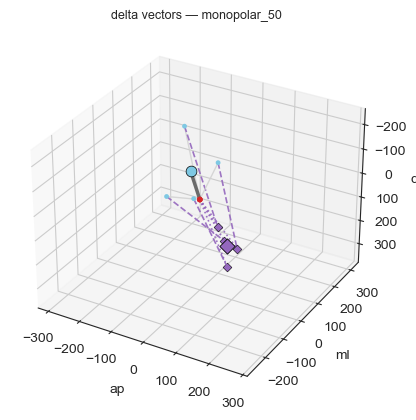

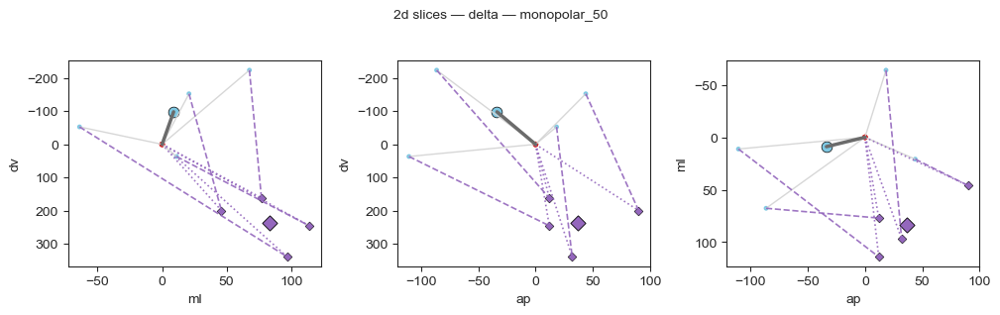

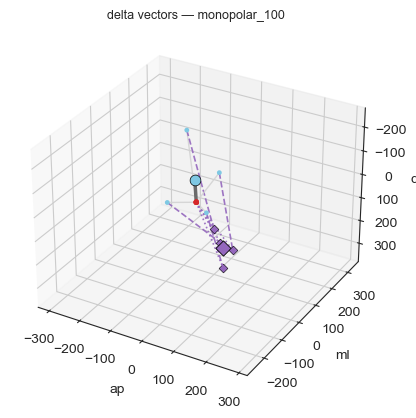

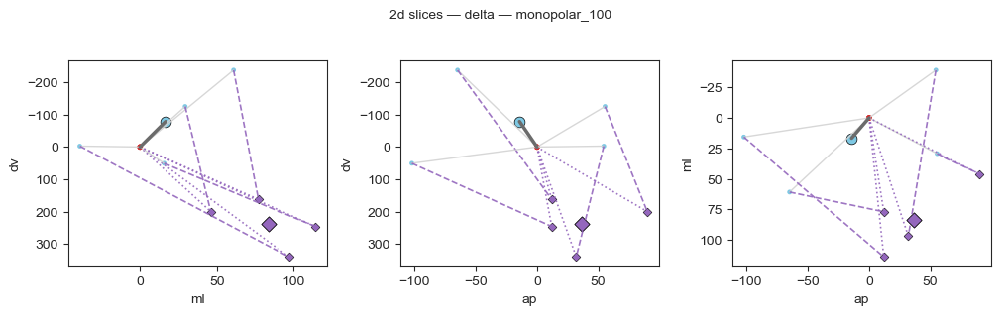

In [ ]:
# options
condition_of_interest = "monopolar_-25"
plot_mode = "delta"            # "delta" or "real"
show_cc = True                 # toggle CC overlay
show_com_to_cc = False          # dashed segment from COM to CC


# colors
c_vec = "#d3d3d3"    # stim->com lines
c_com = "#7ec8e3"    # com point
c_stim = "#d62728"   # stim point
c_cc = "#9467bd"     # cc point (purple-ish)
c_mean = "#6b6b6b"   # mean line

# sizes/linewidths
sz_com = 12 
sz_stim = 16 
sz_cc = 20 
sz_mean = 60
lw_vec = 1.0 
lw_mean = 2.5 
lw_cc = 1.2

def _get_condition_df(df, condition):
    dfx = df[df["condition"] == condition].copy()
    if dfx.empty:
        raise ValueError(f"no rows for condition: {condition}")
    return dfx

def _set_equal_3d(ax):
    xs = ax.get_xlim3d(); ys = ax.get_ylim3d(); zs = ax.get_zlim3d()
    xr = xs[1]-xs[0]; yr = ys[1]-ys[0]; zr = zs[1]-zs[0]
    r = max(xr, yr, zr) / 2.0
    cx = (xs[0]+xs[1])/2.0; cy = (ys[0]+ys[1])/2.0; cz = (zs[0]+zs[1])/2.0
    ax.set_xlim3d(cx-r, cx+r); ax.set_ylim3d(cy-r, cy+r); ax.set_zlim3d(cz-r, cz+r)

def _plot_3d_vectors_with_cc(dfx, mode):
    from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
    fig = plt.figure(figsize=(4.6, 4.2))
    ax = fig.add_subplot(111, projection="3d")
    ax.set_title(f"{mode} vectors — {condition_of_interest}", fontsize=9)
    ax.set_xlabel("ap"); ax.set_ylabel("ml"); ax.set_zlabel("dv")

    for _, r in dfx.iterrows():
        if mode == "delta":
            # stim at origin
            x0, y0, z0 = 0.0, 0.0, 0.0
            x1, y1, z1 = r["delta_ap"], r["delta_ml"], r["delta_dv"]
            ax.plot([x0, x1], [y0, y1], [z0, z1], lw=lw_vec, color=c_vec, alpha=0.9)
            ax.scatter([x0], [y0], [z0], s=sz_stim, color=c_stim, edgecolor="none", alpha=0.85)
            ax.scatter([x1], [y1], [z1], s=sz_com, color=c_com, edgecolor="none")

            if show_cc and {"cc_minus_stim_ap","cc_minus_stim_ml","cc_minus_stim_dv"}.issubset(dfx.columns):
                cx, cy, cz = r["cc_minus_stim_ap"], r["cc_minus_stim_ml"], r["cc_minus_stim_dv"]
                # stim->cc reference (thin dotted)
                ax.plot([x0, cx], [y0, cy], [z0, cz], lw=lw_cc, ls=":", color=c_cc, alpha=0.9)
                ax.scatter([cx], [cy], [cz], s=sz_cc, color=c_cc, marker="D", edgecolor="k", linewidth=0.4)
                if show_com_to_cc:
                    # com->cc dashed
                    ax.plot([x1, cx], [y1, cy], [z1, cz], lw=lw_cc, ls="--", color=c_cc, alpha=0.9)
        else:
            # real space
            xs, ys, zs = r["stim_ap"], r["stim_ml"], r["stim_dv"]
            xc, yc, zc = r["com_ap"],  r["com_ml"],  r["com_dv"]
            ax.plot([xs, xc], [ys, yc], [zs, zc], lw=lw_vec, color=c_vec, alpha=0.9)
            ax.scatter([xs], [ys], [zs], s=sz_stim, color=c_stim, edgecolor="none", alpha=0.85)
            ax.scatter([xc], [yc], [zc], s=sz_com, color=c_com, edgecolor="none")

            if show_cc and {"cc_ap","cc_ml","cc_dv"}.issubset(dfx.columns):
                xq, yq, zq = r["cc_ap"], r["cc_ml"], r["cc_dv"]
                # stim->cc reference (thin dotted)
                ax.plot([xs, xq], [ys, yq], [zs, zq], lw=lw_cc, ls=":", color=c_cc, alpha=0.9)
                ax.scatter([xq], [yq], [zq], s=sz_cc, color=c_cc, marker="D", edgecolor="k", linewidth=0.4)
                if show_com_to_cc:
                    ax.plot([xc, xq], [yc, yq], [zc, zq], lw=lw_cc, ls="--", color=c_cc, alpha=0.9)

    # mean overlays
    if mode == "delta":
        md = dfx[["delta_ap","delta_ml","delta_dv"]].mean().to_numpy()
        ax.plot([0, md[0]], [0, md[1]], [0, md[2]], lw=lw_mean, color=c_mean)
        ax.scatter([md[0]], [md[1]], [md[2]], s=sz_mean, color=c_com, edgecolor="k", linewidth=0.5)
        # mean cc (delta)
        if {"cc_minus_stim_ap","cc_minus_stim_ml","cc_minus_stim_dv"}.issubset(dfx.columns):
            mcc = dfx[["cc_minus_stim_ap","cc_minus_stim_ml","cc_minus_stim_dv"]].mean().to_numpy()
            ax.scatter([mcc[0]], [mcc[1]], [mcc[2]], s=sz_mean, color=c_cc, marker="D", edgecolor="k", linewidth=0.6)
    else:
        ms = dfx[["stim_ap","stim_ml","stim_dv"]].mean().to_numpy()
        mc = dfx[["com_ap","com_ml","com_dv"]].mean().to_numpy()
        ax.plot([ms[0], mc[0]], [ms[1], mc[1]], [ms[2], mc[2]], lw=lw_mean, color=c_mean)
        ax.scatter([mc[0]], [mc[1]], [mc[2]], s=sz_mean, color=c_com, edgecolor="k", linewidth=0.5)
        ax.scatter([ms[0]], [ms[1]], [ms[2]], s=sz_mean, color=c_stim, edgecolor="k", linewidth=0.5, alpha=0.9)
        if {"cc_ap","cc_ml","cc_dv"}.issubset(dfx.columns):
            mcc = dfx[["cc_ap","cc_ml","cc_dv"]].mean().to_numpy()
            # mean stim->mean cc dotted
            ax.plot([ms[0], mcc[0]], [ms[1], mcc[1]], [ms[2], mcc[2]], lw=lw_cc, ls=":", color=c_cc, alpha=0.9)
            ax.scatter([mcc[0]], [mcc[1]], [mcc[2]], s=sz_mean, color=c_cc, marker="D", edgecolor="k", linewidth=0.6)

    
    _set_equal_3d(ax)
    ax.invert_zaxis()
    plt.tight_layout()
    return fig, ax

def _plot_2d_slices_with_cc(dfx, mode):
    pairs = [("ml","dv"), ("ap","dv"), ("ap","ml")]
    fig, axs = plt.subplots(1, 3, figsize=(10.2, 3.2))
    fig.suptitle(f"2d slices — {mode} — {condition_of_interest}", fontsize=10)

    for ax, (ax1, ax2) in zip(axs, pairs):
        ax.set_xlabel(ax1); ax.set_ylabel(ax2)
        for _, r in dfx.iterrows():
            if mode == "delta":
                x0, y0 = 0.0, 0.0
                x1, y1 = r[f"delta_{ax1}"], r[f"delta_{ax2}"]
                ax.plot([x0, x1], [y0, y1], lw=lw_vec, color=c_vec, alpha=0.9)
                ax.scatter([x0], [y0], s=sz_stim, color=c_stim, edgecolor="none", alpha=0.85)
                ax.scatter([x1], [y1], s=sz_com, color=c_com, edgecolor="none")

                if show_cc and {f"cc_minus_stim_{ax1}", f"cc_minus_stim_{ax2}"}.issubset(dfx.columns):
                    cx, cy = r[f"cc_minus_stim_{ax1}"], r[f"cc_minus_stim_{ax2}"]
                    ax.plot([x0, cx], [y0, cy], lw=lw_cc, ls=":", color=c_cc, alpha=0.9)
                    ax.scatter([cx], [cy], s=sz_cc, color=c_cc, marker="D", edgecolor="k", linewidth=0.4)
                    if show_com_to_cc:
                        ax.plot([x1, cx], [y1, cy], lw=lw_cc, ls="--", color=c_cc, alpha=0.9)
            else:
                xs, ys = r[f"stim_{ax1}"], r[f"stim_{ax2}"]
                xc, yc = r[f"com_{ax1}"],  r[f"com_{ax2}"]
                ax.plot([xs, xc], [ys, yc], lw=lw_vec, color=c_vec, alpha=0.9)
                ax.scatter([xs], [ys], s=sz_stim, color=c_stim, edgecolor="none", alpha=0.85)
                ax.scatter([xc], [yc], s=sz_com, color=c_com, edgecolor="none")

                if show_cc and {f"cc_{ax1}", f"cc_{ax2}"}.issubset(dfx.columns):
                    xq, yq = r[f"cc_{ax1}"], r[f"cc_{ax2}"]
                    ax.plot([xs, xq], [ys, yq], lw=lw_cc, ls=":", color=c_cc, alpha=0.9)
                    ax.scatter([xq], [yq], s=sz_cc, color=c_cc, marker="D", edgecolor="k", linewidth=0.4)
                    if show_com_to_cc:
                        ax.plot([xc, xq], [yc, yq], lw=lw_cc, ls="--", color=c_cc, alpha=0.9)

        # mean overlays
        if mode == "delta":
            md1 = dfx[f"delta_{ax1}"].mean(); md2 = dfx[f"delta_{ax2}"].mean()
            ax.plot([0, md1], [0, md2], lw=lw_mean, color=c_mean)
            ax.scatter([md1], [md2], s=sz_mean, color=c_com, edgecolor="k", linewidth=0.5)
            if show_cc and {f"cc_minus_stim_{ax1}", f"cc_minus_stim_{ax2}"}.issubset(dfx.columns):
                mcc1 = dfx[f"cc_minus_stim_{ax1}"].mean(); mcc2 = dfx[f"cc_minus_stim_{ax2}"].mean()
                ax.scatter([mcc1], [mcc2], s=sz_mean, color=c_cc, marker="D", edgecolor="k", linewidth=0.6)
        else:
            ms1 = dfx[f"stim_{ax1}"].mean(); ms2 = dfx[f"stim_{ax2}"].mean()
            mc1 = dfx[f"com_{ax1}"].mean();  mc2 = dfx[f"com_{ax2}"].mean()
            ax.plot([ms1, mc1], [ms2, mc2], lw=lw_mean, color=c_mean)
            ax.scatter([mc1], [mc2], s=sz_mean, color=c_com, edgecolor="k", linewidth=0.5)
            if show_cc and {f"cc_{ax1}", f"cc_{ax2}"}.issubset(dfx.columns):
                mcc1 = dfx[f"cc_{ax1}"].mean(); mcc2 = dfx[f"cc_{ax2}"].mean()
                ax.plot([ms1, mcc1], [ms2, mcc2], lw=lw_cc, ls=":", color=c_cc, alpha=0.9)
                ax.scatter([mcc1], [mcc2], s=sz_mean, color=c_cc, marker="D", edgecolor="k", linewidth=0.6)

        
        ax.invert_yaxis()

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    return fig, axs

path = r"C:\Users\jordan\Documents\combined_figs\anisotropy\com_shift_analysis"
os.makedirs(os.path.join(path, 'figures'), exist_ok=True)
# drive it
for condition_of_interest in cc_merged_df.condition.unique():
    dfc = _get_condition_df(cc_merged_df, condition_of_interest)  # use the df with cc columns
    _plot_3d_vectors_with_cc(dfc, plot_mode)
    #plt.gcf().savefig(os.path.join(path, 'figures', f'com_shift_3d_{condition_of_interest}_{plot_mode}_with_cc_comcclines.png'))
    #plt.gcf().savefig(os.path.join(path, 'figures', f'com_shift_3d_{condition_of_interest}_{plot_mode}_with_cc_comcclines.pdf'))
    _plot_2d_slices_with_cc(dfc, plot_mode)
    #plt.gcf().savefig(os.path.join(path, 'figures', f'com_shift_2d_{condition_of_interest}_{plot_mode}_with_cc_comcclines.png'))
    #plt.gcf().savefig(os.path.join(path, 'figures', f'com_shift_2d_{condition_of_interest}_{plot_mode}_with_cc_comcclines.pdf'))


In [177]:
from scipy.stats import ttest_1samp, sem

def summarize_vector_stats(df, condition):
    """
    summarize directional shifts for a given condition
    averages across recordings first, then runs one-sample t-test vs 0
    """

    dfx = df[df['condition'] == condition].copy()
    if dfx.empty:
        raise ValueError(f"no rows found for condition '{condition}'")

    # average within recordings
    avg_by_rec = (
        dfx.groupby('rec')[['delta_ap','delta_ml','delta_dv','delta_mag']]
        .mean()
        .reset_index()
    )

    # compute stats across recordings
    stats = {}
    for k in ['delta_ap','delta_ml','delta_dv','delta_mag']:
        vals = avg_by_rec[k].to_numpy()
        mean_ = np.mean(vals)
        sem_  = sem(vals, nan_policy='omit')
        t,p   = ttest_1samp(vals, 0, nan_policy='omit')
        stats[k] = {'mean': mean_, 'sem': sem_, 't': t, 'p': p, 'n': len(vals)}

    # assemble tidy dataframe
    stats_df = pd.DataFrame(stats).T.reset_index().rename(columns={'index':'metric'})

    print(f"\n=== vector shift summary for {condition} ===")
    print(avg_by_rec)
    print("\n--- group stats (mean ± SEM, t vs 0) ---")
    print(stats_df.to_string(index=False, float_format=lambda x: f"{x: .4f}"))

    return avg_by_rec, stats_df

for condition in com_shift_df.condition.unique():
    avg_rec_df, stats_df = summarize_vector_stats(com_shift_df, condition)



=== vector shift summary for bipolar_-25 ===
     rec    delta_ap    delta_ml    delta_dv   delta_mag
0  jlh31   34.166667   66.000000  -61.000000   96.147601
1  jlh32  -35.000000    9.333333 -340.000000  341.924131
2  jlh34  -92.833333 -106.333333  -16.000000  142.059162
3  jlh48 -247.500000  -13.166667    5.166667  247.903823

--- group stats (mean ± SEM, t vs 0) ---
   metric      mean      sem       t       p       n
 delta_ap  -85.2917  59.9777 -1.4221  0.2501  4.0000
 delta_ml  -11.0417  35.8650 -0.3079  0.7783  4.0000
 delta_dv -102.9583  80.2091 -1.2836  0.2894  4.0000
delta_mag  207.0087  55.0630  3.7595  0.0329  4.0000

=== vector shift summary for bipolar_-50 ===
     rec    delta_ap   delta_ml    delta_dv   delta_mag
0  jlh31  -40.666667  64.333333 -131.833333  152.225436
1  jlh32  -40.000000  39.333333 -211.666667  218.974631
2  jlh34 -136.666667 -46.333333  -16.666667  145.266422
3  jlh48 -218.333333  28.333333   89.666667  237.723228

--- group stats (mean ± SEM, t vs 0

C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\95725289.py:25: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  sem_  = sem(vals, nan_policy='omit')
c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


## fitting spheres with fixed and floating centers

C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\271364231.py:34: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  r_fit = float(least_squares(resid_fixed_center, x0=r_L2, args=(d,)).x)


jlh48: bipolar_-25
  r_min=660.23, r_med=928.41, r_L2=935.38 (lsq=935.38)
  RMSE[min]=334.72, RMSE[med]=190.72, RMSE[L2]=190.59

jlh48: bipolar_-50
  r_min=707.40, r_med=906.82, r_L2=915.28 (lsq=915.28)
  RMSE[min]=257.16, RMSE[med]=151.61, RMSE[L2]=151.38

jlh48: bipolar_-100
  r_min=336.55, r_med=930.70, r_L2=909.47 (lsq=909.47)
  RMSE[min]=728.02, RMSE[med]=449.71, RMSE[L2]=449.21

jlh48: bipolar_25
  r_min=646.17, r_med=860.15, r_L2=878.94 (lsq=878.94)
  RMSE[min]=305.71, RMSE[med]=199.08, RMSE[L2]=198.19

jlh34: bipolar_50
  r_min=349.35, r_med=623.87, r_L2=626.10 (lsq=626.10)
  RMSE[min]=376.88, RMSE[med]=255.84, RMSE[L2]=255.83

jlh48: bipolar_100
  r_min=515.68, r_med=1010.68, r_L2=1037.55 (lsq=1037.55)
  RMSE[min]=630.13, RMSE[med]=354.16, RMSE[L2]=353.14

jlh48: monopolar_-25
  r_min=628.06, r_med=848.05, r_L2=865.07 (lsq=865.07)
  RMSE[min]=308.09, RMSE[med]=197.58, RMSE[L2]=196.84

jlh48: monopolar_-50
  r_min=682.52, r_med=930.70, r_L2=947.58 (lsq=947.58)
  RMSE[min]=326.9

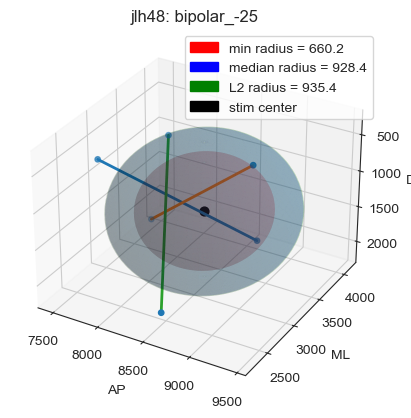

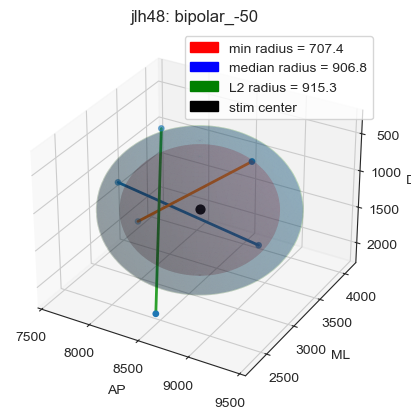

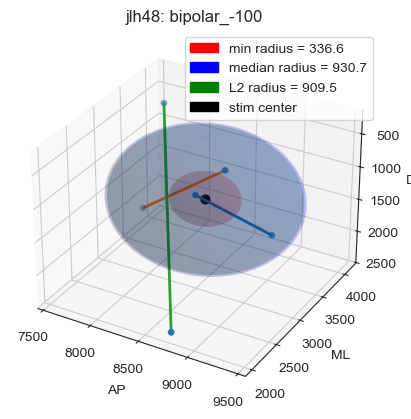

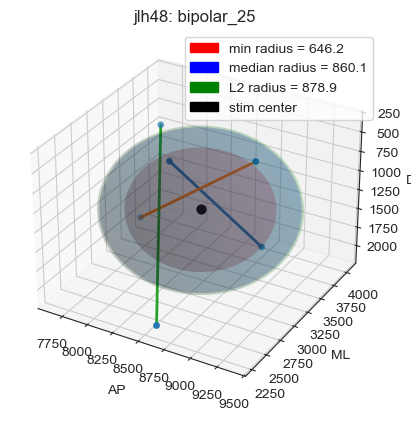

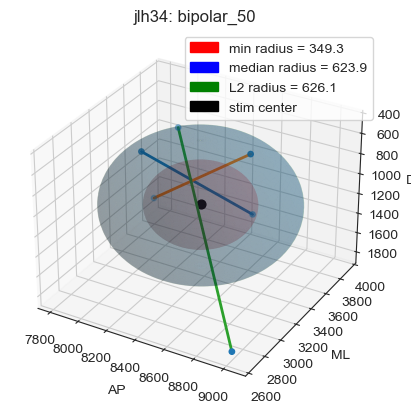

...

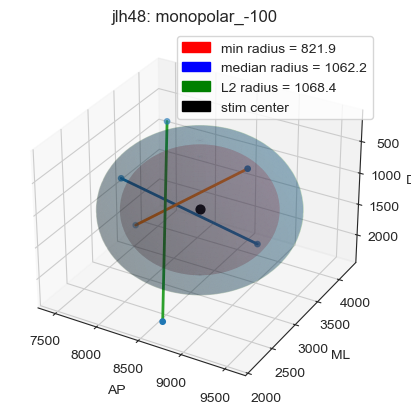

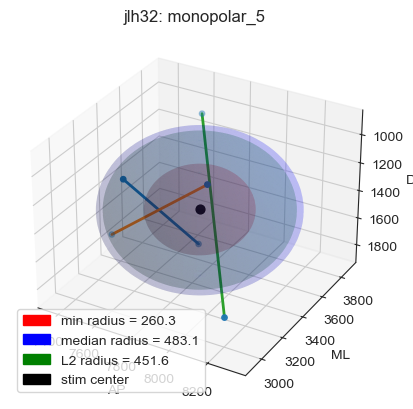

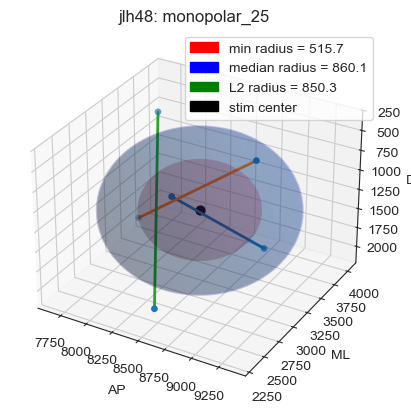

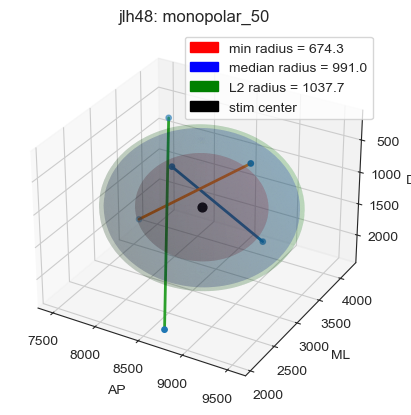

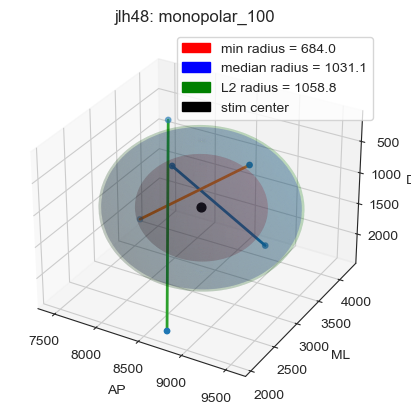

In [116]:
import numpy as np
from scipy.optimize import least_squares
import matplotlib.patches as mpatches

fit_dict = {}
for condition, data in points_dict.items():
  for i, points in enumerate(data):
    rec = recordings_dict[condition][i]
    title = f'{rec}: {condition}'
    
    #generate a center guess from the center of mass
    #center = center_of_mass_3d(points, np.ones(np.shape(points)[0]))
    center = stim_points[f'{rec}_{condition}'] # use the ccf coordinate of the stim contact

    # initial guess for parameters (center at origin, radius 1)
    initial_guess = [center[0], center[1], center[2], 500.] # 500 um
    measured_radii = []
    
    for p in points:
      r = np.linalg.norm(p - center)  # euclidean distance
      measured_radii.append(r)
    

#

  d = np.linalg.norm(points - center, axis=1)      # vectorized distances
  r_min = float(d.min())
  r_med = float(np.median(d))
  r_L2  = float(d.mean())                           # closed-form L2 solution

  # optional: solve via least_squares (same as mean)
  def resid_fixed_center(r, dists):
      return dists - r
  r_fit = float(least_squares(resid_fixed_center, x0=r_L2, args=(d,)).x)

  # sphere mesh (reuse for all radii)
  phi, theta = np.mgrid[0.0:np.pi:100j, 0.0:2.0*np.pi:100j]

  def sphere_xyz(r):
      x = r * np.sin(phi) * np.cos(theta) + center[0]
      y = r * np.sin(phi) * np.sin(theta) + center[1]
      z = r * np.cos(phi)                    + center[2]
      return x, y, z

  fig = plt.figure()
  ax = fig.add_subplot(projection='3d')

  # points and stim center
  ax.scatter(points[:,0], points[:,1], points[:,2], s=15)
  ax.scatter(center[0], center[1], center[2], color='k', s=40)

  # connect specified pairs
  pairs = [(0,1), (2,3), (4,5)]
  for i, j in pairs:
      if i < len(points) and j < len(points):  # guard
          ax.plot([points[i,0], points[j,0]],
                  [points[i,1], points[j,1]],
                  [points[i,2], points[j,2]], lw=2)

  # plot spheres: min (red), median (blue), L2 (green)
  for rr, c in [(r_min, 'r'), (r_med, 'b'), (r_L2, 'g')]:
      X, Y, Z = sphere_xyz(rr)
      ax.plot_surface(X, Y, Z, edgecolor='none', alpha=0.12, color=c)

  # legend proxies (plot_surface ignores label)
  legend_patches = [
      mpatches.Patch(color='r', label=f'min radius = {r_min:.1f}'),
      mpatches.Patch(color='b', label=f'median radius = {r_med:.1f}'),
      mpatches.Patch(color='g', label=f'L2 radius = {r_L2:.1f}'),
      mpatches.Patch(color='k', label='stim center'),
  ]
  ax.legend(handles=legend_patches, loc='best')

  # axes
  ax.set_xlabel('AP'); ax.set_ylabel('ML'); ax.set_zlabel('DV')
  ax.invert_zaxis()
  ax.set_title(title)

  
  # quick residual diagnostics
  def rmse(res): return float(np.sqrt(np.mean(res**2)))
  print(
      f"{title}\n"
      f"  r_min={r_min:.2f}, r_med={r_med:.2f}, r_L2={r_L2:.2f} (lsq={r_fit:.2f})\n"
      f"  RMSE[min]={rmse(d - r_min):.2f}, RMSE[med]={rmse(d - r_med):.2f}, RMSE[L2]={rmse(d - r_L2):.2f}\n"
  )



C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\3901063502.py:104: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


=== sphere anisotropy summary (first 10) ===
   condition   rec  n_points  r_L2_fixed  r_med_fixed      r_free     delta_x      delta_y     delta_z   delta_mag  delta_norm   dipole_a   dipole_bx   dipole_by   dipole_bz  dipole_bnorm  anisotropy_strength  cos_align  rmse_fixed  rmse_free
 bipolar_-25 jlh31         6  743.192380   617.214422  834.413682  236.564140   -11.829736  187.785825  302.268177    0.406716 809.911909  230.146267  -37.896450  184.986632    297.696992             0.367567   0.996068  213.340695  35.710015
 bipolar_-25 jlh32         6  665.432802   586.868762  825.647843  -13.726742   358.272672 -529.573922  639.528162    0.961071 710.939045  193.328143  633.830930 -451.926694    802.094231             1.128218   0.904081  452.318309  83.280735
 bipolar_-25 jlh34         6  712.286258   668.985760 1033.109443  -63.223038  -805.100905  -50.692459  809.168923    1.136016 718.046504   -2.070321 -768.937273   38.798837    769.918285             1.072240   0.990758  302.7

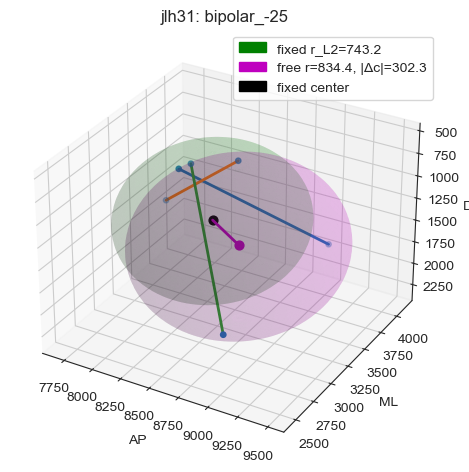

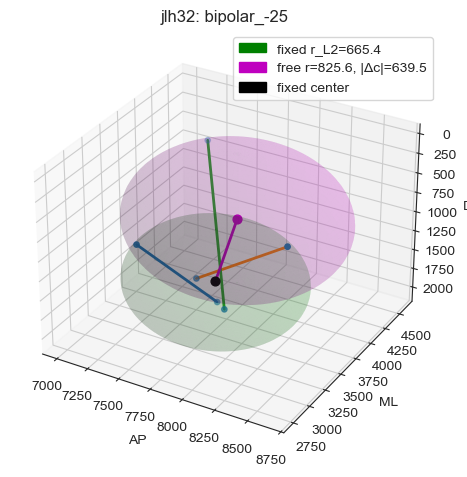

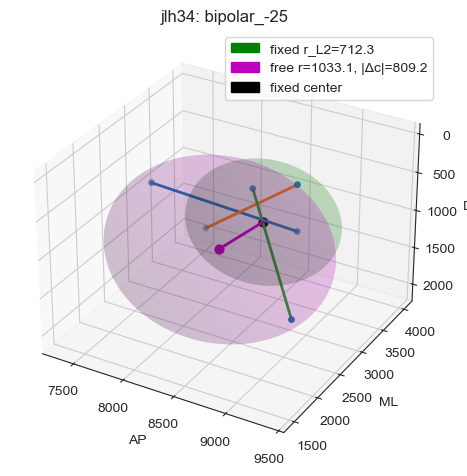

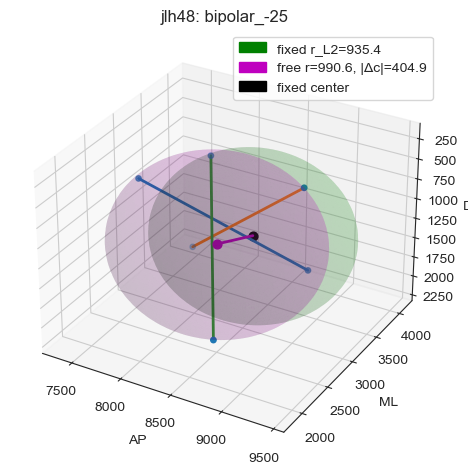

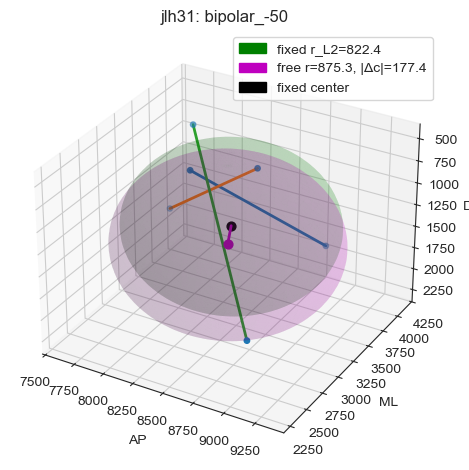

...

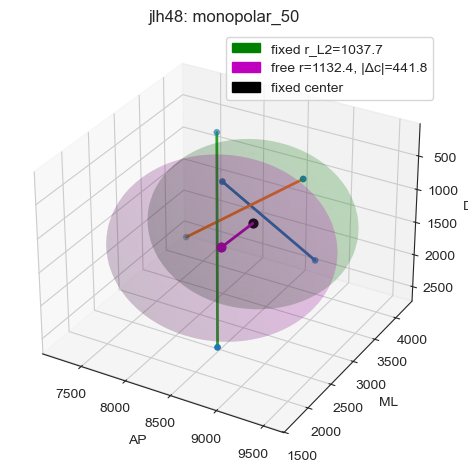

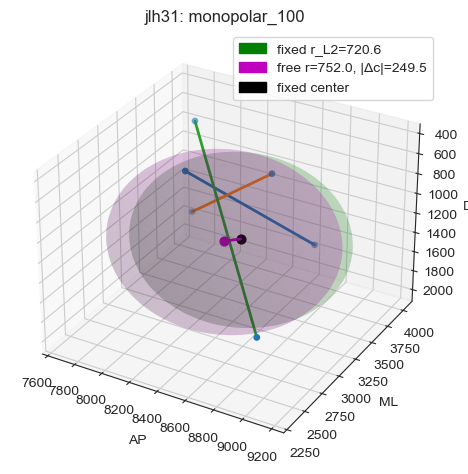

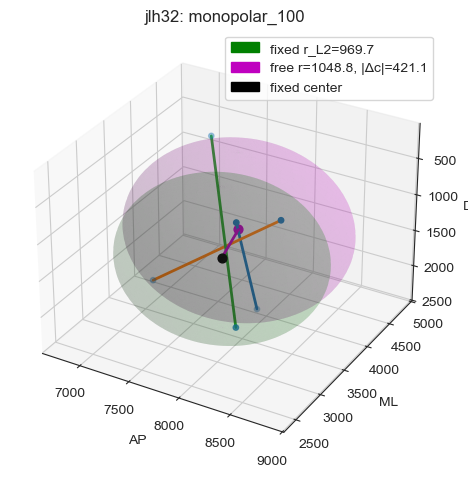

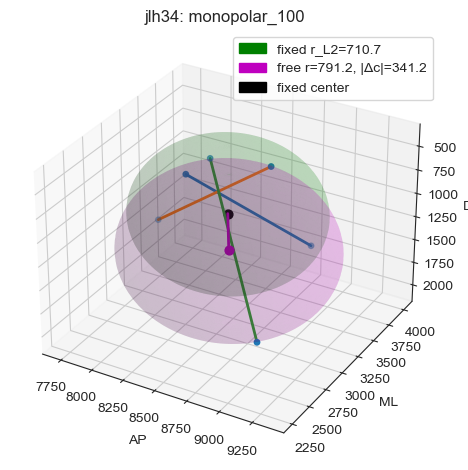

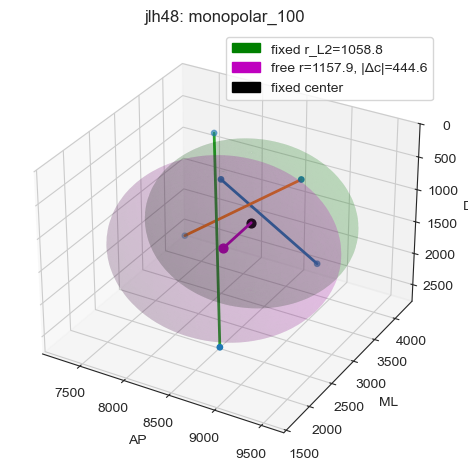

In [117]:
# --- sphere anisotropy analysis: fixed vs free center ---
import numpy as np
import pandas as pd
from scipy.optimize import least_squares
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# expects: points_dict[condition] -> list of (N,3) arrays
#          recordings[condition]  -> list of rec names aligned with points
#          stim_points[f"{rec}_{condition}"] -> (3,) center in (ap, ml, dv)

# residuals for full sphere
def sphere_residuals(params, points):
    # params = [x0, y0, z0, r]
    x0, y0, z0, r = params
    x, y, z = points[:,0], points[:,1], points[:,2]
    return np.sqrt((x - x0)**2 + (y - y0)**2 + (z - z0)**2) - r

# free-center fit with lsq
def fit_free_sphere(points, init_center, init_r):
    p0 = np.array([init_center[0], init_center[1], init_center[2], init_r], float)
    # keep radius positive
    lb = [-np.inf, -np.inf, -np.inf, 1e-6]
    ub = [ np.inf,  np.inf,  np.inf,  np.inf]
    res = least_squares(lambda p: sphere_residuals(p, points), p0, bounds=(lb, ub))
    c_free = res.x[:3]
    r_free = float(res.x[3])
    return c_free, r_free, res

# dipole regression on directions from fixed center: d_i ≈ a + b·u_i
def dipole_fit_dists(center_fixed, points):
    v = points - center_fixed
    d = np.linalg.norm(v, axis=1)
    u = v / np.clip(d[:,None], 1e-12, None)
    X = np.column_stack([np.ones(len(d)), u])
    coef, *_ = np.linalg.lstsq(X, d, rcond=None)
    a, b = coef[0], coef[1:]
    b_norm = float(np.linalg.norm(b))
    return float(a), b.astype(float), b_norm, d, u

# plotting helper: draw a sphere surface
def plot_sphere(ax, center, r, color, alpha=0.12):
    phi, theta = np.mgrid[0.0:np.pi:100j, 0.0:2.0*np.pi:100j]
    X = r * np.sin(phi) * np.cos(theta) + center[0]
    Y = r * np.sin(phi) * np.sin(theta) + center[1]
    Z = r * np.cos(phi)                    + center[2]
    ax.plot_surface(X, Y, Z, edgecolor='none', alpha=alpha, color=color)

# config: set to True to show per-recording plots
DO_PLOT = True
PAIR_LINES = [(0,1), (2,3), (4,5)]  # your (probeA, probeB) pairs

rows = []
for condition, data in points_dict.items():
    for i, pts in enumerate(data):
        rec = recordings_dict[condition][i]
        key = f'{rec}_{condition}'
        if key not in stim_points:
            print(f"warn: missing stim center for {key}, skipping")
            continue

        pts = np.asarray(pts, float)
        center_fixed = np.asarray(stim_points[key], float)

        # distances from fixed center
        d = np.linalg.norm(pts - center_fixed, axis=1)
        r_L2 = float(d.mean())  # least-squares radius with fixed center
        r_med = float(np.median(d))

        # free-center sphere
        c_free, r_free, res_free = fit_free_sphere(pts, center_fixed, r_L2)

        # center shift metrics
        delta_c = c_free - center_fixed
        delta_mag = float(np.linalg.norm(delta_c))
        delta_dir = delta_c / delta_mag if delta_mag > 0 else np.array([np.nan, np.nan, np.nan])

        # dipole anisotropy from fixed center
        a, b, b_norm, d_all, u_all = dipole_fit_dists(center_fixed, pts)
        anisotropy_strength = float(b_norm / a) if a != 0 else np.nan
        b_dir = b / b_norm if b_norm > 0 else np.array([np.nan, np.nan, np.nan])

        # alignment between center shift and dipole direction
        cos_align = float(np.dot(delta_dir, b_dir)) if np.all(np.isfinite(delta_dir)) and np.all(np.isfinite(b_dir)) else np.nan

        # residual diagnostics
        rmse_fixed = float(np.sqrt(np.mean((d - r_L2)**2)))
        rmse_free  = float(np.sqrt(np.mean(sphere_residuals(np.r_[c_free, r_free], pts)**2)))

        rows.append({
            "condition": condition, "rec": rec, "n_points": len(d),
            "r_L2_fixed": r_L2, "r_med_fixed": r_med, "r_free": r_free,
            "delta_x": delta_c[0], "delta_y": delta_c[1], "delta_z": delta_c[2],
            "delta_mag": delta_mag, "delta_norm": (delta_mag / r_L2) if r_L2 > 0 else np.nan,
            "dipole_a": a, "dipole_bx": b[0], "dipole_by": b[1], "dipole_bz": b[2],
            "dipole_bnorm": b_norm, "anisotropy_strength": anisotropy_strength,
            "cos_align": cos_align,
            "rmse_fixed": rmse_fixed, "rmse_free": rmse_free
        })

        # optional per-recording visualization
        if DO_PLOT:
            title = f"{rec}: {condition}"
            fig = plt.figure()
            ax = fig.add_subplot(projection='3d')

            # points and fixed/free centers
            ax.scatter(pts[:,0], pts[:,1], pts[:,2], s=15)
            ax.scatter(center_fixed[0], center_fixed[1], center_fixed[2], color='k', s=40)
            ax.scatter(c_free[0], c_free[1], c_free[2], color='m', s=40)

            # connect specified pairs
            for ii, jj in PAIR_LINES:
                if ii < len(pts) and jj < len(pts):
                    ax.plot([pts[ii,0], pts[jj,0]],
                            [pts[ii,1], pts[jj,1]],
                            [pts[ii,2], pts[jj,2]], lw=2)

            # spheres: fixed L2 (g), free (m)
            plot_sphere(ax, center_fixed, r_L2, color='g', alpha=0.12)
            plot_sphere(ax, c_free,      r_free, color='m', alpha=0.12)

            # center shift vector
            ax.plot([center_fixed[0], c_free[0]],
                    [center_fixed[1], c_free[1]],
                    [center_fixed[2], c_free[2]], color='m', lw=2)

            # legend proxies
            legend_patches = [
                mpatches.Patch(color='g', label=f'fixed r_L2={r_L2:.1f}'),
                mpatches.Patch(color='m', label=f'free r={r_free:.1f}, |Δc|={delta_mag:.1f}'),
                mpatches.Patch(color='k', label='fixed center'),
            ]
            ax.legend(handles=legend_patches, loc='best')

            # axes and labels
            ax.set_xlabel('AP'); ax.set_ylabel('ML'); ax.set_zlabel('DV')
            ax.invert_zaxis()
            ax.set_title(title)
            plt.tight_layout()

# aggregate results
asym_df = pd.DataFrame(rows)
print("=== sphere anisotropy summary (first 10) ===")
print(asym_df.head(10).to_string(index=False))

# quick suggestion: sort by normalized center shift
print("\nTop by Δc/r (anisotropy):")
print(asym_df.sort_values("delta_norm", ascending=False).head(10)[
    ["rec","condition","delta_norm","delta_mag","r_L2_fixed","rmse_fixed","rmse_free","cos_align","anisotropy_strength"]
].to_string(index=False))


In [36]:
print(np.mean(asym_df["anisotropy_strength"].dropna()))
print(np.std(asym_df["anisotropy_strength"].dropna()))

0.49300680950002745
0.2878974432091197


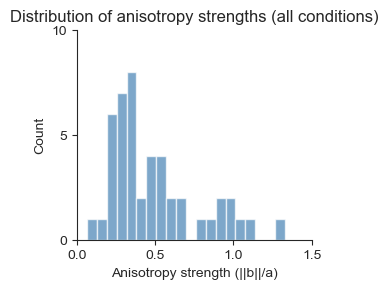

In [118]:
plt.figure(figsize=(3,3))
plt.hist(asym_df["anisotropy_strength"].dropna(), bins=20, alpha=0.7, color="steelblue")
plt.xlabel("Anisotropy strength (||b||/a)")
plt.ylabel("Count")
plt.title("Distribution of anisotropy strengths (all conditions)")
plt.tight_layout()
plt.ylim(0,10)
plt.yticks([0, 5, 10])
plt.xticks([0, 0.5, 1.0, 1.5])
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

save_path = r"C:\Users\jordan\Documents\combined_figs\anisotropy"
#plt.savefig(os.path.join(save_path, "anisotropy_strength_hist.pdf"))
#plt.savefig(os.path.join(save_path, "anisotropy_strength_hist.png"))


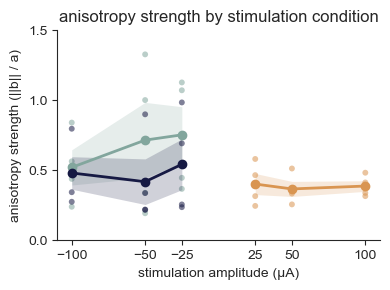

In [198]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# expects: asym_df with columns ["condition", "anisotropy_strength"]

# colors
COLORS = {
    "Bipolar (-25,-50,-100)": "#82A69D",  # bipolar
    "Monopolar (-25,-50,-100)": "#161943",  # cathodal (negative)
    "Monopolar (25,50,100)": "#D99551",  # anodal (positive)
}

# groups to plot
GROUPS = {
    "Bipolar (-25,-50,-100)": ["bipolar_-25","bipolar_-50","bipolar_-100"],
    "Monopolar (-25,-50,-100)": ["monopolar_-25","monopolar_-50","monopolar_-100"],
    "Monopolar (25,50,100)": ["monopolar_25","monopolar_50","monopolar_100"],
}

def _amp_from_cond(cond: str) -> int:
    # condition like "monopolar_-25" -> -25
    return int(cond.split("_")[-1])

plt.figure(figsize=(4,3))

for label, conds in GROUPS.items():
    # slice rows for this group and parse amplitude
    g = asym_df[asym_df["condition"].isin(conds)].copy()
    if g.empty:
        continue
    g["amp"] = g["condition"].apply(_amp_from_cond)

    # order: -25 -> -50 -> -100 (abs sort handles sign nicely)
    # and 25 -> 50 -> 100
    stats = (
        g.groupby("amp", as_index=False)["anisotropy_strength"]
         .agg(mean="mean", sem="sem")
         .sort_values("amp", key=lambda s: s.abs())
    )

    # numpy arrays for plotting
    x = stats["amp"].to_numpy(dtype=float)
    y = stats["mean"].to_numpy(dtype=float)
    se = stats["sem"].to_numpy(dtype=float)

    # mean line
    plt.plot(x, y, marker="o", lw=2, label=label, color=COLORS[label])
    # shaded sem band
    plt.fill_between(x, y - se, y + se, alpha=0.20, color=COLORS[label], linewidth=0)

    # individual points (no seaborn; simple scatter)
    # note: plotted at the true amplitude to avoid distorting x values
    plt.scatter(g["amp"], g["anisotropy_strength"], s=18, alpha=0.55,
                color=COLORS[label], edgecolors="none")

# axes/labels
plt.xlabel("stimulation amplitude (µA)")
plt.ylabel("anisotropy strength (||b|| / a)")
plt.title("anisotropy strength by stimulation condition")
plt.xticks([-100, -50, -25, 25, 50, 100])
plt.ylim(0, 1.5)
plt.yticks([0, 0.5, 1.0, 1.5])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
#plt.legend(frameon=False)
plt.tight_layout()

#plt.savefig(os.path.join(save_path, "anisotropy_strength_by_condition.pdf"))
#plt.savefig(os.path.join(save_path, "anisotropy_strength_by_condition.png"))


In [199]:
# two-way anova: anisotropy_strength ~ polarity * |amplitude|
# factors:
#   polarity: 'monopolar' vs 'bipolar'
#   amp_abs: categorical levels {25, 50, 100}
# uses: statsmodels

import statsmodels.api as sm
from statsmodels.formula.api import ols

# parse polarity and |amp| from condition
def _parse_pol_amp(cond: str):
    # "monopolar_-50" -> ('monopolar', 50)
    parts = cond.split('_')
    pol = parts[0]
    amp = int(parts[-1])
    return pol, abs(amp)

# build anova df
anova_df = asym_df.copy()
anova_df[['polarity','amp_abs']] = anova_df['condition'].apply(lambda c: pd.Series(_parse_pol_amp(c)))

# keep only amp_abs in {25,50,100} and valid polarities
anova_df = anova_df[anova_df['amp_abs'].isin([25,50,100]) & anova_df['polarity'].isin(['monopolar','bipolar'])].copy()
anova_df.dropna(subset=['anisotropy_strength'], inplace=True)

# cast amp_abs to categorical
anova_df['amp_abs'] = anova_df['amp_abs'].astype('category')
anova_df['polarity'] = anova_df['polarity'].astype('category')

# fit and anova (type II)
model = ols('anisotropy_strength ~ C(polarity) * C(amp_abs)', data=anova_df).fit()
aov = sm.stats.anova_lm(model, typ=2)

# add partial eta^2
ss_total = aov['sum_sq'].sum() + model.ssr  # conservative; or use np.var(y, ddof=1)* (n-1)
ss_resid = aov.loc['Residual','sum_sq']
aov['partial_eta2'] = aov['sum_sq'] / (aov['sum_sq'] + ss_resid)

print("\n=== two-way anova: anisotropy_strength ~ polarity * |amplitude| (type II) ===")
print(aov.to_string(float_format=lambda x: f"{x: .4f}"))

# optional: quick cell means for context
cell_means = (
    anova_df
    .groupby(['polarity','amp_abs'])['anisotropy_strength']
    .agg(['mean','sem','count'])
    .reset_index()
    .sort_values(['polarity','amp_abs'])
)
print("\n--- cell means (mean ± sem, n) ---")
for _, r in cell_means.iterrows():
    print(f"{r['polarity']:9s}  {int(r['amp_abs']):3d} µA :  {r['mean']:.3f} ± {r['sem']:.3f}  (n={int(r['count'])})")



=== two-way anova: anisotropy_strength ~ polarity * |amplitude| (type II) ===
                        sum_sq       df       F  PR(>F)  partial_eta2
C(polarity)             0.2367   1.0000  2.8109  0.1016        0.0672
C(amp_abs)              0.0241   2.0000  0.1430  0.8672        0.0073
C(polarity):C(amp_abs)  0.0702   2.0000  0.4170  0.6619        0.0209
Residual                3.2846  39.0000     NaN     NaN        0.5000

--- cell means (mean ± sem, n) ---
bipolar     25 µA :  0.584 ± 0.123  (n=8)
bipolar     50 µA :  0.648 ± 0.165  (n=7)
bipolar    100 µA :  0.502 ± 0.089  (n=6)
monopolar   25 µA :  0.472 ± 0.095  (n=8)
monopolar   50 µA :  0.393 ± 0.080  (n=8)
monopolar  100 µA :  0.435 ± 0.059  (n=8)


C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\3570182288.py:45: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['polarity','amp_abs'])['anisotropy_strength']


In [136]:
asym_df.head()

,condition,rec,n_points,r_L2_fixed,r_med_fixed,r_free,delta_x,delta_y,delta_z,delta_mag,delta_norm,dipole_a,dipole_bx,dipole_by,dipole_bz,dipole_bnorm,anisotropy_strength,cos_align,rmse_fixed,rmse_free
0,bipolar_-25,jlh31,6,743.192380,617.214422,834.413682,236.564140,-11.829736,187.785825,302.268177,0.406716,809.911909,230.146267,-37.896450,184.986632,297.696992,0.367567,0.996068,213.340695,35.710015
1,bipolar_-25,jlh32,6,665.432802,586.868762,825.647843,-13.726742,358.272672,-529.573922,639.528162,0.961071,710.939045,193.328143,633.830930,-451.926694,802.094231,1.128218,0.904081,452.318309,83.280735
2,bipolar_-25,jlh34,6,712.286258,668.985760,1033.109443,-63.223038,-805.100905,-50.692459,809.168923,1.136016,718.046504,-2.070321,-768.937273,38.798837,769.918285,1.072240,0.990758,302.723394,43.054558
3,bipolar_-25,jlh48,6,935.380303,928.411365,990.578028,-171.281636,-364.563868,-41.515325,404.929296,0.432903,927.031271,-158.760914,-380.325007,-39.243043,413.995357,0.446582,0.999021,190.592557,5.398023
4,bipolar_-50,jlh31,6,822.430691,782.185135,875.270124,48.420736,-140.166416,97.281209,177.355083,0.215647,861.674519,44.394790,-130.485918,93.865248,166.757779,0.193528,0.999843,160.619399,123.169181


In [146]:
asym_df[asym_df['condition'] == 'monopolar_-25']

,condition,rec,n_points,r_L2_fixed,r_med_fixed,r_free,delta_x,delta_y,delta_z,delta_mag,delta_norm,dipole_a,dipole_bx,dipole_by,dipole_bz,dipole_bnorm,anisotropy_strength,cos_align,rmse_fixed,rmse_free
21,monopolar_-25,jlh31,6,587.656992,556.106169,595.168526,-51.979512,-126.996336,-65.771468,152.170382,0.258944,577.209386,-39.785544,-111.129865,-69.145775,136.798664,0.237000,0.995784,122.046137,102.102790
22,monopolar_-25,jlh32,6,725.996224,692.129232,816.484731,-70.337110,241.277780,-432.168310,499.931720,0.688615,747.796361,-28.479378,307.444881,-415.986863,518.052603,0.692772,0.988294,360.521126,10.727648
23,monopolar_-25,jlh34,6,552.513329,487.281304,783.246951,71.895252,-564.636352,111.758621,580.063037,1.049863,571.620785,71.269782,-544.595549,124.754100,563.229331,0.985320,0.999560,270.877626,75.954506
24,monopolar_-25,jlh48,6,865.068552,848.052058,884.059012,-197.600727,-122.962396,91.327514,250.013025,0.289009,858.060934,-186.822959,-84.562779,79.195494,219.830862,0.256195,0.992477,196.842745,150.198943


### center shift metric from free center stuff

=== anisotropy summary for condition: monopolar_-100 ===
n recordings: 4
unweighted mean direction (unit): [-0.13653949 -0.84994707  0.5088683 ], resultant=0.410
weighted by |Δc| mean dir (unit): [-0.34049611 -0.47666865  0.81046246], resultant=0.193
weighted by Δc/r mean dir (unit): [-0.28255377 -0.30336585  0.91001787], resultant=0.183
mean raw Δc (µm): [-28.22476921 -39.51252953  67.18172413] ± [ 32.17563895 233.80451594 104.82511872]  |Δc|=82.9
mean normalized Δc/r: [-0.02563338 -0.02752146  0.08255717] ± [0.03158053 0.26952834 0.13022006]  ||=0.091


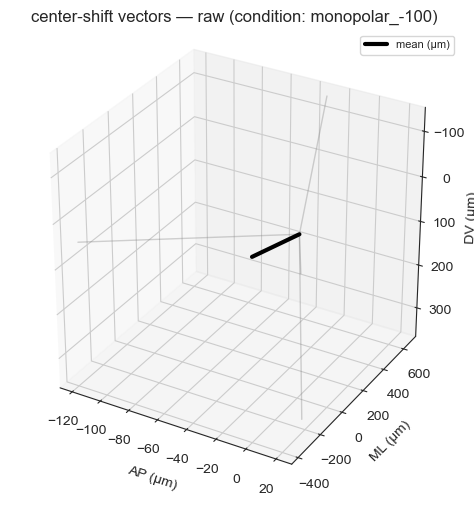

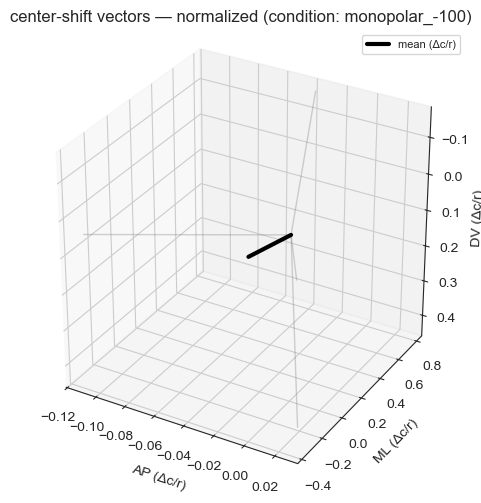

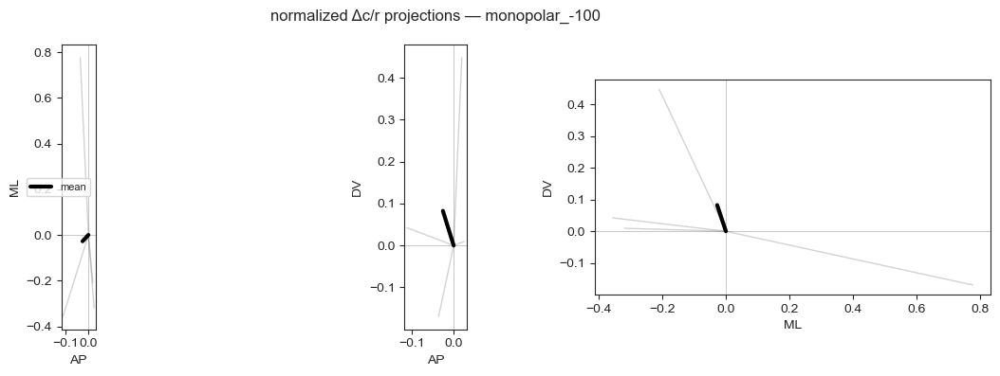

In [149]:
# set the condition to analyze (e.g., "monopolar_-50")
COND = "monopolar_-100"

# --- expects asym_df with columns:
# ['rec','condition','delta_x','delta_y','delta_z','delta_mag','delta_norm','r_L2_fixed']

df = asym_df.copy()

# helpers (unchanged)
def _safe_unit(v):
    # return unit vectors rowwise; safe for zero vectors
    n = np.linalg.norm(v, axis=1, keepdims=True)
    n = np.where(n == 0, 1.0, n)
    return v / n

def mean_direction(vecs, weights=None):
    # mean direction of unit vectors with optional weights
    V = np.asarray(vecs, float)
    if weights is None:
        w = np.ones((V.shape[0], 1), float)  # shape (n,1)
    else:
        w = np.asarray(weights, float).reshape(-1, 1)
    m = np.sum(w * V, axis=0)
    m_mag = float(np.linalg.norm(m))
    m_dir = m / m_mag if m_mag > 0 else np.array([np.nan, np.nan, np.nan], float)
    R = float(m_mag / np.sum(w))  # resultant in [0,1] if vecs are unit
    return m_dir, m_mag, R

def _sem_1d(x):
    # standard error for 1d array
    x = np.asarray(x, float)
    n = x.size
    if n <= 1:
        return 0.0
    return x.std(ddof=1) / np.sqrt(n)

# filter to one condition
sub = df[df['condition'] == COND].copy()
if sub.empty:
    raise ValueError(f"no rows found for condition: {COND}")

# average within each recording so that each rec contributes once
# (uses simple means; swap to 'median' if you want robustness)
g = (sub.groupby('rec', as_index=False)
       .agg({
           'condition':'first',
           'delta_x':'mean','delta_y':'mean','delta_z':'mean',
           'delta_mag':'mean','delta_norm':'mean',
           'r_L2_fixed':'mean'
       }))

# build per-recording vectors
V = g[['delta_x','delta_y','delta_z']].to_numpy(float)      # raw deltas (µm)
U = _safe_unit(V)                                           # unit directions
w_abs  = g['delta_mag'].to_numpy(float)                     # weights by |Δc|
w_norm = g['delta_norm'].to_numpy(float)                    # weights by Δc/r

# normalized vectors per recording (Δc/r; unitless)
r = np.clip(g['r_L2_fixed'].to_numpy(float), 1e-9, None)
N = (V.T / r).T

# mean directions across recordings
u_mean_unw, _,   R_unw  = mean_direction(U, None)
u_mean_wabs, _,  R_wabs = mean_direction(U, w_abs)
u_mean_wnrm, _,  R_wnrm = mean_direction(U, w_norm)

# component-wise means across recordings
raw_mean  = V.mean(axis=0)
norm_mean = N.mean(axis=0)

# component-wise sem across recordings
raw_sem  = np.array([_sem_1d(V[:,0]), _sem_1d(V[:,1]), _sem_1d(V[:,2])])
norm_sem = np.array([_sem_1d(N[:,0]), _sem_1d(N[:,1]), _sem_1d(N[:,2])])

# magnitudes (informative but not used as weights in the summary print)
raw_mean_mag  = float(np.linalg.norm(raw_mean))
norm_mean_mag = float(np.linalg.norm(norm_mean))

# text summary
print(f"=== anisotropy summary for condition: {COND} ===")
print(f"n recordings: {len(g)}")
print(f"unweighted mean direction (unit): {u_mean_unw}, resultant={R_unw:.3f}")
print(f"weighted by |Δc| mean dir (unit): {u_mean_wabs}, resultant={R_wabs:.3f}")
print(f"weighted by Δc/r mean dir (unit): {u_mean_wnrm}, resultant={R_wnrm:.3f}")
print(f"mean raw Δc (µm): {raw_mean} ± {raw_sem}  |Δc|={raw_mean_mag:.1f}")
print(f"mean normalized Δc/r: {norm_mean} ± {norm_sem}  ||={norm_mean_mag:.3f}")

# simple 3d plots for this condition only
# raw vectors (µm)
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(projection='3d')
for v in V:
    ax.plot([0, v[0]], [0, v[1]], [0, v[2]], color='gray', alpha=0.35, lw=1)
ax.plot([0, raw_mean[0]], [0, raw_mean[1]], [0, raw_mean[2]], color='k', lw=3, label='mean (µm)')
ax.set_xlabel('AP (µm)'); ax.set_ylabel('ML (µm)'); ax.set_zlabel('DV (µm)')
ax.invert_zaxis()
ax.set_title(f'center-shift vectors — raw (condition: {COND})')
ax.legend(fontsize=8)
ax.set_box_aspect([1,1,1])
plt.tight_layout()

# normalized vectors (Δc/r)
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(projection='3d')
for nvec in N:
    ax.plot([0, nvec[0]], [0, nvec[1]], [0, nvec[2]], color='gray', alpha=0.35, lw=1)
ax.plot([0, norm_mean[0]], [0, norm_mean[1]], [0, norm_mean[2]], color='k', lw=3, label='mean (Δc/r)')
ax.set_xlabel('AP (Δc/r)'); ax.set_ylabel('ML (Δc/r)'); ax.set_zlabel('DV (Δc/r)')
ax.invert_zaxis()
ax.set_title(f'center-shift vectors — normalized (condition: {COND})')
ax.legend(fontsize=8)
ax.set_box_aspect([1,1,1])
plt.tight_layout()

# quick 2d projections (normalized)
pairs = [('AP','ML',0,1), ('AP','DV',0,2), ('ML','DV',1,2)]
fig, axes = plt.subplots(1, 3, figsize=(12,4))
for ax, (labx, laby, ix, iy) in zip(axes, pairs):
    for nvec in N:
        ax.plot([0, nvec[ix]], [0, nvec[iy]], color='gray', alpha=0.35, lw=1)
    ax.plot([0, norm_mean[ix]], [0, norm_mean[iy]], color='k', lw=3, label='mean' if ix==0 and iy==1 else None)
    ax.axhline(0, color='k', lw=0.5, alpha=0.3)
    ax.axvline(0, color='k', lw=0.5, alpha=0.3)
    ax.set_xlabel(labx); ax.set_ylabel(laby)
    ax.set_aspect('equal', adjustable='box')
axes[0].legend(fontsize=8)
fig.suptitle(f'normalized Δc/r projections — {COND}')
plt.tight_layout()


=== overall anisotropy summary ===
unweighted mean direction (unit): [-0.3824408  -0.91702162 -0.11318295], resultant=0.404
weighted by |Δc| mean dir (unit): [-0.36783299 -0.89040224 -0.26810959], resultant=0.373
weighted by Δc/r mean dir (unit): [-0.29186726 -0.9140394  -0.28168329], resultant=0.391
mean raw vector Δc (μm): [ -61.44004694 -148.72607262  -44.7830028 ] ± [23.9204317  69.32209198 32.06787371]  |Δc|=167.0
mean normalized Δc/r:     [-0.06653569 -0.20836952 -0.06421409] ± [0.02915837 0.09353635 0.04276893]  ||=0.228

=== per-condition summary (weighted by Δc/r direction) ===
     condition  n  mean_dir_x  mean_dir_y  mean_dir_z  resultant  mean_raw_dx_um  mean_raw_dy_um  mean_raw_dz_um  sem_raw_dx_um  sem_raw_dy_um  sem_raw_dz_um  mean_norm_dx  mean_norm_dy  mean_norm_dz  sem_norm_dx  sem_norm_dy  sem_norm_dz
  bipolar_-100  4      -0.519      -0.852       0.064      0.705        -237.768        -334.874          12.273        189.212        268.020         70.541        -0

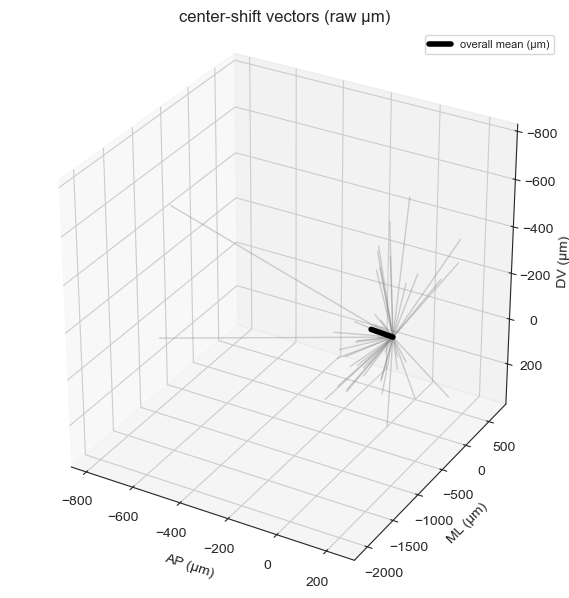

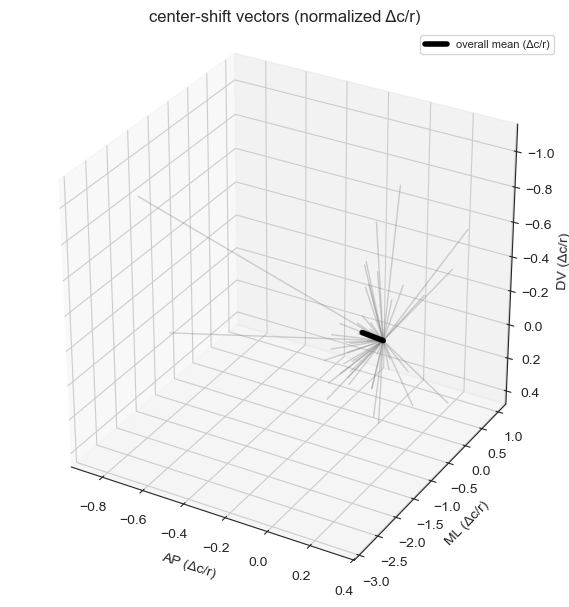

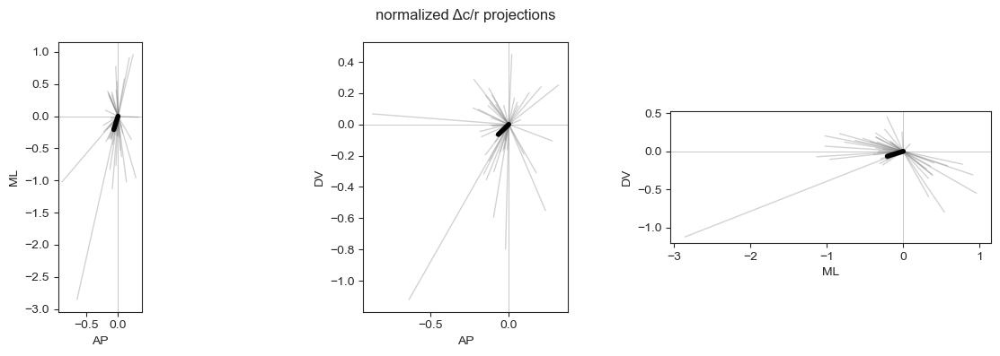

In [122]:
# --- average anisotropy summaries and plots from asym_df ---
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# expects asym_df with columns:
# ['rec','condition','delta_x','delta_y','delta_z','delta_mag','delta_norm','r_L2_fixed']

df = asym_df.copy()

# helpers
def _safe_unit(v):
    n = np.linalg.norm(v, axis=1, keepdims=True)
    n = np.where(n == 0, 1.0, n)
    return v / n

def mean_direction(vecs, weights=None):
    # vecs shape (n,3); weights shape (n,)
    V = np.asarray(vecs, float)
    if weights is None:
        w = np.ones((V.shape[0], 1), float)  # <- make it (n,1)
    else:
        w = np.asarray(weights, float).reshape(-1, 1)
    m = np.sum(w * V, axis=0)
    m_mag = float(np.linalg.norm(m))
    m_dir = m / m_mag if m_mag > 0 else np.array([np.nan, np.nan, np.nan], float)
    R = float(m_mag / np.sum(w))  # resultant length in [0,1] if vecs are unit
    return m_dir, m_mag, R


# build vectors
V = df[['delta_x','delta_y','delta_z']].to_numpy(float)
U = _safe_unit(V)                             # unit directions
w_abs = df['delta_mag'].to_numpy(float)       # weight by magnitude (μm)
w_norm = df['delta_norm'].to_numpy(float)     # weight by normalized magnitude

# overall means
u_mean_unw, m_unw_mag, R_unw = mean_direction(U, None)
u_mean_wabs, m_wabs_mag, R_wabs = mean_direction(U, w_abs)
u_mean_wnorm, m_wnorm_mag, R_wnorm = mean_direction(U, w_norm)

# also compute mean raw vector (μm) and mean normalized vector (unitless)
raw_mean = V.mean(axis=0)
raw_mean_mag = float(np.linalg.norm(raw_mean))

normed_V = (V.T / np.clip(df['r_L2_fixed'].to_numpy(float), 1e-9, None)).T  # Δc/r per row, in xyz
norm_mean = normed_V.mean(axis=0)
norm_mean_mag = float(np.linalg.norm(norm_mean))

# sem for each component of raw and normalized shifts
def _sem_1d(x):
    x = np.asarray(x, float)
    n = x.size
    if n <= 1:
        return 0.0
    return x.std(ddof=1) / np.sqrt(n)

raw_sem = df[['delta_x','delta_y','delta_z']].apply(_sem_1d, axis=0)
norm_sem = pd.DataFrame(
    (df[['delta_x','delta_y','delta_z']].to_numpy(float).T /
     np.clip(df['r_L2_fixed'].to_numpy(float), 1e-9, None)).T,
    columns=['nx','ny','nz']
).apply(_sem_1d, axis=0)

print("=== overall anisotropy summary ===")
print(f"unweighted mean direction (unit): {u_mean_unw}, resultant={R_unw:.3f}")
print(f"weighted by |Δc| mean dir (unit): {u_mean_wabs}, resultant={R_wabs:.3f}")
print(f"weighted by Δc/r mean dir (unit): {u_mean_wnorm}, resultant={R_wnorm:.3f}")
print(f"mean raw vector Δc (μm): {raw_mean} ± {raw_sem.to_numpy()}  |Δc|={raw_mean_mag:.1f}")
print(f"mean normalized Δc/r:     {norm_mean} ± {norm_sem.to_numpy()}  ||={norm_mean_mag:.3f}")

cond_rows = []
for cond, sub in df.groupby('condition'):
    Vc = sub[['delta_x','delta_y','delta_z']].to_numpy(float)  # raw deltas (µm)
    r = np.clip(sub['r_L2_fixed'].to_numpy(float), 1e-9, None)
    Nc = (Vc.T / r).T                                        # normalized deltas (Δc/r)

    # unit directions weighted by Δc/r
    Uc = _safe_unit(Vc)
    wc = sub['delta_norm'].to_numpy(float)
    u_dir, _, R = mean_direction(Uc, wc)

    # means
    raw = Vc.mean(axis=0)
    norm = Nc.mean(axis=0)

    # sems (axis-wise)
    raw_sem = np.array([_sem_1d(Vc[:,0]), _sem_1d(Vc[:,1]), _sem_1d(Vc[:,2])])
    norm_sem = np.array([_sem_1d(Nc[:,0]), _sem_1d(Nc[:,1]), _sem_1d(Nc[:,2])])

    cond_rows.append({
        "condition": cond,
        "n": len(sub),
        "mean_dir_x": u_dir[0], "mean_dir_y": u_dir[1], "mean_dir_z": u_dir[2],
        "resultant": R,
        "mean_raw_dx_um": raw[0], "mean_raw_dy_um": raw[1], "mean_raw_dz_um": raw[2],
        "sem_raw_dx_um": raw_sem[0], "sem_raw_dy_um": raw_sem[1], "sem_raw_dz_um": raw_sem[2],
        "mean_norm_dx": norm[0], "mean_norm_dy": norm[1], "mean_norm_dz": norm[2],
        "sem_norm_dx": norm_sem[0], "sem_norm_dy": norm_sem[1], "sem_norm_dz": norm_sem[2],
    })

cond_summary = pd.DataFrame(cond_rows).sort_values('condition')
print("\n=== per-condition summary (weighted by Δc/r direction) ===")
print(cond_summary.to_string(index=False, float_format=lambda x: f"{x:.3f}"))

# colors per condition
conds = cond_summary['condition'].tolist()
cmap = plt.get_cmap('tab10')
color_map = {c: cmap(i % 10) for i, c in enumerate(sorted(df['condition'].unique()))}

# 3d plot: raw Δc vectors (μm), overall and per-condition means
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(projection='3d')

# plot individual vectors as faint lines from origin
for (_, row) in df.iterrows():
    v = np.array([row['delta_x'], row['delta_y'], row['delta_z']], float)
    c = color_map[row['condition']]
    ax.plot([0, v[0]], [0, v[1]], [0, v[2]], color='gray', alpha=0.35, lw=1)

# plot per-condition mean raw vectors (thicker)
#for (_, row) in cond_summary.iterrows():
#    v = np.array([row['mean_raw_dx_um'], row['mean_raw_dy_um'], row['mean_raw_dz_um']], float)
#    c = color_map[row['condition']]
#    ax.plot([0, v[0]], [0, v[1]], [0, v[2]], color=c, lw=3, label=row['condition'])

# plot overall mean raw vector
ax.plot([0, raw_mean[0]], [0, raw_mean[1]], [0, raw_mean[2]], color='k', lw=4, label='overall mean (μm)')

ax.set_xlabel('AP (μm)'); ax.set_ylabel('ML (μm)'); ax.set_zlabel('DV (μm)')
ax.invert_zaxis()
ax.set_title('center-shift vectors (raw μm)')
ax.legend(loc='best', fontsize=8)
ax.set_box_aspect([1,1,1])
plt.tight_layout()
#plt.savefig(os.path.join(save_path, "center_shift_raw_vectors.pdf"))
#plt.savefig(os.path.join(save_path, "center_shift_raw_vectors.png"))

# 3d plot: normalized Δc/r vectors (unitless), means per condition + overall
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(projection='3d')

# individual normalized vectors from origin
for (_, row) in df.iterrows():
    r = max(row['r_L2_fixed'], 1e-9)
    v = np.array([row['delta_x']/r, row['delta_y']/r, row['delta_z']/r], float)
    c = color_map[row['condition']]
    ax.plot([0, v[0]], [0, v[1]], [0, v[2]], color='gray', alpha=0.35, lw=1)

# per-condition mean normalized vectors
#for (_, row) in cond_summary.iterrows():
#    v = np.array([row['mean_norm_dx'], row['mean_norm_dy'], row['mean_norm_dz']], float)
#    c = color_map[row['condition']]
#    ax.plot([0, v[0]], [0, v[1]], [0, v[2]], color=c, lw=3) #, label=row['condition'])

# overall mean normalized vector
ax.plot([0, norm_mean[0]], [0, norm_mean[1]], [0, norm_mean[2]], color='k', lw=4, label='overall mean (Δc/r)')

ax.set_xlabel('AP (Δc/r)'); ax.set_ylabel('ML (Δc/r)'); ax.set_zlabel('DV (Δc/r)')
ax.invert_zaxis()
ax.set_title('center-shift vectors (normalized Δc/r)')
ax.legend(loc='best', fontsize=8)
ax.set_box_aspect([1,1,1])
plt.tight_layout()
#plt.savefig(os.path.join(save_path, "center_shift_norm_vectors.pdf"))
#plt.savefig(os.path.join(save_path, "center_shift_norm_vectors.png"))

# 2d projections for quick inspection (normalized)
pairs = [('AP','ML',0,1), ('AP','DV',0,2), ('ML','DV',1,2)]
fig, axes = plt.subplots(1, 3, figsize=(12,4))
for ax, (labx, laby, ix, iy) in zip(axes, pairs):
    # individuals
    for (_, row) in df.iterrows():
        r = max(row['r_L2_fixed'], 1e-9)
        vx = row[['delta_x','delta_y','delta_z']].to_numpy(float)[ix] / r
        vy = row[['delta_x','delta_y','delta_z']].to_numpy(float)[iy] / r
        c = color_map[row['condition']]
        ax.plot([0, vx], [0, vy], color='gray', alpha=0.35, lw=1) # ignore color for clarity
    # per-condition means
    #for (_, row) in cond_summary.iterrows():
    #    v = np.array([row['mean_norm_dx'], row['mean_norm_dy'], row['mean_norm_dz']], float)
    #    ax.plot([0, v[ix]], [0, v[iy]], color='gray', lw=3)
    # overall mean
    ax.plot([0, norm_mean[ix]], [0, norm_mean[iy]], color='k', lw=4, label='overall mean' if ix==0 and iy==1 else None)
    ax.axhline(0, color='k', lw=0.5, alpha=0.3)
    ax.axvline(0, color='k', lw=0.5, alpha=0.3)
    ax.set_xlabel(labx); ax.set_ylabel(laby)
    ax.set_aspect('equal', adjustable='box')
#axes[0].legend(loc='best', fontsize=8)
fig.suptitle('normalized Δc/r projections')
plt.tight_layout()
#plt.savefig(os.path.join(save_path, "center_shift_norm_2dproj.pdf"))
#plt.savefig(os.path.join(save_path, "center_shift_norm_2dproj.png"))


In [124]:
1.360e-02

0.0136

In [125]:
3.735e-02

0.03735

In [126]:
1.694e-01

0.1694

In [135]:
from scipy.stats import ttest_1samp

for axis in ['delta_x', 'delta_y', 'delta_z']:
    tval, pval = ttest_1samp(df[axis], 0.0)
    print(f"{axis}: t={tval:.3f}, p={pval:.3f}")


delta_x: t=-2.569, p=0.014
delta_y: t=-2.145, p=0.037
delta_z: t=-1.397, p=0.169


In [132]:
from scipy.stats import wilcoxon

for axis in ['delta_x', 'delta_y', 'delta_z']:
    stat, pval = wilcoxon(df[axis])
    print(f"{axis}: W={stat:.3f}, p={pval:.3g}")


delta_x: W=298.000, p=0.00733
delta_y: W=364.000, p=0.0539
delta_z: W=464.000, p=0.41


In [8]:
# --- tessellated coloring with optional overlays: sphere surface + sphere hull wireframe ---
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# l2 radius with fixed center
def fixed_center_radius(points, center):
    d = np.linalg.norm(points - center, axis=1)
    return float(d.mean())

# sphere points along same directions as measured points
def direction_matched_sphere_points(points, center, r):
    v = points - center
    n = np.linalg.norm(v, axis=1, keepdims=True)
    u = v / np.clip(n, 1e-12, None)
    return center + r * u

# convex hull (equations: rows [a,b,c,d] with ax+by+cz+d <= 0 inside)
def build_hull(points):
    hull = ConvexHull(points)
    return points.copy(), hull.simplices, hull.equations

# inside test via half-spaces
def inside_convex_hull(P, equations, tol=1e-9):
    A = equations[:, :3]
    d = equations[:, 3]
    return np.all(P @ A.T + d <= tol, axis=1)

# closest ⟂ distance from point to triangle
def point_triangle_distance(p, a, b, c):
    ab, ac, ap = b - a, c - a, p - a
    d1, d2 = np.dot(ab, ap), np.dot(ac, ap)
    if d1 <= 0 and d2 <= 0: return float(np.linalg.norm(p - a))
    bp = p - b
    d3, d4 = np.dot(ab, bp), np.dot(ac, bp)
    if d3 >= 0 and d4 <= d3: return float(np.linalg.norm(p - b))
    vc = d1*d4 - d3*d2
    if vc <= 0 and d1 >= 0 and d3 <= 0:
        v = d1 / (d1 - d3); proj = a + v*ab
        return float(np.linalg.norm(p - proj))
    cp = p - c
    d5, d6 = np.dot(ab, cp), np.dot(ac, cp)
    if d6 >= 0 and d5 <= d6: return float(np.linalg.norm(p - c))
    vb = d5*d2 - d1*d6
    if vb <= 0 and d2 >= 0 and d6 <= 0:
        w = d2 / (d2 - d6); proj = a + w*ac
        return float(np.linalg.norm(p - proj))
    va = d3*d6 - d5*d4
    if va <= 0 and (d4 - d3) >= 0 and (d5 - d6) >= 0:
        u = (d4 - d3) / ((d4 - d3) + (d5 - d6)); proj = b + u*(c - b)
        return float(np.linalg.norm(p - proj))
    n = np.cross(ab, ac); n /= np.clip(np.linalg.norm(n), 1e-12, None)
    return float(abs(np.dot(p - a, n)))

# min distance from point to convex mesh
def point_to_mesh_distance(p, verts, faces):
    dmin = np.inf
    for i, j, k in faces:
        d = point_triangle_distance(p, verts[i], verts[j], verts[k])
        if d < dmin: dmin = d
    return float(dmin)

# regular triangular tessellation of a face
def tessellate_face(a, b, c, n_sub=30):
    ab, ac = b - a, c - a
    pts, ij_to_idx, idx = [], {}, 0
    for i in range(n_sub + 1):
        for j in range(n_sub + 1 - i):
            p = a + (i / n_sub) * ab + (j / n_sub) * ac
            pts.append(p); ij_to_idx[(i, j)] = idx; idx += 1
    pts = np.asarray(pts, float)
    tris = []
    for i in range(n_sub):
        for j in range(n_sub - i):
            i0 = ij_to_idx[(i, j)]
            i1 = ij_to_idx[(i + 1, j)]
            i2 = ij_to_idx[(i, j + 1)]
            tris.append([i0, i1, i2])
            if j + 1 <= n_sub - (i + 1):
                i3 = ij_to_idx[(i + 1, j + 1)]
                tris.append([i1, i3, i2])
    return pts, np.asarray(tris, int)

# equal aspect
def set_equal_3d(ax, pts):
    pts = np.asarray(pts, float)
    span = (pts.max(axis=0) - pts.min(axis=0)).max()
    mid = pts.mean(axis=0)
    ax.set_xlim(mid[0]-span/2, mid[0]+span/2)
    ax.set_ylim(mid[1]-span/2, mid[1]+span/2)
    ax.set_zlim(mid[2]-span/2, mid[2]+span/2)

# smooth sphere surface
def plot_sphere_surface(ax, center, r, alpha=0.08, color='gray'):
    phi, theta = np.mgrid[0.0:np.pi:140j, 0.0:2.0*np.pi:140j]
    X = r * np.sin(phi) * np.cos(theta) + center[0]
    Y = r * np.sin(phi) * np.sin(theta) + center[1]
    Z = r * np.cos(phi)                    + center[2]
    ax.plot_surface(X, Y, Z, edgecolor='none', alpha=alpha, color=color)

# main: measured hull colored by signed ⟂ distance to sphere hull, with optional overlays
def plot_measured_vs_sphere_perp_tess(points,
                                      center,
                                      n_sub=12,
                                      title='',
                                      plot_sphere=True,
                                      plot_sphere_hull=True,
                                      plot_measured_hull_wire=False,
                                      sphere_alpha=0.06):
    np.random.seed(0)
    points = np.asarray(points, float); center = np.asarray(center, float)

    # sphere (direction-matched hull and continuous surface)
    r = fixed_center_radius(points, center)
    sphere_pts = direction_matched_sphere_points(points, center, r)

    # hulls
    V_meas, F_meas, _      = build_hull(points)
    V_sph,  F_sph, eq_sph  = build_hull(sphere_pts)

    # tessellate each measured face and color by signed ⟂ distance to sphere hull
    small_tris, small_cols = [], []
    for (i, j, k) in F_meas:
        a, b, c = V_meas[i], V_meas[j], V_meas[k]
        sub_pts, sub_tris = tessellate_face(a, b, c, n_sub=n_sub)
        inside = inside_convex_hull(sub_pts, eq_sph)
        dists = np.array([point_to_mesh_distance(p, V_sph, F_sph) for p in sub_pts])
        signed = np.where(inside, -dists, dists)
        for tri in sub_tris:
            small_tris.append(sub_pts[tri])
            small_cols.append(float(np.mean(signed[tri])))

    # plot
    fig = plt.figure(figsize=(6,5))
    ax = fig.add_subplot(projection='3d')

    # colored tessellated mesh
    coll = Poly3DCollection(small_tris, linewidths=0.0)
    vmax = max(1e-6, float(np.nanmax(np.abs(small_cols))))
    coll.set_array(np.asarray(small_cols))
    coll.set_cmap('coolwarm')
    coll.set_clim(-vmax, vmax)
    coll.set_alpha(0.7)
    ax.add_collection3d(coll)

    # optional overlays
    if plot_sphere_hull:
        polys_sph = [[V_sph[i], V_sph[j], V_sph[k]] for (i,j,k) in F_sph]
        ax.add_collection3d(Poly3DCollection(
            polys_sph, linewidths=0.8, edgecolors=(0,0,0,0.35), facecolor=(0,0,0,0.04)
        ))
    if plot_measured_hull_wire:
        polys_meas = [[V_meas[i], V_meas[j], V_meas[k]] for (i,j,k) in F_meas]
        ax.add_collection3d(Poly3DCollection(
            polys_meas, linewidths=0.8, edgecolors=(0,0,0,0.25), facecolor=(0,0,0,0.00)
        ))
    if plot_sphere:
        plot_sphere_surface(ax, center, r, alpha=sphere_alpha, color='gray')

    # points + center
    ax.scatter(points[:,0], points[:,1], points[:,2], s=22, c='k', alpha=0.9)
    ax.scatter(center[0], center[1], center[2], s=45, c='k')

    # colorbar + axes
    cbar = plt.colorbar(coll, ax=ax, shrink=0.72, pad=0.05)
    cbar.set_label('signed ⟂ distance to sphere hull [μm]  (+ outside, − inside)')
    ax.set_xlabel('AP (μm)'); ax.set_ylabel('ML (μm)'); ax.set_zlabel('DV (μm)')
    set_equal_3d(ax, np.vstack([points, sphere_pts, center[None,:]]))
    #ax.invert_yaxis() # so closer is lateral 
    ax.invert_zaxis() # so up is towards surface
    
    ax.set_title(title if title else f'measured hull (tessellated), r={r:.1f} μm')
    plt.tight_layout()
    return r, {"V_meas": V_meas, "F_meas": F_meas, "V_sph": V_sph, "F_sph": F_sph}


C:\Users\jordan\AppData\Local\Temp\ipykernel_93392\3240770502.py:174: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  plt.tight_layout()
C:\Users\jordan\AppData\Local\Temp\ipykernel_93392\3240770502.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(6,5))


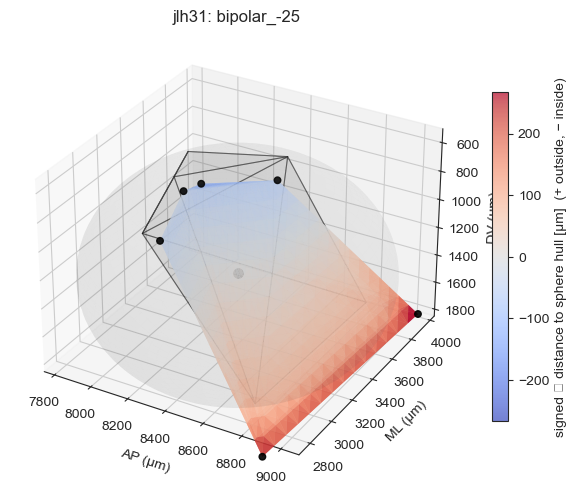

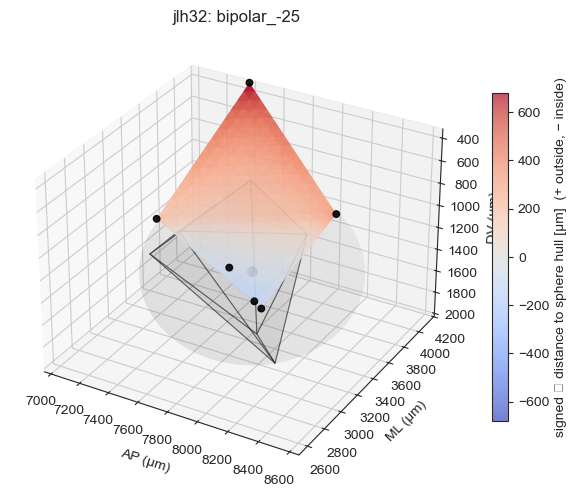

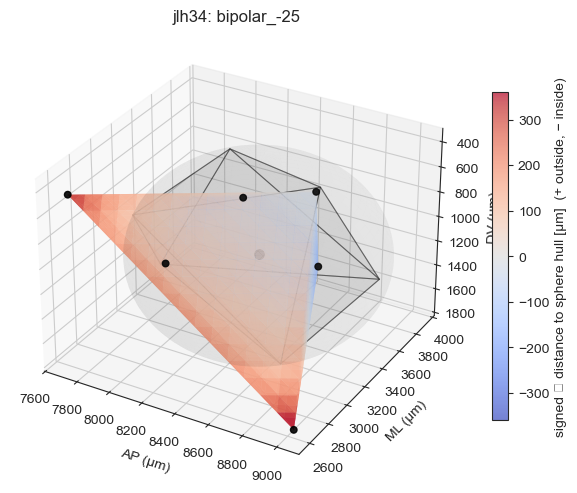

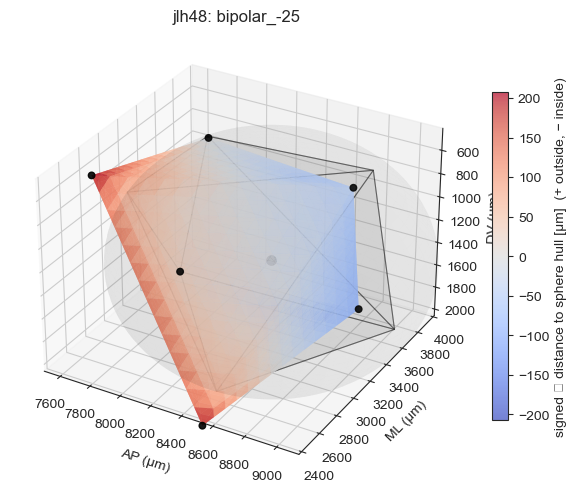

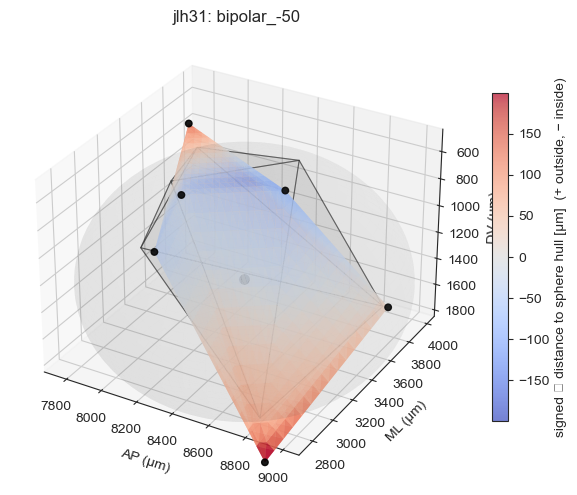

...

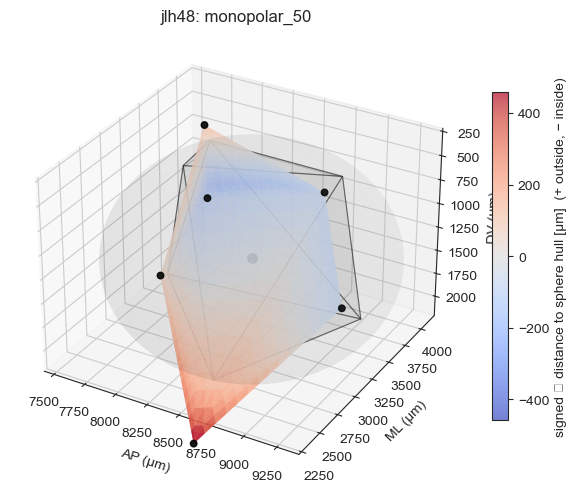

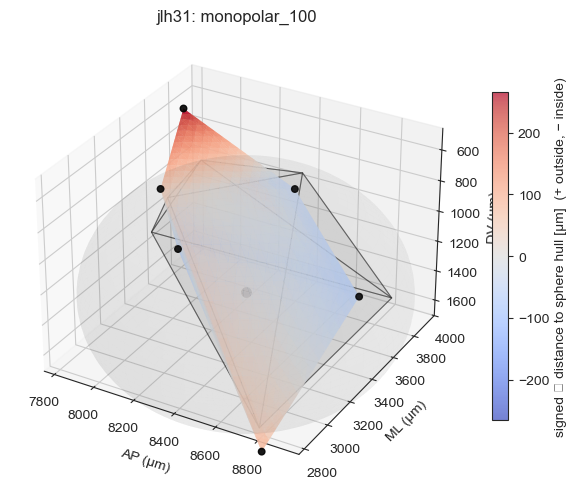

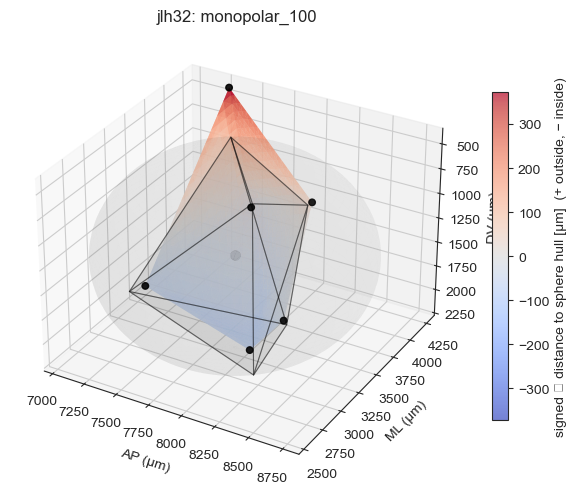

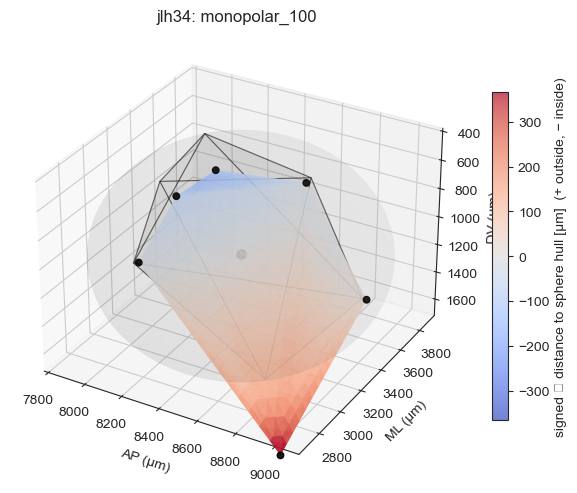

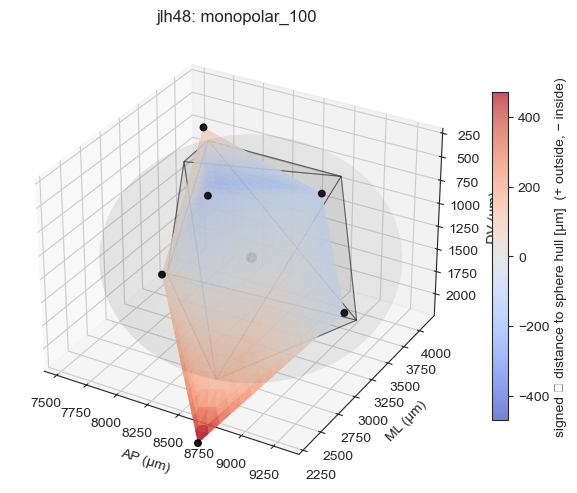

In [246]:
for condition, data in points_dict.items():
    for i, pts in enumerate(data):
        rec = recordings[condition][i]
        key = f'{rec}_{condition}'
        if key not in stim_points: continue
        center = np.asarray(stim_points[key], float)
        plot_measured_vs_sphere_perp_tess(
            np.asarray(pts, float),
            center,
            n_sub=14,
            title=f"{rec}: {condition}",
            plot_sphere=True,
            plot_sphere_hull=True,
            plot_measured_hull_wire=False,   # set True if you want a measured wireframe overlay
            sphere_alpha=0.05
        )

## getting anatomical brain masks for surface and cc specifically!

In [9]:
from brainglobe_atlasapi import BrainGlobeAtlas

bg_atlas = BrainGlobeAtlas("allen_mouse_10um", check_latest=False)

mask_VISp = bg_atlas.get_structure_mask('VISp')
mask_cc = bg_atlas.get_structure_mask('cc')
mask_root = bg_atlas.get_structure_mask('root') # root mask is important for brain shape

# The mask images have pixel values equal to the ID of the parent area, so we change these for
# plotting purposes. 
mask_root[mask_root>0]=1
mask_VISp[mask_VISp>0]=2
mask_VISp_root = mask_VISp + mask_root

mask_cc[mask_cc>0]=2
mask_cc_root = mask_cc + mask_root

In [18]:
mask_cc.shape

(1320, 800, 1140)

In [23]:
# confine mask to a bounding box around the area of interest 
# 
ap_bounds = 760, 900
ml_bounds = 260, 400
dv_bounds = 20, 200

# crop mask_cc (ap, ml, dv) (shape: (1320, 800, 1140))
mask_cc_crop = mask_cc[ap_bounds[0]:ap_bounds[1], ml_bounds[0]:ml_bounds[1], dv_bounds[0]:dv_bounds[1]]

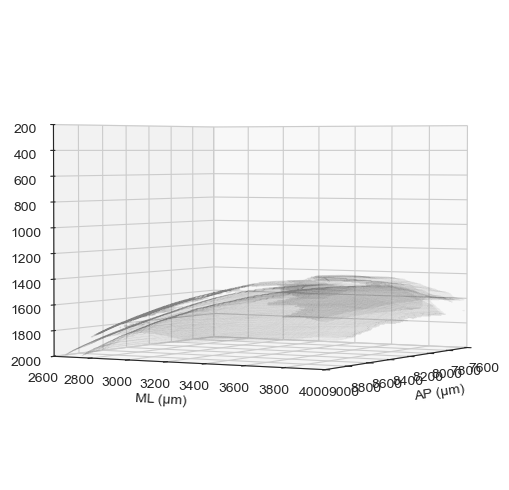

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage.measure import marching_cubes

def plot_cc_isosurface(mask_cc, step=1, pad=2,
                       ap_bounds=None, ml_bounds=None, dv_bounds=None,
                       fig=None, ax=None):
    """
    mask_cc: (ap, ml, dv) Allen 10um volume; mask_cc>0 is CC
    step: downsample stride for speed
    *_bounds: tuples (lo, hi) in voxel indices, e.g., (760, 900)
    """
    # binarize
    vol = (mask_cc > 0).astype(np.uint8)

    # optional explicit crop region (your bounding box)
    if (ap_bounds is not None) and (ml_bounds is not None) and (dv_bounds is not None):
        ap0, ap1 = ap_bounds
        ml0, ml1 = ml_bounds
        dv0, dv1 = dv_bounds
        vol_crop = vol[ap0:ap1, ml0:ml1, dv0:dv1]
        # atlas-space origin (in µm) for this crop
        origin_ap_um = ap0 * 10
        origin_ml_um = ml0 * 10
        origin_dv_um = dv0 * 10
    else:
        # auto tight bbox (original behavior)
        pts = np.argwhere(vol)
        if pts.size == 0:
            raise ValueError("no cc voxels found (mask_cc > 0 is empty).")
        mins = np.maximum(pts.min(axis=0) - pad, 0)
        maxs = np.minimum(pts.max(axis=0) + 1 + pad, vol.shape)
        ap0, ml0, dv0 = mins
        ap1, ml1, dv1 = maxs
        vol_crop = vol[ap0:ap1, ml0:ml1, dv0:dv1]
        origin_ap_um = ap0 * 10
        origin_ml_um = ml0 * 10
        origin_dv_um = dv0 * 10

    # downsample
    vol_ds = vol_crop[::step, ::step, ::step]

    # spacing in µm (10 µm voxels * step)
    spc = (10 * step, 10 * step, 10 * step)

    # isosurface (keeping your axis handling as-is)
    verts, faces, normals, _ = marching_cubes(vol_ds, level=0.5, spacing=spc)

    # add atlas-space origin offsets so verts land at true coordinates
    verts[:, 0] += origin_ap_um  # AP
    verts[:, 1] += origin_ml_um  # ML
    verts[:, 2] += origin_dv_um  # DV

    if fig is None or ax is None:
        fig = plt.figure(figsize=(6, 5))
        ax = fig.add_subplot(projection='3d')

    mesh = Poly3DCollection(verts[faces], alpha=0.1, facecolor='gray', linewidths=0)
    ax.add_collection3d(mesh)

    # keep your exact axes (do not change)
    ax.set_xlim([7600, 9000])
    ax.set_ylim([2600, 4000])
    ax.set_zlim([2000, 200])

    ax.set_xlabel('AP (µm)')
    ax.set_ylabel('ML (µm)')
    ax.set_zlabel('DV (µm)')
    ax.view_init(elev=2, azim=30, roll=0)
    plt.tight_layout()

# usage with your crop:
ap_bounds = (760, 900); ml_bounds = (260, 400); dv_bounds = (20, 200)
plot_cc_isosurface(mask_cc, step=1, ap_bounds=ap_bounds, ml_bounds=ml_bounds, dv_bounds=dv_bounds)


In [46]:
# simple 3d isosurface of corpus callosum from allen 10um volume
# expects mask_cc with shape (ap, ml, dv) where mask_cc>0 marks CC

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage.measure import marching_cubes

def plot_cc_isosurface(mask_cc, step=1, pad=2, fig = None, ax = None):
    # binarize
    vol = (mask_cc > 0).astype(np.uint8)

    # crop to nonzero bbox to save time/memory
    pts = np.argwhere(vol)
    if pts.size == 0:
        raise ValueError("no cc voxels found (mask_cc > 0 is empty).")
    mins = np.maximum(pts.min(axis=0) - pad, 0)
    maxs = np.minimum(pts.max(axis=0) + 1 + pad, vol.shape)

    ap0, ml0, dv0 = mins
    ap1, ml1, dv1 = maxs
    vol_crop = vol[ap0:ap1, ml0:ml1, dv0:dv1]

    # downsample to keep triangles manageable
    vol_ds = vol_crop[::step, ::step, ::step]

    # spacing in microns (atlas is 10um isotropic; scale by downsample step)
    spc = (10 * step, 10 * step, 10 * step)  

    # run marching cubes on a binary volume at level 0.5
    verts, faces, normals, _ = marching_cubes(vol_ds, level=0.5, spacing=spc)
    verts_ap = verts[:, 0] + ap0 * 10
    verts_ml = verts[:, 1] + ml0 * 10
    verts_dv = verts[:, 2] + dv0 * 10
    verts = np.column_stack([verts_ap, verts_ml, verts_dv])
    
    
    if fig is None or ax is None:
        fig = plt.figure(figsize=(6,5))
        ax = fig.add_subplot(projection='3d')

    mesh = Poly3DCollection(verts[faces], alpha=0.1, facecolor='gray', linewidths=0)
    #mesh.set_edgecolor('k')   # thin edges help orientation; remove if you hate grid lines
    ax.add_collection3d(mesh)

    # set limits from verts
    #xlim = (verts[:, 0].min(), verts[:, 0].max())  # ap
    #ylim = (verts[:, 1].min(), verts[:, 1].max())  # ml
    #zlim = (verts[:, 2].min(), verts[:, 2].max())  # dv

    ax.set_xlim([7600, 9000])
    ax.set_ylim([2600, 4000])
    ax.set_zlim([2000, 200])

    ax.set_xlabel('AP (µm)')
    ax.set_ylabel('ML (µm)')
    ax.set_zlabel('DV (µm)')

    ax.view_init(elev=2, azim=30, roll=0)
    plt.tight_layout()



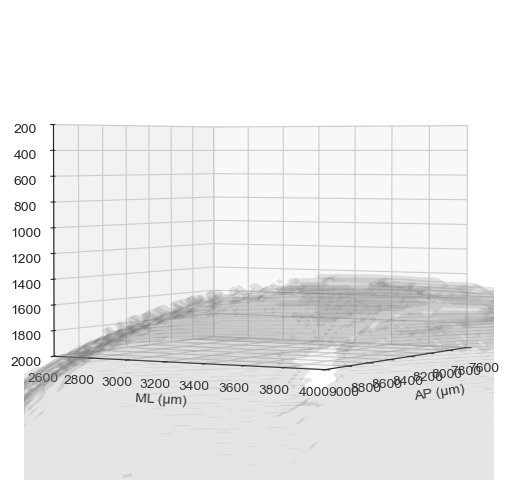

In [47]:
# usage:
plot_cc_isosurface(mask_cc, step=4)


## averaging!

In [35]:
# --- condition-level averaged convex hulls + optional tessellated ⟂-distance coloring ---
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

## other necessary functions above!

# ========== spherical k-means (cluster directions to 6 canonical dirs) ==========
def spherical_kmeans(U, k=6, n_init=10, max_iter=100, seed=0):
    rng = np.random.default_rng(seed)
    best = None; best_inertia = np.inf
    for _ in range(n_init):
        C = U[rng.choice(len(U), size=k, replace=False)].copy()
        for it in range(max_iter):
            sims = U @ C.T
            labels = sims.argmax(axis=1)
            C_new = np.zeros_like(C)
            for j in range(k):
                pts = U[labels == j]
                if len(pts) == 0:
                    C_new[j] = U[rng.integers(len(U))]
                else:
                    c = pts.mean(axis=0)
                    n = np.linalg.norm(c)
                    C_new[j] = c / (n + 1e-12)
            if np.allclose(C_new, C, atol=1e-6): break
            C = C_new
        inertia = np.sum(1 - np.max(U @ C.T, axis=1))
        if inertia < best_inertia:
            best_inertia = inertia; best = (labels.copy(), C.copy())
    return best

# ========== build condition-level average measured hull ==========
def average_measured_hull_for_condition(points_dict, recordings, stim_points, condition, k=6, seed=0):
    # collect relative vectors (per record, 6 points)
    rel_dirs = []; rel_r = []; centers = []
    for i, pts in enumerate(points_dict[condition]):
        rec = recordings[condition][i]
        key = f"{rec}_{condition}"
        if key not in stim_points: continue
        c = np.asarray(stim_points[key], float)
        V = np.asarray(pts, float) - c
        r = np.linalg.norm(V, axis=1, keepdims=True)
        U = V / np.clip(r, 1e-12, None)
        rel_dirs.append(U); rel_r.append(r[:,0]); centers.append(c)
    if not rel_dirs:
        raise ValueError(f"no data for condition {condition}")
    U_all = np.vstack(rel_dirs)           # (R*6, 3)
    R_all = np.hstack(rel_r)              # (R*6,)
    centers = np.vstack(centers)          # (R,3)

    # cluster directions to k canonical directions
    labels, centers_dirs = spherical_kmeans(U_all, k=k, seed=seed)
    # mean radius per cluster (use arithmetic mean)
    r_means = np.array([float(np.mean(R_all[labels == j])) for j in range(k)])
    # canonical unit directions
    u_means = centers_dirs.copy()
    # pick a display center = mean center across records (you can also choose any reference)
    c_cond = centers.mean(axis=0)

    # build k averaged points
    avg_points = c_cond[None,:] + r_means[:,None] * u_means
    return avg_points, c_cond, r_means.mean(), u_means

# ========== plotting: avg hulls + optional tessellated coloring ==========
def plot_avg_hulls(condition, avg_points, center, show_sphere=True, show_sphere_hull=True, title=''):
    V_meas, F_meas, _ = build_hull(avg_points)
    r = fixed_center_radius(V_meas, center)
    sphere_pts = direction_matched_sphere_points(V_meas, center, r)
    V_sph, F_sph, _ = build_hull(sphere_pts)

    fig = plt.figure(figsize=(7,6))
    ax = fig.add_subplot(projection='3d')

    # measured avg hull (solid translucent)
    polys_meas = [[V_meas[i], V_meas[j], V_meas[k]] for (i,j,k) in F_meas]
    ax.add_collection3d(Poly3DCollection(polys_meas, linewidths=0.6, edgecolors=(0,0,0,0.22),
                                         facecolor=(0.25,0.5,1.0,0.28)))
    # sphere hull (wire)
    if show_sphere_hull:
        polys_sph = [[V_sph[i], V_sph[j], V_sph[k]] for (i,j,k) in F_sph]
        ax.add_collection3d(Poly3DCollection(polys_sph, linewidths=0.9, edgecolors=(0,0,0,0.45),
                                             facecolor=(0,0,0,0.04)))
    # continuous sphere
    if show_sphere:
        plot_sphere_surface(ax, center, r, alpha=0.06, color='gray')

    # mean points + center
    ax.scatter(avg_points[:,0], avg_points[:,1], avg_points[:,2], s=26, c='k', alpha=0.9)
    ax.scatter(center[0], center[1], center[2], s=50, c='k')

    ax.set_xlabel('AP (μm)'); ax.set_ylabel('ML (μm)'); ax.set_zlabel('DV (μm)')
    ax.invert_zaxis()
    set_equal_3d(ax, np.vstack([avg_points, sphere_pts, center[None,:]]))
    ax.set_title(title if title else f'{condition}: avg measured hull + sphere')
    plt.tight_layout()
    return r, (V_meas, F_meas, V_sph, F_sph)

def plot_avg_tessellated_signed_perp(condition, avg_points, center, n_sub=14, show_sphere=True, show_sphere_hull=True, title=''):
    V_meas, F_meas, _ = build_hull(avg_points)
    r = fixed_center_radius(V_meas, center)
    sphere_pts = direction_matched_sphere_points(V_meas, center, r)
    V_sph, F_sph, eq_sph = build_hull(sphere_pts)

    # tessellate measured-avg faces and color by signed ⟂ distance to sphere-hull
    small_tris, small_cols = [], []
    for (i, j, k) in F_meas:
        a, b, c = V_meas[i], V_meas[j], V_meas[k]
        sub_pts, sub_tris = tessellate_face(a, b, c, n_sub=n_sub)
        inside = inside_convex_hull(sub_pts, eq_sph)
        dists = np.array([point_to_mesh_distance(p, V_sph, F_sph) for p in sub_pts])
        signed = np.where(inside, -dists, dists)
        for tri in sub_tris:
            small_tris.append(sub_pts[tri])
            small_cols.append(float(np.mean(signed[tri])))

    fig = plt.figure(figsize=(7,6))
    ax = fig.add_subplot(projection='3d')

    coll = Poly3DCollection(small_tris, linewidths=0.0)
    vmax = max(1e-6, float(np.nanmax(np.abs(small_cols))))
    coll.set_array(np.asarray(small_cols))
    coll.set_cmap('coolwarm')
    coll.set_clim(-200, 200) #hardcoded based on already plotted data
    coll.set_alpha(0.92)
    ax.add_collection3d(coll)
    
    # overlays
    if show_sphere_hull:
        polys_sph = [[V_sph[i], V_sph[j], V_sph[k]] for (i,j,k) in F_sph]
        ax.add_collection3d(Poly3DCollection(polys_sph, linewidths=0.9, edgecolors=(0,0,0,0.45),
                                             facecolor=(0,0,0,0.04)))
    if show_sphere:
        plot_sphere_surface(ax, center, r, alpha=0.15, color='gray')

    ax.scatter(avg_points[:,0], avg_points[:,1], avg_points[:,2], s=24, c='k', alpha=0.9)
    ax.scatter(center[0], center[1], center[2], s=50, c='k')

    cbar = plt.colorbar(coll, ax=ax, shrink=0.72, pad=0.05)
    cbar.set_label('signed ⟂ distance to sphere hull [μm]  (+ outside, − inside)')

    ax.set_xlabel('AP (μm)'); ax.set_ylabel('ML (μm)'); ax.set_zlabel('DV (μm)')
    set_equal_3d(ax, np.vstack([avg_points, sphere_pts, center[None,:]]))
    ax.invert_zaxis()
    
    ax.set_title(title if title else f'{condition}: avg measured hull (tessellated)')
    plt.tight_layout()
    return r


C:\Users\jordan\AppData\Local\Temp\ipykernel_93392\1576825753.py:226: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  plt.tight_layout()


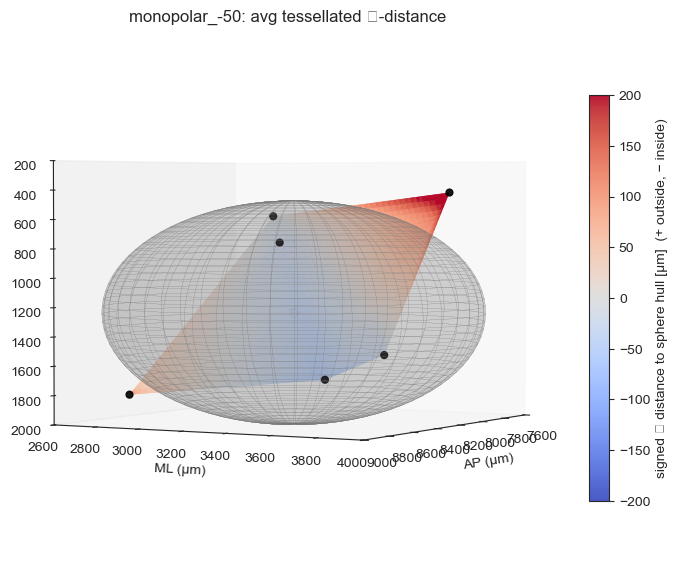

In [305]:
condition = 'monopolar_-50'

avg_pts, center_cond, r_bar, u_means = average_measured_hull_for_condition(points_dict, recordings, stim_points, condition, k=6, seed=0)
#r1, _ = plot_avg_hulls(condition, avg_pts, center_cond, show_sphere=True, show_sphere_hull=True,
#                       title=f'{condition}: avg hull + sphere')
r2 = plot_avg_tessellated_signed_perp(condition, avg_pts, center_cond, n_sub=30,
                                        show_sphere=True, show_sphere_hull=False,
                                        title=f'{condition}: avg tessellated ⟂-distance')
plt.gca().grid(False)
plt.gca().set_xlim([7600, 9000])
plt.gca().set_ylim([2600, 4000])
plt.gca().set_zlim([2000, 200])
plt.gca().view_init(elev=2, azim=30, roll=0)

In [40]:
for condition in points_dict.keys():
    print(condition)

bipolar_-25
bipolar_-50
bipolar_-100
bipolar_25
bipolar_50
bipolar_100
monopolar_-25
monopolar_-50
monopolar_-100
monopolar_5
monopolar_25
monopolar_50
monopolar_100


C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\3103170419.py:148: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  plt.tight_layout()
c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  func(*args, **kwargs)
c:\Users\jordan\AppData\Local\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


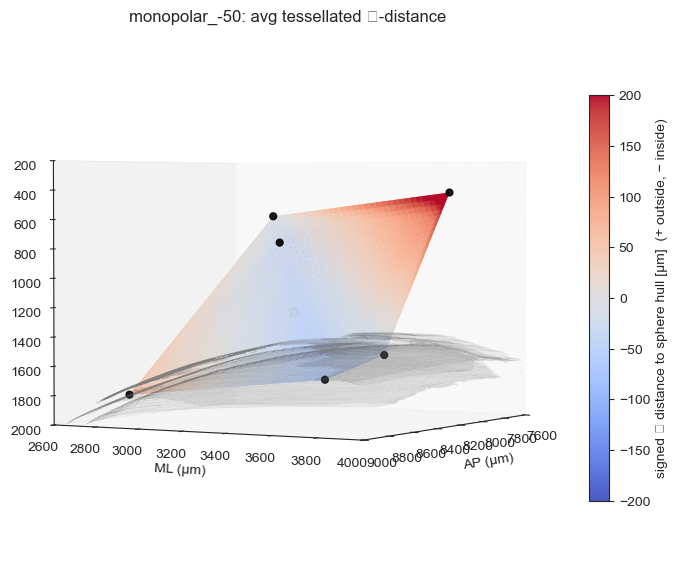

In [50]:
condition = 'monopolar_-50'

avg_pts, center_cond, r_bar, u_means = average_measured_hull_for_condition(points_dict, recordings, stim_points, condition, k=6, seed=0)
#r1, _ = plot_avg_hulls(condition, avg_pts, center_cond, show_sphere=True, show_sphere_hull=True,
#                       title=f'{condition}: avg hull + sphere')
r2 = plot_avg_tessellated_signed_perp(condition, avg_pts, center_cond, n_sub=30,
                                        show_sphere=False, show_sphere_hull=False,
                                        title=f'{condition}: avg tessellated ⟂-distance')


fig = plt.gcf()
ax = plt.gca()


ap_bounds = (760, 900); ml_bounds = (260, 400); dv_bounds = (20, 200)
plot_cc_isosurface(mask_cc, step=1, ap_bounds=ap_bounds, ml_bounds=ml_bounds, dv_bounds=dv_bounds, fig=fig, ax=ax)

plt.gca().grid(False)
plt.gca().set_xlim([7600, 9000])
plt.gca().set_ylim([2600, 4000])
plt.gca().set_zlim([2000, 200])
plt.gca().view_init(elev=2, azim=30, roll=0)

C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\3103170419.py:148: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  plt.tight_layout()
C:\Users\jordan\AppData\Local\Temp\ipykernel_54456\2207028917.py:22: UserWarning: Glyph 10178 (\N{PERPENDICULAR}) missing from font(s) Arial.
  plt.gcf().savefig(os.path.join(save_path, f'average_measured_hull_{condition}_nosphere_ccmask.pdf'))
INFO:fontTools.subset:maxp pruned
INFO:fontTools.subset:LTSH dropped
INFO:fontTools.subset:cmap pruned
INFO:fontTools.subset:kern dropped
INFO:fontTools.subset:post pruned
INFO:fontTools.subset:PCLT dropped
INFO:fontTools.subset:JSTF dropped
INFO:fontTools.subset:meta dropped
INFO:fontTools.subset:DSIG dropped
INFO:fontTools.subset:GPOS pruned
INFO:fontTools.subset:GSUB pruned
INFO:fontTools.subset:glyf pruned
INFO:fontTools.subset:Missing glyphs for requested Unicodes: ['U+27C2']
INFO:fontTools.subset:Added gid0 to subset
INFO:fontTools.subset:Added first four glyphs to subset
INFO:f

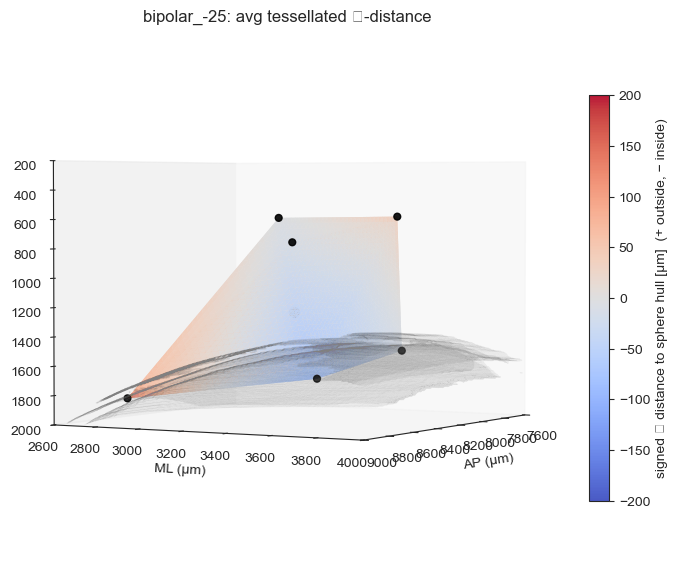

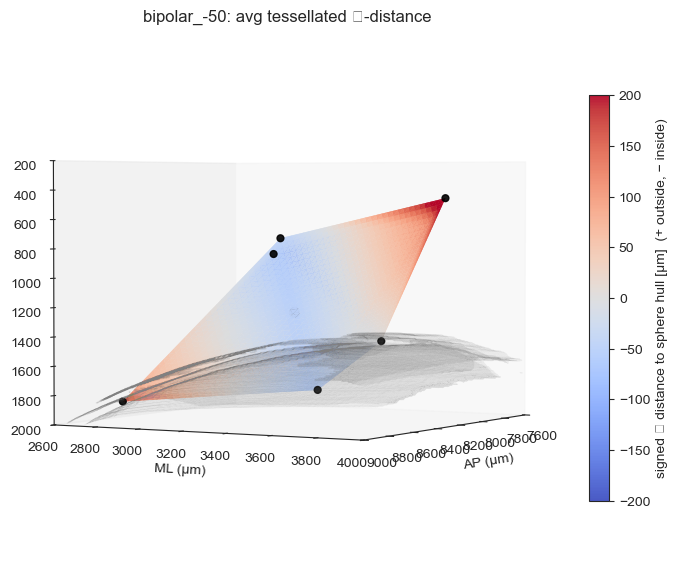

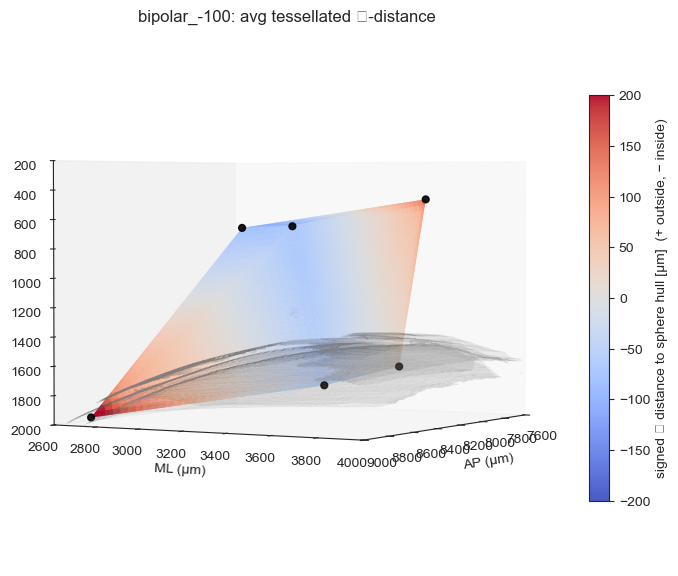

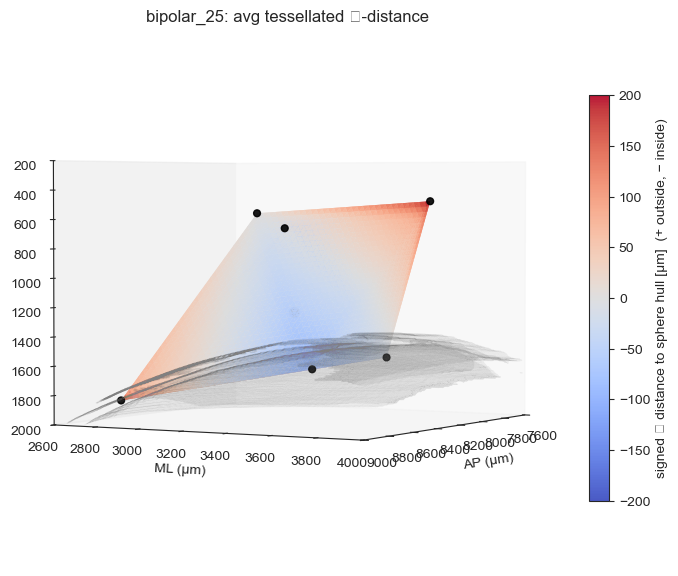

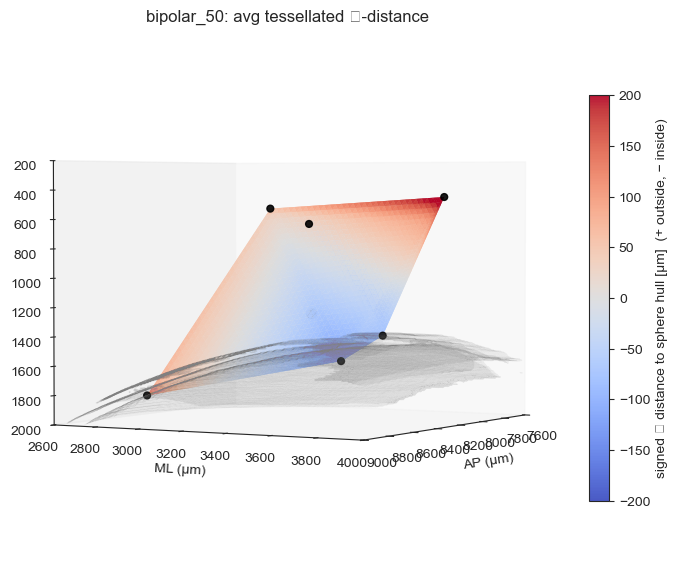

...

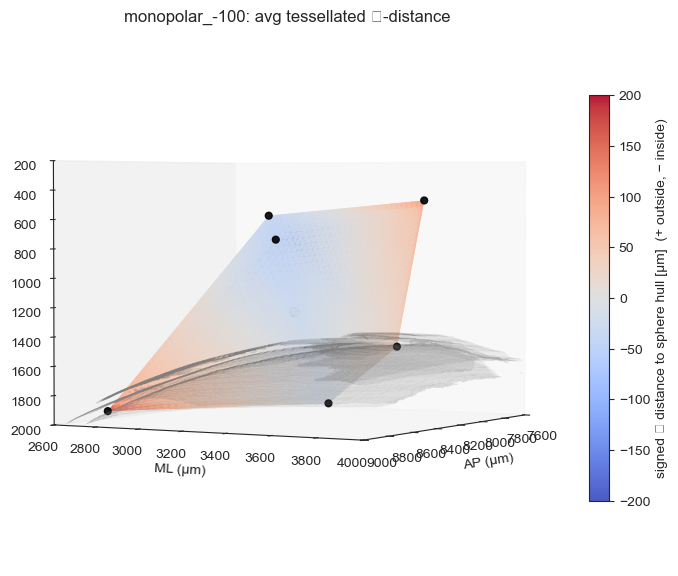

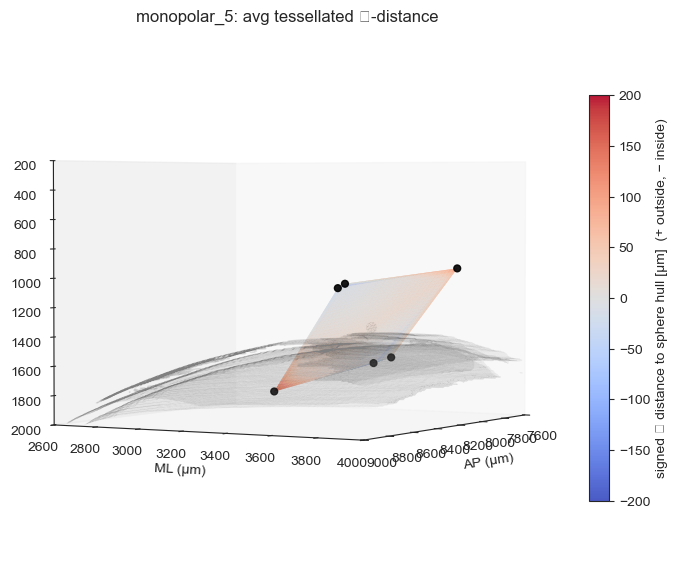

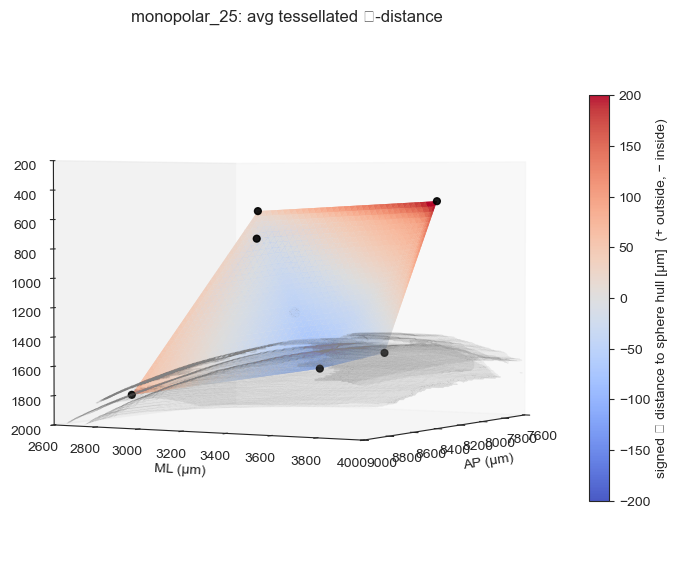

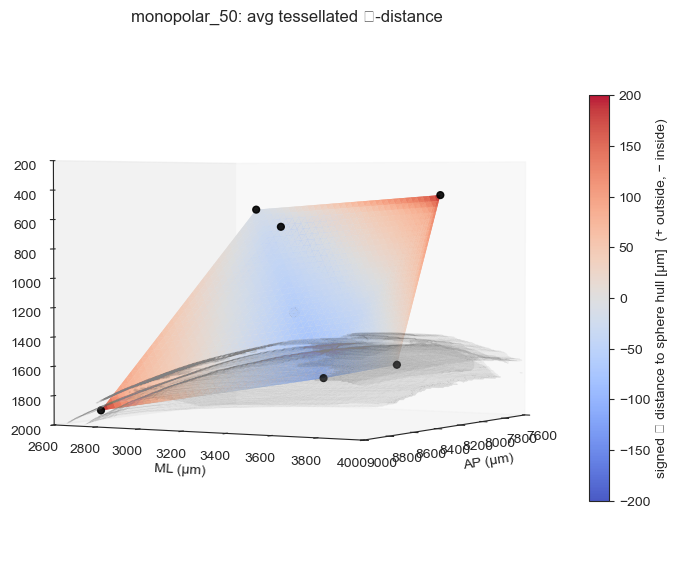

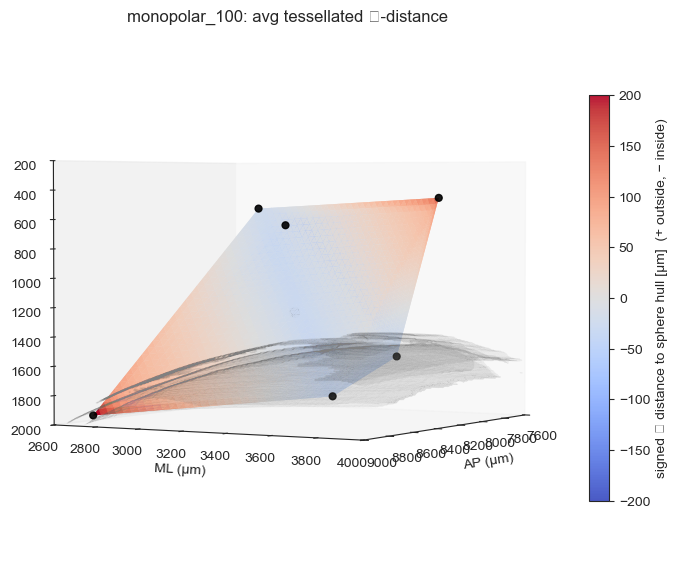

In [ ]:
save_path = r"C:\Users\jordan\Documents\combined_figs\anisotropy"
os.makedirs(save_path, exist_ok= True)
for condition in points_dict.keys():
    avg_pts, center_cond, r_bar, u_means = average_measured_hull_for_condition(points_dict, recordings, stim_points, condition, k=6, seed=0)
    #r1, _ = plot_avg_hulls(condition, avg_pts, center_cond, show_sphere=True, show_sphere_hull=True,
    #                       title=f'{condition}: avg hull + sphere')
    r2 = plot_avg_tessellated_signed_perp(condition, avg_pts, center_cond, n_sub=30,
                                          show_sphere=False, show_sphere_hull=False,
                                          title=f'{condition}: avg tessellated ⟂-distance')
    
    
    fig = plt.gcf()
    ax = plt.gca()

    ap_bounds = (760, 900); ml_bounds = (260, 400); dv_bounds = (20, 200)
    plot_cc_isosurface(mask_cc, step=1, ap_bounds=ap_bounds, ml_bounds=ml_bounds, dv_bounds=dv_bounds, fig=fig, ax=ax)
    plt.gca().grid(False)
    plt.gca().set_xlim([7600, 9000])
    plt.gca().set_ylim([2600, 4000])
    plt.gca().set_zlim([2000, 200])
    plt.gca().view_init(elev=2, azim=30, roll=0)
    #plt.gcf().savefig(os.path.join(save_path, f'average_measured_hull_{condition}_nosphere_ccmask.pdf'))
    #plt.gcf().savefig(os.path.join(save_path, f'average_measured_hull_{condition}_nosphere_ccmask.png'))

## metric of variance from symmetrical sphere

### is the measured potential symmetrical around the center of fit

In [28]:
point_distances = {}
sphere_variance_metric = {}
for condition, data in points_dict.items():
  for i,points in enumerate(data):
    pts_dist= []
    for j,point in enumerate(points):
      center = fit_dict[condition+'_'+str(i)][0:3]
      # print(str(point/10.)+'  '+str(center))
      pt_dist = np.linalg.norm(point-center) - fit_dict[condition+'_'+str(i)][-1]
      pts_dist.append(pt_dist)
      point_distances[condition+'_'+str(i)+'_pt'+str(j)] = pt_dist
    sphere_variance_metric[condition+'_'+str(i)] = np.mean(np.abs(pts_dist)) / fit_dict[condition+'_'+str(i)][-1]

Text(0.5, 0, 'asymmetry of evoked potential')

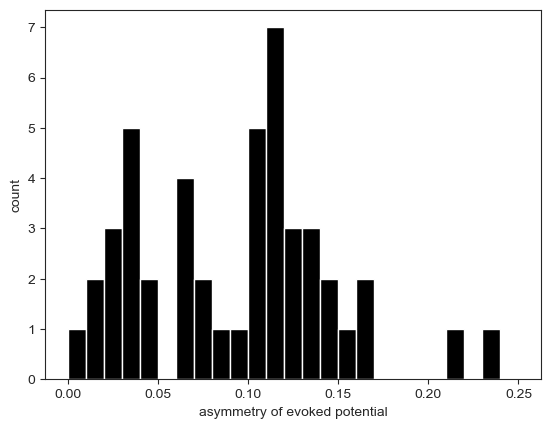

In [29]:
plt.hist(np.array(list(sphere_variance_metric.values())),bins=25,range=(0,.25),color='k')
plt.gca().set_ylabel('count')
plt.gca().set_xlabel('asymmetry of evoked potential')

<Axes: xlabel='amplitude', ylabel='asymmetry_sphere'>

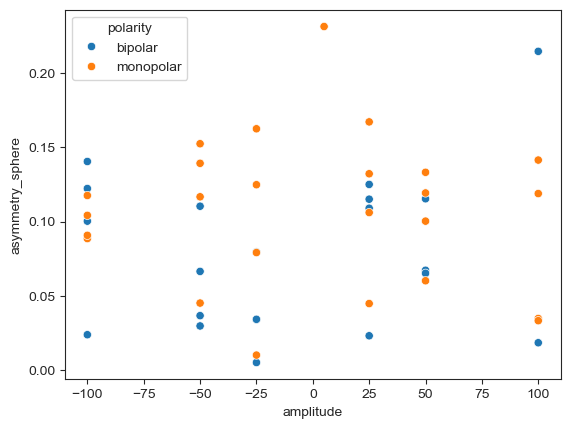

In [32]:
polarity,amplitude,epxt,asymmetry_sphere = [],[],[],[]
for key,value in sphere_variance_metric.items():
  polarity.append(key.split('_')[0])
  amplitude.append(int(key.split('_')[1]))
  epxt.append(key.split('_')[2])
  asymmetry_sphere.append(value)
df = pd.DataFrame({'polarity':polarity,'amplitude':amplitude,'epxt':epxt,'asymmetry_sphere':asymmetry_sphere})

sns.scatterplot(data=df,x='amplitude',y='asymmetry_sphere',hue='polarity')

## psudeocolor convex hull distance from sphere. or sphere distance from convex hull?

> Add blockquote


### is the asymmetry in a particular part of the field(s)?

In [45]:
from scipy.spatial import ConvexHull
import numpy
from numpy import dot
from math import sqrt
from matplotlib import cm

hull = ConvexHull(points) # points should be (6,3) array
volume = hull.volume

In [46]:
  r = fitted_params[3]  # Radius of the sphere
  phi, theta = np.mgrid[0.0:np.pi:100j, 0.0:2.0*np.pi:100j]
  x = r * np.sin(phi) * np.cos(theta)
  y = r * np.sin(phi) * np.sin(theta)
  z = r * np.cos(phi)

In [47]:
def pointTriangleDistance(TRI, P):
    # function [dist,PP0] = pointTriangleDistance(TRI,P)
    # calculate distance between a point and a triangle in 3D
    # SYNTAX
    #   dist = pointTriangleDistance(TRI,P)
    #   [dist,PP0] = pointTriangleDistance(TRI,P)
    #
    # DESCRIPTION
    #   Calculate the distance of a given point P from a triangle TRI.
    #   Point P is a row vector of the form 1x3. The triangle is a matrix
    #   formed by three rows of points TRI = [P1;P2;P3] each of size 1x3.
    #   dist = pointTriangleDistance(TRI,P) returns the distance of the point P
    #   to the triangle TRI.
    #   [dist,PP0] = pointTriangleDistance(TRI,P) additionally returns the
    #   closest point PP0 to P on the triangle TRI.
    #
    # Author: Gwolyn Fischer
    # Release: 1.0
    # Release date: 09/02/02
    # Release: 1.1 Fixed Bug because of normalization
    # Release: 1.2 Fixed Bug because of typo in region 5 20101013
    # Release: 1.3 Fixed Bug because of typo in region 2 20101014

    # Possible extention could be a version tailored not to return the distance
    # and additionally the closest point, but instead return only the closest
    # point. Could lead to a small speed gain.

    # Example:
    # %% The Problem
    # P0 = [0.5 -0.3 0.5]
    #
    # P1 = [0 -1 0]
    # P2 = [1  0 0]
    # P3 = [0  0 0]
    #
    # vertices = [P1; P2; P3]
    # faces = [1 2 3]
    #
    # %% The Engine
    # [dist,PP0] = pointTriangleDistance([P1;P2;P3],P0)
    #
    # %% Visualization
    # [x,y,z] = sphere(20)
    # x = dist*x+P0(1)
    # y = dist*y+P0(2)
    # z = dist*z+P0(3)
    #
    # figure
    # hold all
    # patch('Vertices',vertices,'Faces',faces,'FaceColor','r','FaceAlpha',0.8)
    # plot3(P0(1),P0(2),P0(3),'b*')
    # plot3(PP0(1),PP0(2),PP0(3),'*g')
    # surf(x,y,z,'FaceColor','b','FaceAlpha',0.3)
    # view(3)

    # The algorithm is based on
    # "David Eberly, 'Distance Between Point and Triangle in 3D',
    # Geometric Tools, LLC, (1999)"
    # http:\\www.geometrictools.com/Documentation/DistancePoint3Triangle3.pdf
    #
    #        ^t
    #  \     |
    #   \reg2|
    #    \   |
    #     \  |
    #      \ |
    #       \|
    #        *P2
    #        |\
    #        | \
    #  reg3  |  \ reg1
    #        |   \
    #        |reg0\
    #        |     \
    #        |      \ P1
    # -------*-------*------->s
    #        |P0      \
    #  reg4  | reg5    \ reg6
    # rewrite triangle in normal form
    B = TRI[0, :]
    E0 = TRI[1, :] - B
    # E0 = E0/sqrt(sum(E0.^2)); %normalize vector
    E1 = TRI[2, :] - B
    # E1 = E1/sqrt(sum(E1.^2)); %normalize vector
    D = B - P
    a = dot(E0, E0)
    b = dot(E0, E1)
    c = dot(E1, E1)
    d = dot(E0, D)
    e = dot(E1, D)
    f = dot(D, D)

    #print "{0} {1} {2} ".format(B,E1,E0)
    det = a * c - b * b
    s = b * e - c * d
    t = b * d - a * e

    # Terible tree of conditionals to determine in which region of the diagram
    # shown above the projection of the point into the triangle-plane lies.
    if (s + t) <= det:
        if s < 0.0:
            if t < 0.0:
                # region4
                if d < 0:
                    t = 0.0
                    if -d >= a:
                        s = 1.0
                        sqrdistance = a + 2.0 * d + f
                    else:
                        s = -d / a
                        sqrdistance = d * s + f
                else:
                    s = 0.0
                    if e >= 0.0:
                        t = 0.0
                        sqrdistance = f
                    else:
                        if -e >= c:
                            t = 1.0
                            sqrdistance = c + 2.0 * e + f
                        else:
                            t = -e / c
                            sqrdistance = e * t + f

                            # of region 4
            else:
                # region 3
                s = 0
                if e >= 0:
                    t = 0
                    sqrdistance = f
                else:
                    if -e >= c:
                        t = 1
                        sqrdistance = c + 2.0 * e + f
                    else:
                        t = -e / c
                        sqrdistance = e * t + f
                        # of region 3
        else:
            if t < 0:
                # region 5
                t = 0
                if d >= 0:
                    s = 0
                    sqrdistance = f
                else:
                    if -d >= a:
                        s = 1
                        sqrdistance = a + 2.0 * d + f;  # GF 20101013 fixed typo d*s ->2*d
                    else:
                        s = -d / a
                        sqrdistance = d * s + f
            else:
                # region 0
                invDet = 1.0 / det
                s = s * invDet
                t = t * invDet
                sqrdistance = s * (a * s + b * t + 2.0 * d) + t * (b * s + c * t + 2.0 * e) + f
    else:
        if s < 0.0:
            # region 2
            tmp0 = b + d
            tmp1 = c + e
            if tmp1 > tmp0:  # minimum on edge s+t=1
                numer = tmp1 - tmp0
                denom = a - 2.0 * b + c
                if numer >= denom:
                    s = 1.0
                    t = 0.0
                    sqrdistance = a + 2.0 * d + f;  # GF 20101014 fixed typo 2*b -> 2*d
                else:
                    s = numer / denom
                    t = 1 - s
                    sqrdistance = s * (a * s + b * t + 2 * d) + t * (b * s + c * t + 2 * e) + f

            else:  # minimum on edge s=0
                s = 0.0
                if tmp1 <= 0.0:
                    t = 1
                    sqrdistance = c + 2.0 * e + f
                else:
                    if e >= 0.0:
                        t = 0.0
                        sqrdistance = f
                    else:
                        t = -e / c
                        sqrdistance = e * t + f
                        # of region 2
        else:
            if t < 0.0:
                # region6
                tmp0 = b + e
                tmp1 = a + d
                if tmp1 > tmp0:
                    numer = tmp1 - tmp0
                    denom = a - 2.0 * b + c
                    if numer >= denom:
                        t = 1.0
                        s = 0
                        sqrdistance = c + 2.0 * e + f
                    else:
                        t = numer / denom
                        s = 1 - t
                        sqrdistance = s * (a * s + b * t + 2.0 * d) + t * (b * s + c * t + 2.0 * e) + f

                else:
                    t = 0.0
                    if tmp1 <= 0.0:
                        s = 1
                        sqrdistance = a + 2.0 * d + f
                    else:
                        if d >= 0.0:
                            s = 0.0
                            sqrdistance = f
                        else:
                            s = -d / a
                            sqrdistance = d * s + f
            else:
                # region 1
                numer = c + e - b - d
                if numer <= 0:
                    s = 0.0
                    t = 1.0
                    sqrdistance = c + 2.0 * e + f
                else:
                    denom = a - 2.0 * b + c
                    if numer >= denom:
                        s = 1.0
                        t = 0.0
                        sqrdistance = a + 2.0 * d + f
                    else:
                        s = numer / denom
                        t = 1 - s
                        sqrdistance = s * (a * s + b * t + 2.0 * d) + t * (b * s + c * t + 2.0 * e) + f

    # account for numerical round-off error
    if sqrdistance < 0:
        sqrdistance = 0

    dist = sqrt(sqrdistance)

    PP0 = B + s * E0 + t * E1
    return dist, PP0

In [48]:
distances = np.ones(np.shape(x))
print(fitted_params)
for iy, ix in np.ndindex(distances.shape):

  distas = []
  for i in range(8):
    # print('simplex '+str(i))
    # for j in range(3):
    pt = [x[iy,ix]+fitted_params[0],y[iy,ix]+fitted_params[1],z[iy,ix]+fitted_params[2]]
    simplex = hull.points[hull.simplices[i, :3], :]
    # print(simplex)
    # print(pt)
    dista = pointTriangleDistance(simplex, pt)
    distas.append(dista[0])
    distances[iy,ix]=np.mean(np.array(distas))

[8394.64664098 2795.33163644 1433.70619902 1157.87039332]


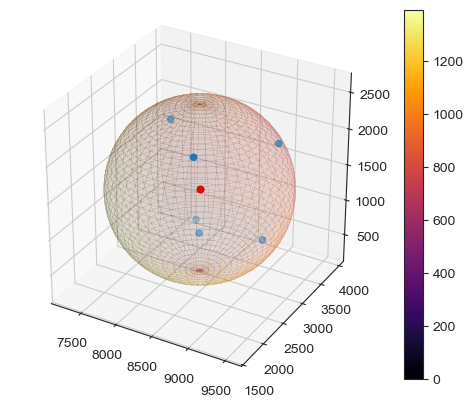

In [49]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Make surface data
r = fitted_params[3]  # Radius of the sphere
phi, theta = np.mgrid[0.0:np.pi:100j, 0.0:2.0*np.pi:100j]
x = r * np.sin(phi) * np.cos(theta)
y = r * np.sin(phi) * np.sin(theta)
z = r * np.cos(phi)

# Plot the surface
# C = np.linspace(-5, 5, Z.size).reshape(Z.shape)
scamap = plt.cm.ScalarMappable(cmap='inferno')
scamap.set_clim(0,np.max(distances))
fcolors = scamap.to_rgba(distances)
# ax.plot_surface(X, Y, Z, facecolors=fcolors, cmap='inferno')

ax.plot_surface(x+fitted_params[0], y+fitted_params[1], z+fitted_params[2],alpha=0.1,facecolors=fcolors,
                       linewidth=0, antialiased=False)
fig.colorbar(scamap,ax=ax)

#plot the points
ax.scatter(points[:,0],points[:,1],points[:,2])
ax.scatter(center[0],center[1],center[2],color='k') # data center of mass
ax.scatter(fitted_params[0],fitted_params[1],fitted_params[2],color='r') # fitted center
# ax.scatter(a_opt,b_opt,c_opt,color='r')

# poly = Poly3DCollection(points/10., alpha=.1)
# ax.add_collection3d(poly)

# Set an equal aspect ratio
ax.set_aspect('equal')

plt.show()

In [52]:
def show_fit_with_distance(points,center,fitted_params, title = ''):
  fig = plt.figure()
  ax = fig.add_subplot(projection='3d')

  # Make surface data
  r = fitted_params[3]  # Radius of the sphere
  phi, theta = np.mgrid[0.0:np.pi:100j, 0.0:2.0*np.pi:100j]
  x = r * np.sin(phi) * np.cos(theta)
  y = r * np.sin(phi) * np.sin(theta)
  z = r * np.cos(phi)

  distances = np.ones(np.shape(x))
  print(fitted_params)
  for iy, ix in np.ndindex(distances.shape):

    distas = []
    for i in range(8):
      # print('simplex '+str(i))
      # for j in range(3):
      pt = [x[iy,ix]+fitted_params[0],y[iy,ix]+fitted_params[1],z[iy,ix]+fitted_params[2]]
      simplex = hull.points[hull.simplices[i, :3], :]
      # print(simplex)
      # print(pt)
      dista = pointTriangleDistance(simplex, pt)
      distas.append(dista[0])
      distances[iy,ix]=np.mean(np.array(distas))

  # Plot the surface
  # C = np.linspace(-5, 5, Z.size).reshape(Z.shape)
  scamap = plt.cm.ScalarMappable(cmap='inferno')
  scamap.set_clim(0,np.max(distances))
  fcolors = scamap.to_rgba(distances)
  # ax.plot_surface(X, Y, Z, facecolors=fcolors, cmap='inferno')

  ax.plot_surface(x+fitted_params[0], y+fitted_params[1], z+fitted_params[2],alpha=0.1,facecolors=fcolors,
                        linewidth=0, antialiased=False)
  fig.colorbar(scamap,ax=ax)

  #plot the points
  ax.scatter(points[:,0],points[:,1],points[:,2])
  ax.scatter(center[0],center[1],center[2],color='k') # data center of mass
  ax.scatter(fitted_params[0],fitted_params[1],fitted_params[2],color='r') # fitted center
  # ax.scatter(a_opt,b_opt,c_opt,color='r')

  # poly = Poly3DCollection(points/10., alpha=.1)
  # ax.add_collection3d(poly)

  # Set an equal aspect ratio
  ax.set_aspect('equal')
  ax.set_xlabel('ap')
  ax.set_ylabel('ml')
  ax.set_zlabel('dv')
  ax.invert_zaxis()
  
  plt.title(title)
  plt.tight_layout()
  plt.show()

In [51]:
recordings

{'bipolar_-25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_-50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_-100': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_50': ['jlh31', 'jlh32', 'jlh34'],
 'bipolar_100': ['jlh32', 'jlh48'],
 'monopolar_-25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_-50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_-100': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_5': ['jlh32'],
 'monopolar_25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_100': ['jlh31', 'jlh32', 'jlh34', 'jlh48']}

[8664.56414034 3291.17026433 1475.78582434  834.41368148]


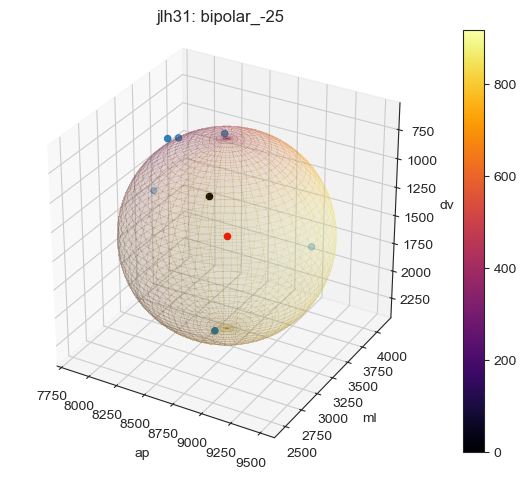

[7826.27442375 3762.27438322  850.42710674  825.64835972]


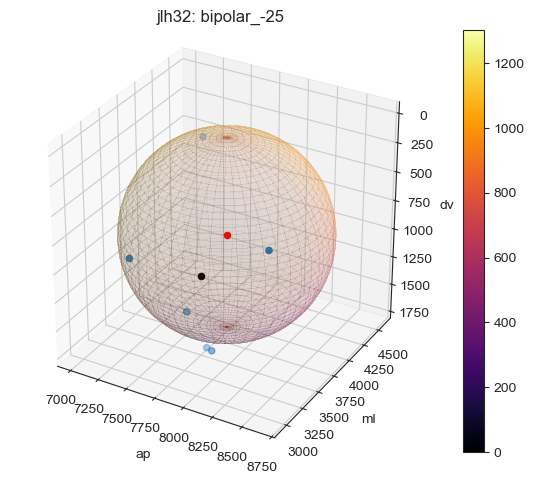

[8364.7768974  2497.89933749 1049.30772943 1033.10927099]


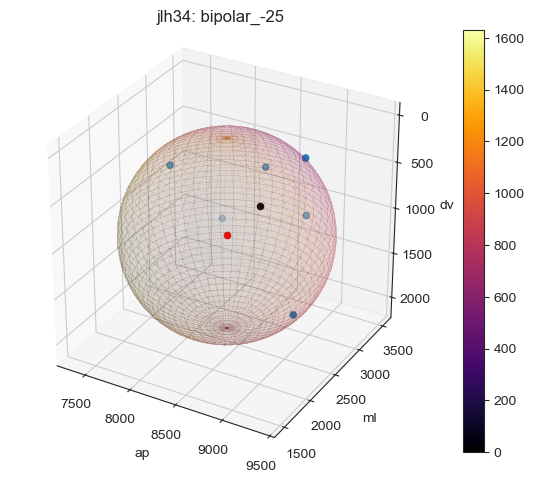

[8336.71836408 2811.43613167 1192.48467508  990.57802813]


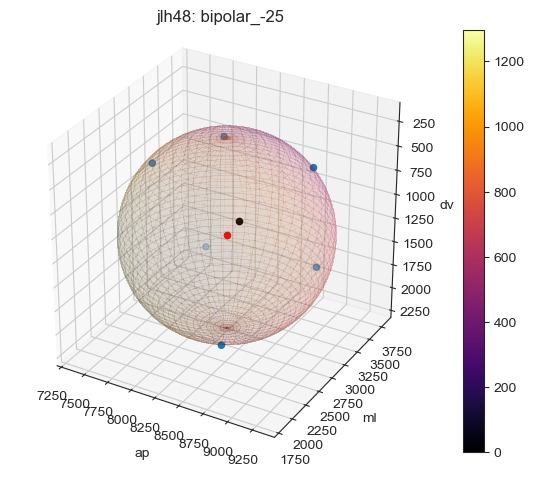

[8476.42073603 3162.8335837  1385.28120956  875.27012376]


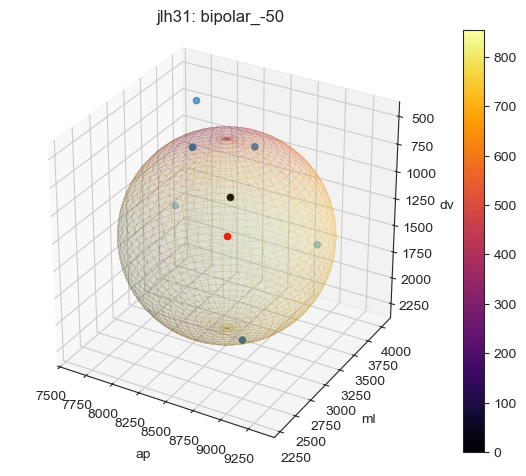

[7989.3788149  4014.9108717  1029.37065672  952.2221684 ]


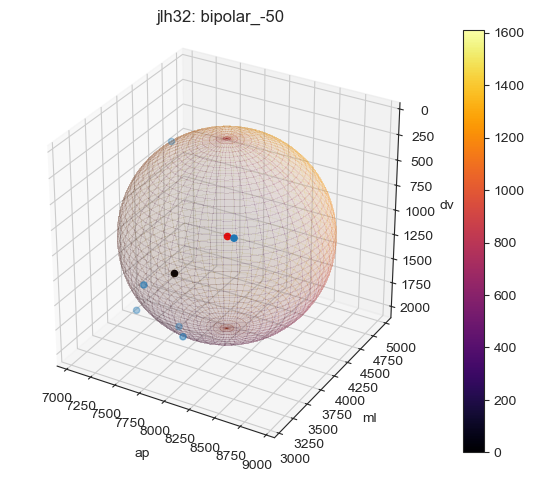

[7970.16685631 1252.76595205  294.57689332 2306.00489886]


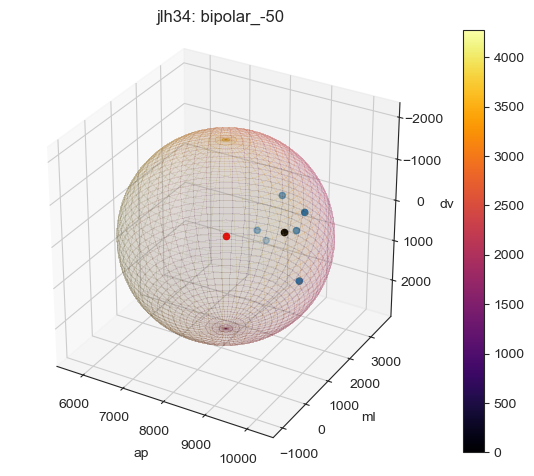

[8414.8600305  2872.3684485  1223.16245435  966.4496693 ]


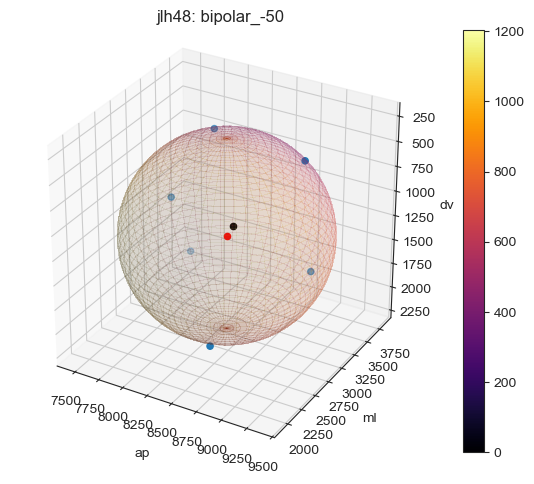

[8490.02927931 3088.66876035 1311.43914795  876.13959863]


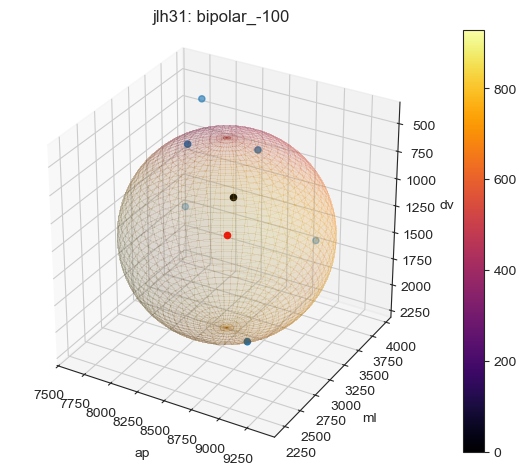

[7698.86918879 3742.70845169 1195.80435595 1021.3082153 ]


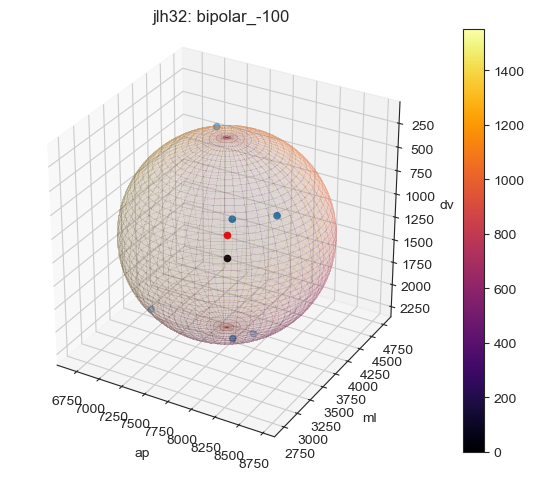

[8346.85310706 2769.12271863 1248.62437855  837.21675148]


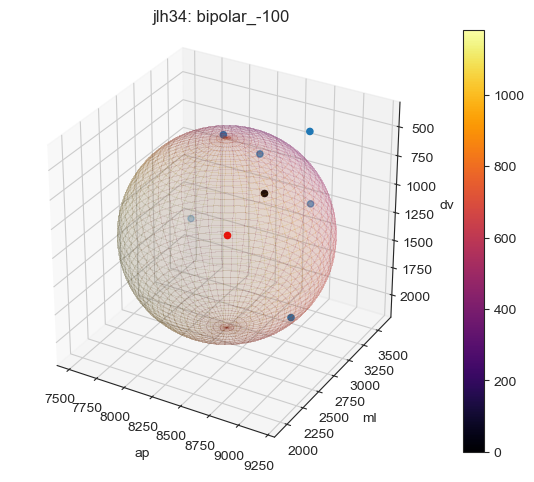

[7717.17768549 2246.00534687 1295.22218352 1498.99798942]


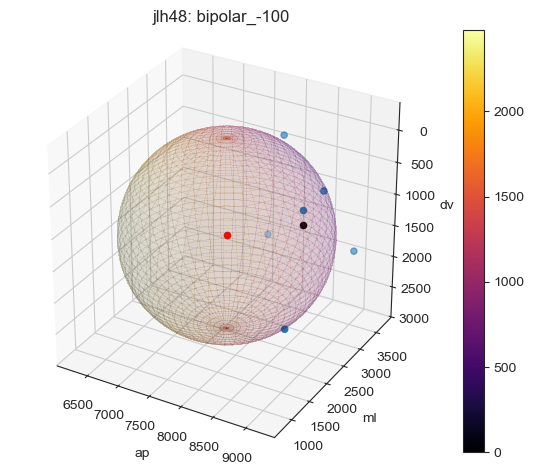

[8394.65968976 3157.54441191 1273.10053586  782.56164249]


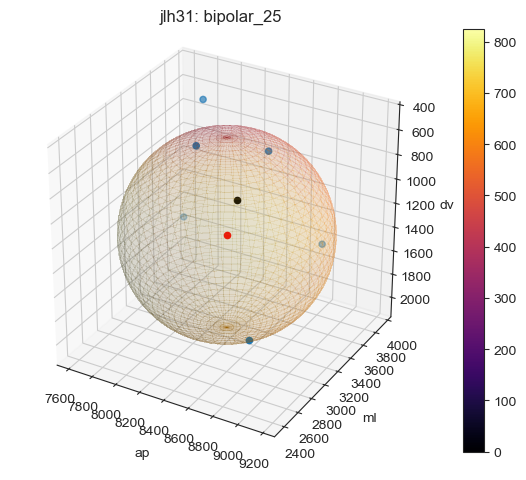

[7704.51124276 3731.65117384 1110.92585611  938.99751979]


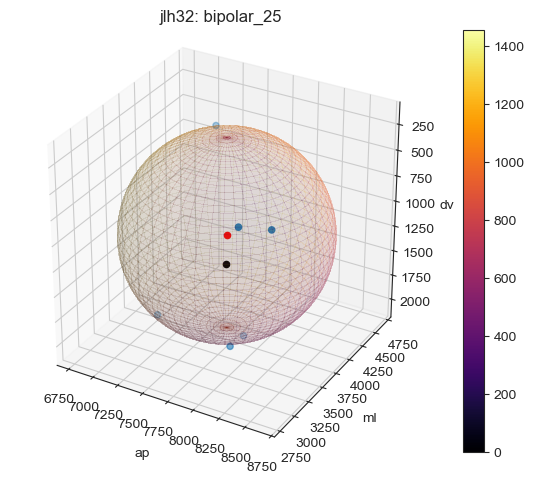

[8407.68563359 2815.6118965  1176.89217795  796.06404765]


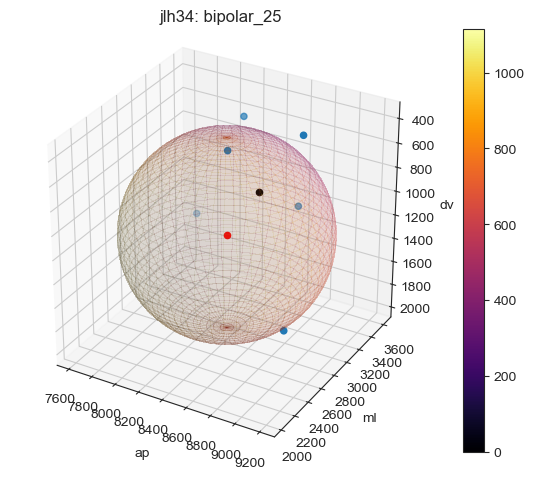

[8391.94149997 2881.16254957 1339.6407538   942.01637121]


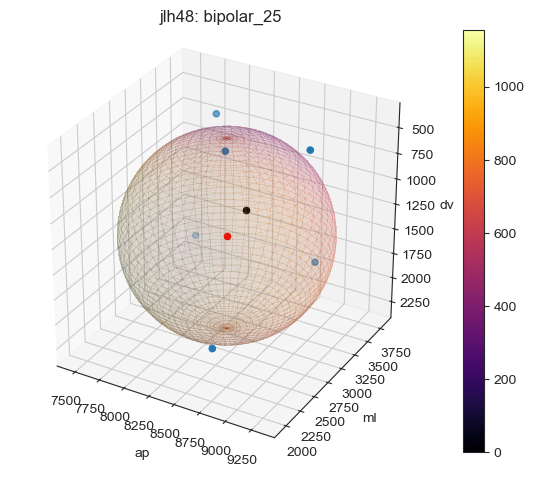

[8413.31162409 3083.72913376 1214.96254812  779.64356433]


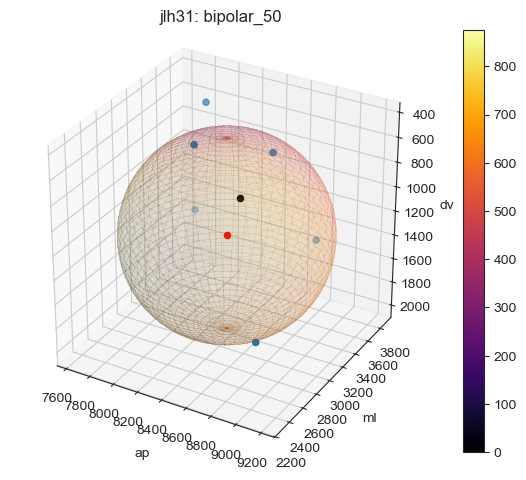

[7717.07200578 3687.21001258 1075.52914286  936.18780204]


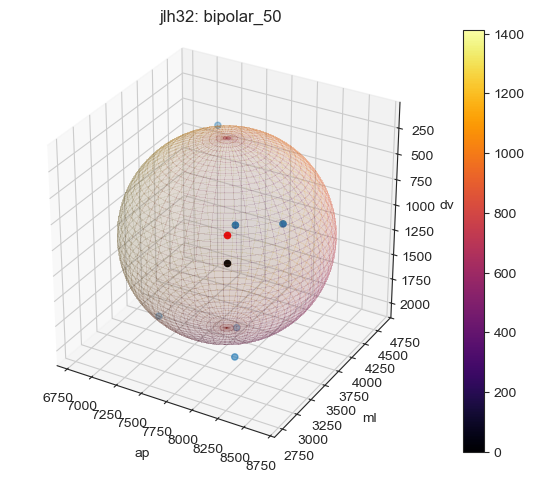

[8601.67928418 2703.6295994  1034.16698445  865.33709928]


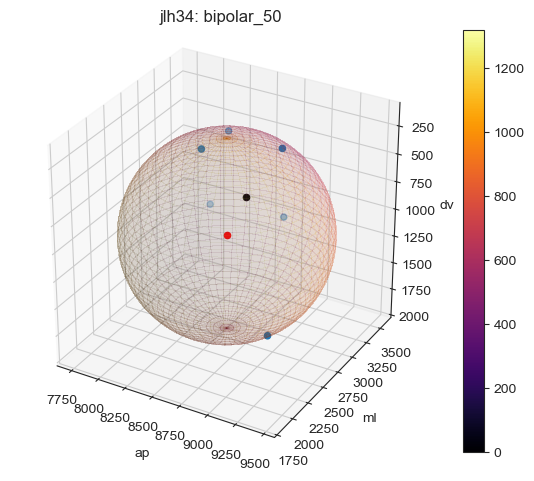

[7928.73381613 3935.89518159 1205.71975277 1049.68765642]


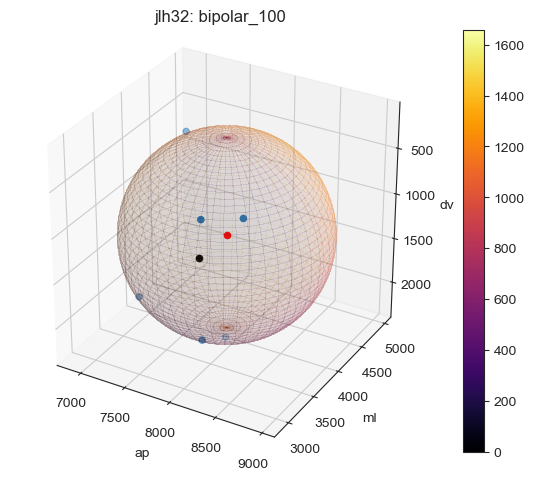

[8277.65604119 2925.15940934 1532.39467426 1112.39815134]


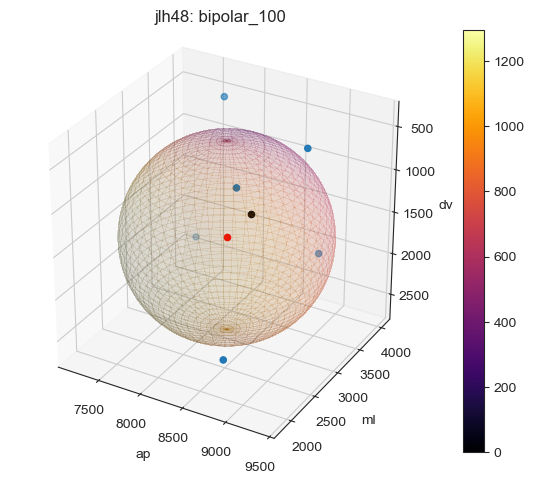

[8376.02048791 3176.00366323 1222.22853167  595.16852632]


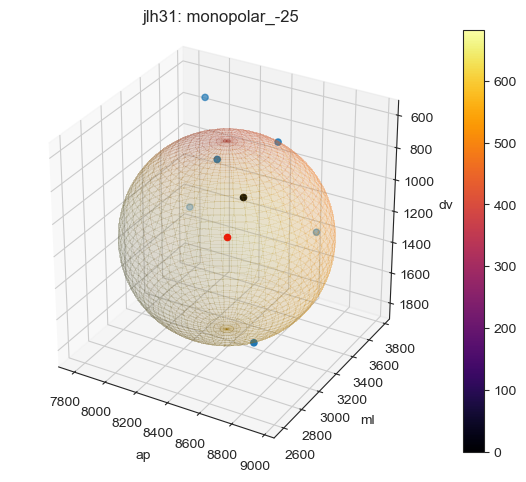

[7769.66288968 3645.27777997  947.83168943  816.48473142]


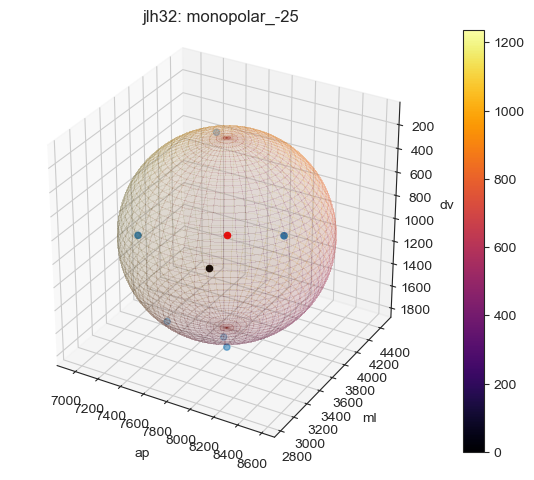

[8499.89525202 2738.36364681 1211.75862056  783.24695184]


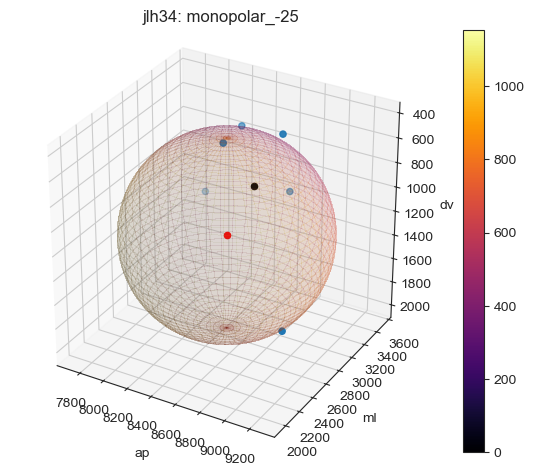

[8310.39927349 3053.03760371 1325.32751369  884.05901218]


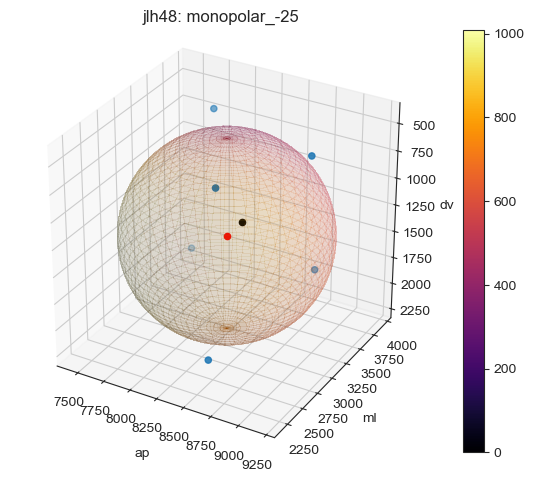

[8409.82393309 3145.29748474 1216.50538896  716.14669765]


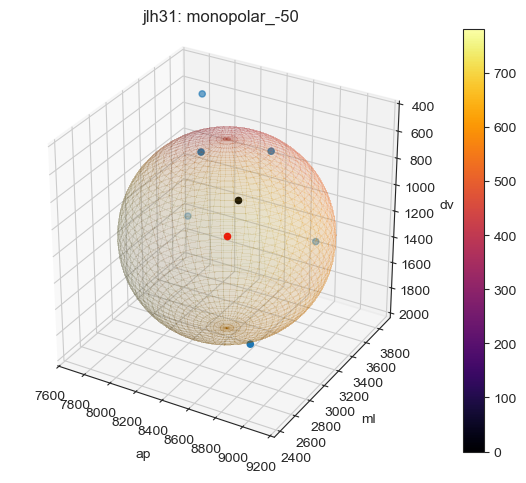

[7970.6536333  4082.85965536 1149.87646265 1037.74575253]


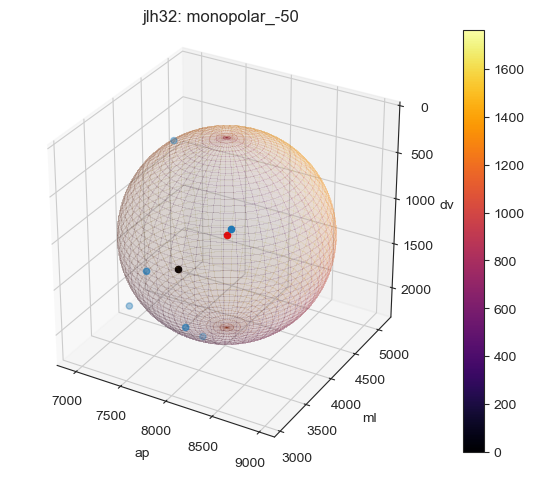

[8369.60857754 2991.43793599 1190.46888974  790.26112547]


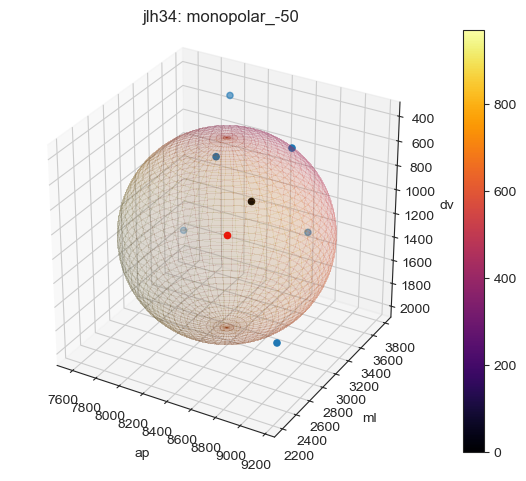

[8393.2356107  3014.73167743 1363.29004504  977.88869112]


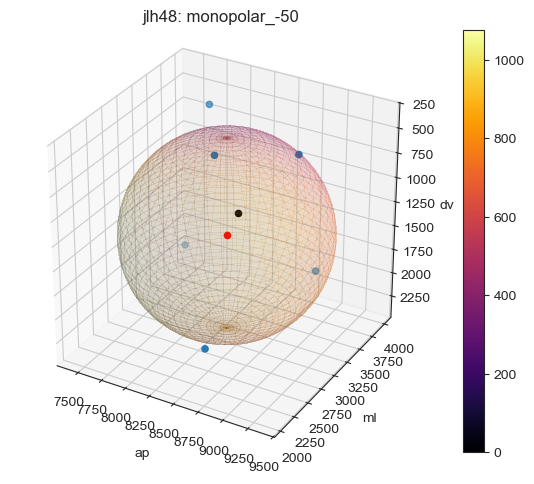

[8448.16392101 3043.67407803 1295.64403778  875.07636084]


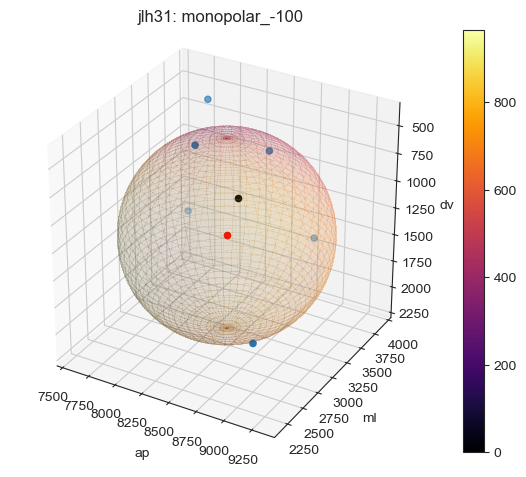

[7810.06195584 4053.54788862 1238.45081267 1064.051932  ]


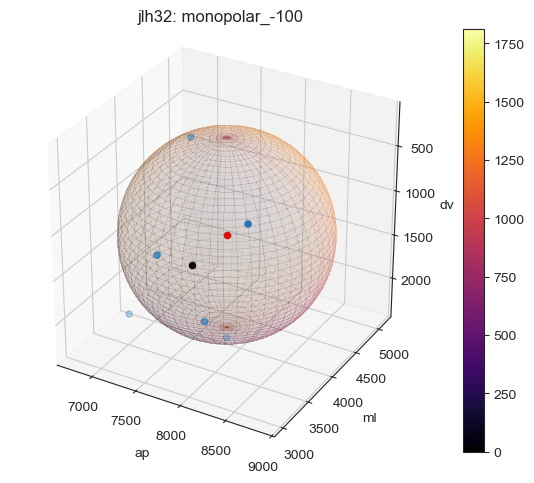

[8443.4824464  3135.53224191 1457.46129651  855.05582331]


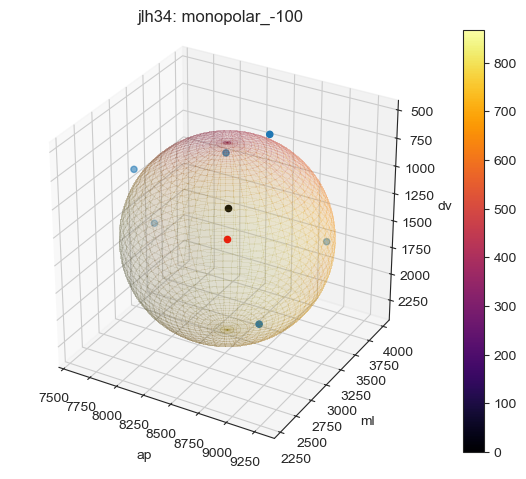

[8389.3953088  2795.19576775 1279.16973833 1135.01304918]


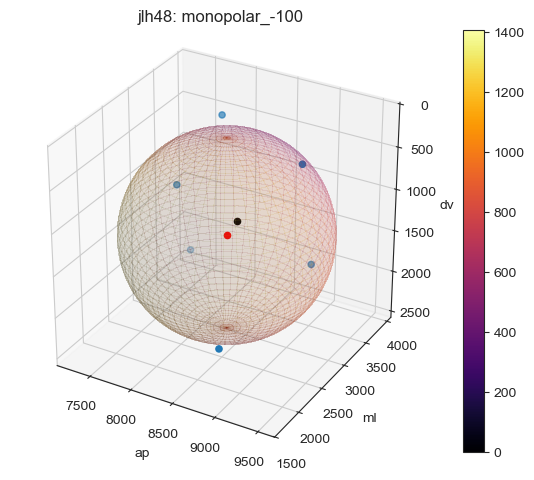

[7788.47646766 3389.05679318 1377.52452634  444.119092  ]


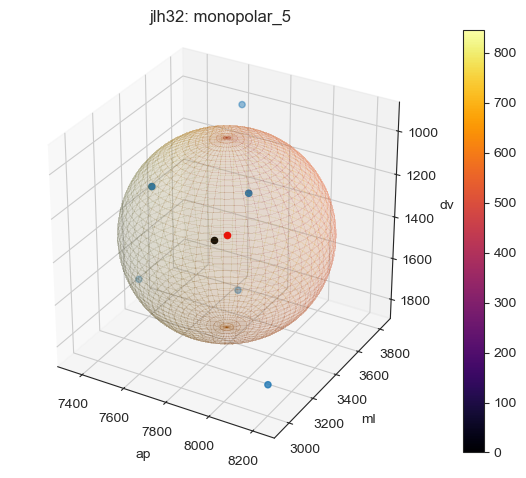

[8389.06701476 3119.23468894 1165.68974669  701.47113024]


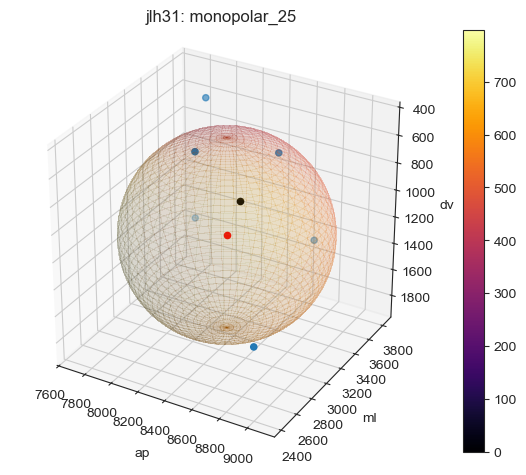

[7757.17481107 3732.79716419 1115.94747547  956.21983869]


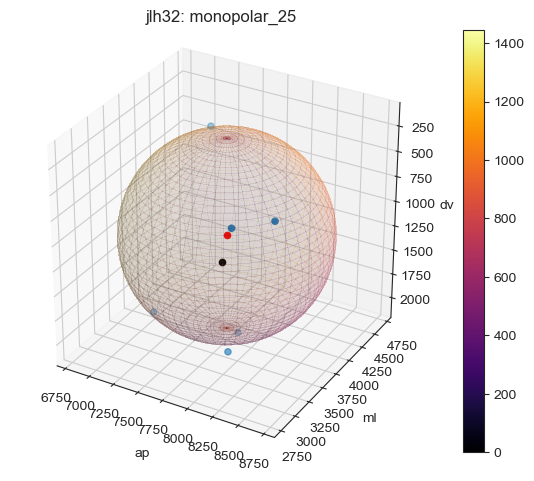

[8463.34976859 2897.02219248 1191.07302654  766.28011485]


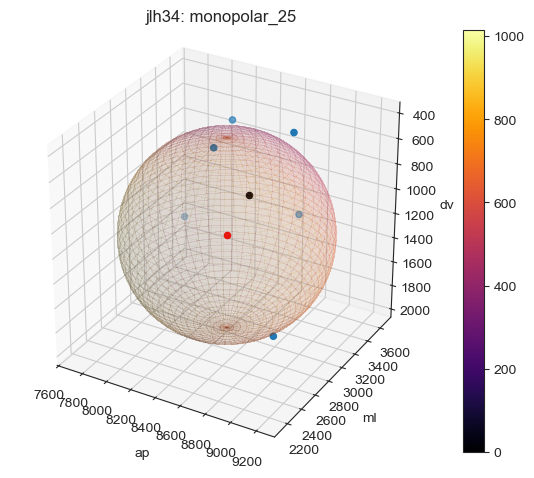

[8342.52568386 3253.01752288 1315.90950136  864.06003055]


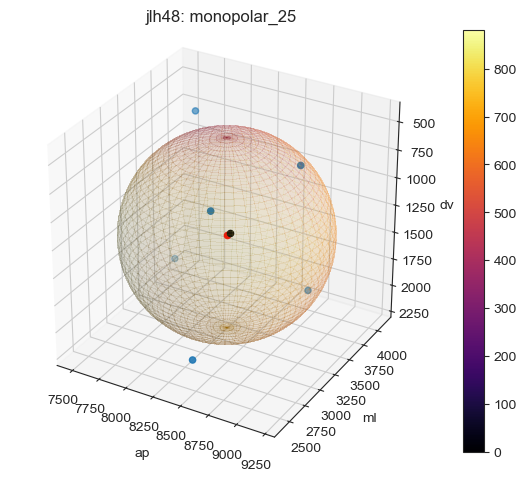

[8299.29913976 3149.48860536 1229.96918271  756.94393548]


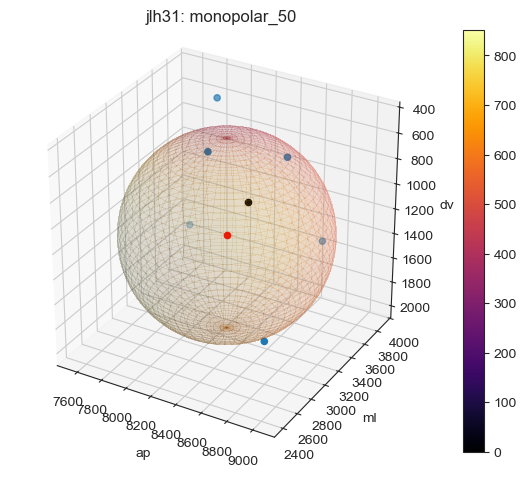

[7724.56352396 3685.81296999 1165.68025618  987.63206822]


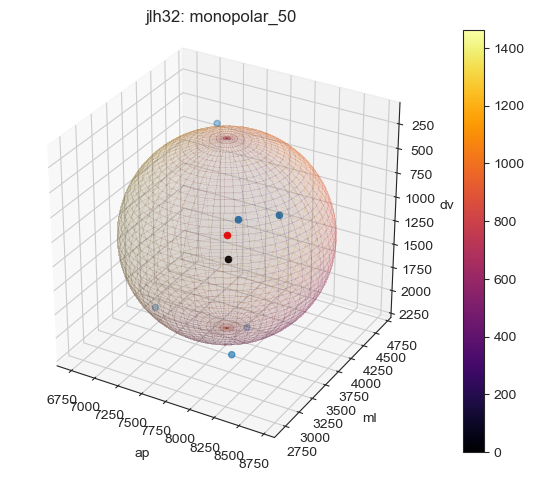

[8452.25070754 2948.47239482 1213.92156082  764.59833993]


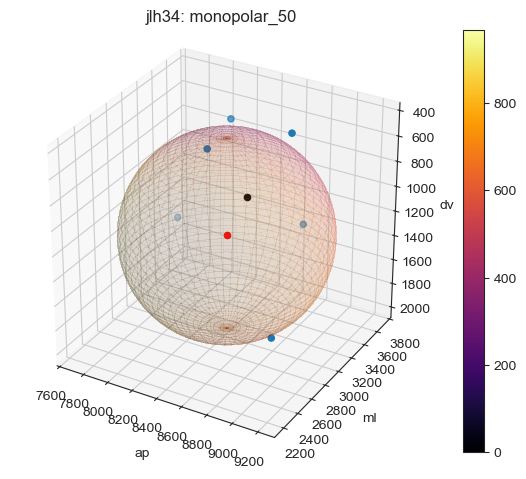

[8355.19844288 2807.98817456 1424.69344502 1132.44757102]


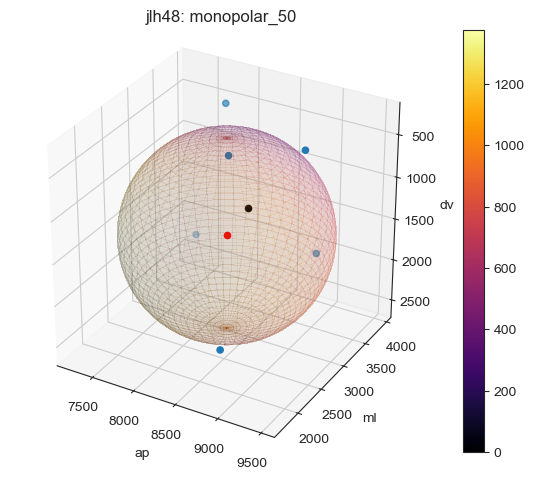

[8420.93665666 3081.86027389 1172.64214514  751.95008212]


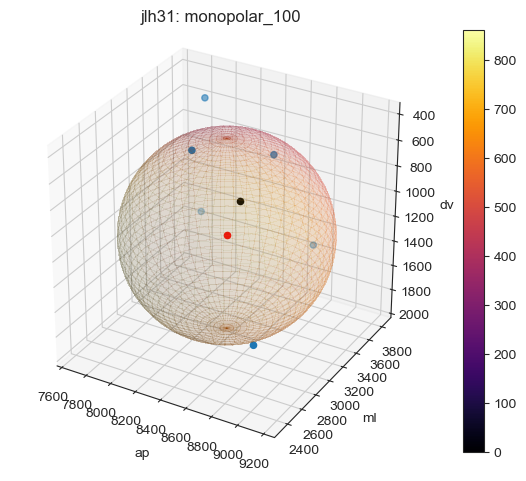

[7811.95776362 3796.81529885 1231.01297502 1048.77842955]


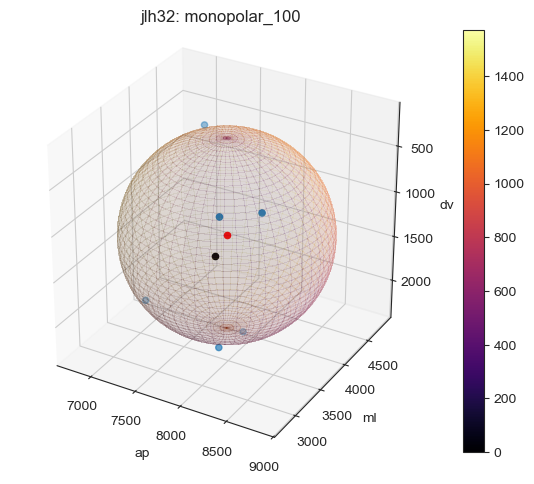

[8574.58223641 3046.92781485 1271.38672093  791.17874371]


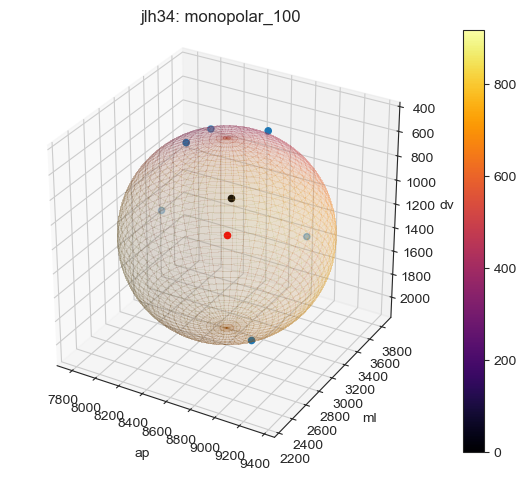

[8394.64664098 2795.33163644 1433.70619902 1157.87039332]


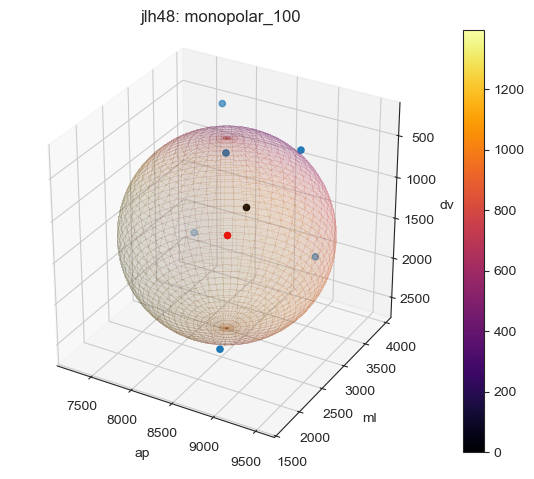

In [54]:
  for condition, data in points_dict.items():
    for i,points in enumerate(data):
    
      rec = recordings[condition][i]
      title = f'{rec}: {condition}'
      # #generate a center guess from the center of mass
      center = center_of_mass_3d(points,np.ones(np.shape(points)[0]))

      # # Initial guess for parameters (center at origin, radius 1)
      # initial_guess = [center[0], center[1], center[2], 50.] # 100 is a hard coded radius guess, which is scaled by a factor 10, so really 1000um = 1mm

      # # Perform the least squares fit
      # result = least_squares(sphere_residuals, initial_guess, args=((points[:,0]/10.,points[:,1]/10.,points[:,2]/10.),))
      # result_fixed = least_squares(sphere_residuals, initial_guess, args=((points[:,0]/10.,points[:,1]/10.,points[:,2]/10.),))

      # # Extract the fitted parameters (center coordinates and radius)
      # fitted_params = result.x
      # fitted_x0, fitted_y0, fitted_z0, fitted_r = fitted_params

      # fit_dict[condition+'_'+str(i)] = fitted_params

      fitted_params = fit_dict[condition+'_'+str(i)]
      show_fit_with_distance(points, center, fitted_params, title = title)

In [106]:
recordings

{'bipolar_-25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_-50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_-100': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'bipolar_50': ['jlh31', 'jlh32', 'jlh34'],
 'bipolar_100': ['jlh32', 'jlh48'],
 'monopolar_-25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_-50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_-100': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_5': ['jlh32'],
 'monopolar_25': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_50': ['jlh31', 'jlh32', 'jlh34', 'jlh48'],
 'monopolar_100': ['jlh31', 'jlh32', 'jlh34', 'jlh48']}

In [143]:
def align_fits(condition, data):
    avg_distances = []
    avg_x = []
    avg_y = []
    avg_z = []
    avg_r = [] 
    
    for i,points in enumerate(data):
        #generate a center guess from the center of mass
        rec = recordings[condition][i]
        center = stim_points[f'{rec}_{condition}'] # use the ccf coordinate of the stim contact
        #center = center_of_mass_3d(points/10.,np.ones(np.shape(points)[0]))

        #fit (repeat)
        initial_guess = [center[0], center[1], center[2], 500.] # 500

        # Perform the least squares fit
        result = least_squares(sphere_residuals, initial_guess, args=((points[:,0],points[:,1],points[:,2]),))
        # result_fixed = least_squares(sphere_residuals_fixed, initial_guess, args=((points[:,0]/10.,points[:,1]/10.,points[:,2]/10.),))

        # Extract the fitted parameters (center coordinates and radius)
        fitted_params = result.x
        fitted_x0, fitted_y0, fitted_z0, fitted_r = fitted_params

        # Make surface data
        r = fitted_params[3]  # Radius of the sphere
        phi, theta = np.mgrid[0.0:np.pi:100j, 0.0:2.0*np.pi:100j]
        x = r * np.sin(phi) * np.cos(theta)
        y = r * np.sin(phi) * np.sin(theta)
        z = r * np.cos(phi)

        avg_x.append(x)
        avg_y.append(y)
        avg_z.append(z)
        avg_r.append(r)
        
        distances = np.ones(np.shape(x))
        # print(fitted_params)
        for iy, ix in np.ndindex(distances.shape):
            distas = []
            for i in range(8):
                # print('simplex '+str(i))
                # for j in range(3):
                pt = [x[iy,ix]+fitted_params[0],y[iy,ix]+fitted_params[1],z[iy,ix]+fitted_params[2]]
                simplex = hull.points[hull.simplices[i, :3], :]
                # print(simplex)
                # print(pt)
                dista = pointTriangleDistance(simplex, pt)
                distas.append(dista[0])
                distances[iy,ix]=np.mean(np.array(distas))

        avg_distances.append(distances)
    dist_mean = np.mean(avg_distances, axis = 0 )
    return {
        "dist": np.mean(np.array(avg_distances),axis=0),   # (N,N)
        "X": np.mean(np.array(avg_x),axis=0),              # (N,N)
        "Y": np.mean(np.array(avg_y),axis=0),              # (N,N)
        "Z": np.mean(np.array(avg_z),axis=0),              # (N,N)
        "r": np.mean(np.array(avg_r))         # float
            }

In [147]:
avg_results.keys()

dict_keys(['bipolar_-25', 'bipolar_-50', 'bipolar_-100', 'bipolar_25', 'bipolar_50', 'bipolar_100', 'monopolar_-25', 'monopolar_-50', 'monopolar_-100', 'monopolar_5', 'monopolar_25', 'monopolar_50', 'monopolar_100'])

In [144]:
  avg_distances = {}
  for condition, data in points_dict.items():
    avg_results[condition] = align_fits(condition, data)

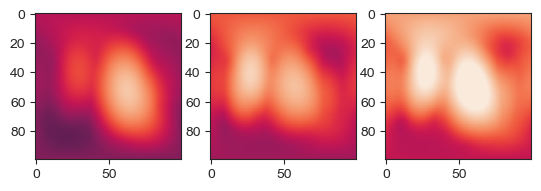

In [148]:
f,ax = plt.subplots(1,3)

ax[0].imshow(avg_results['monopolar_-25']['dist'],clim=(400,1000))
ax[1].imshow(avg_results['monopolar_-50']['dist'],clim=(400,1000))
ax[2].imshow(avg_results['monopolar_-100']['dist'],clim=(400,1000))

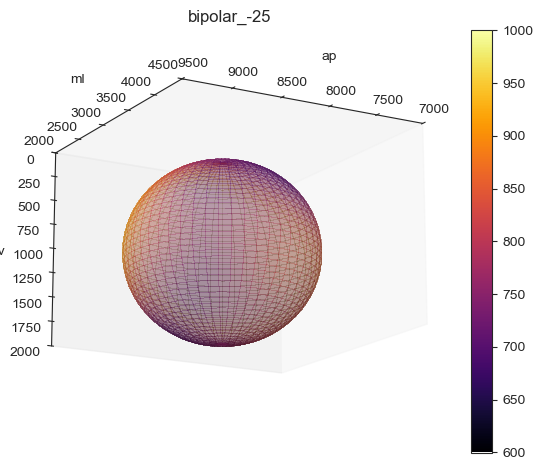

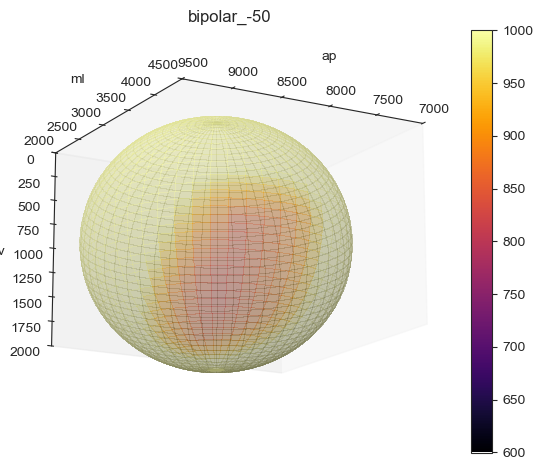

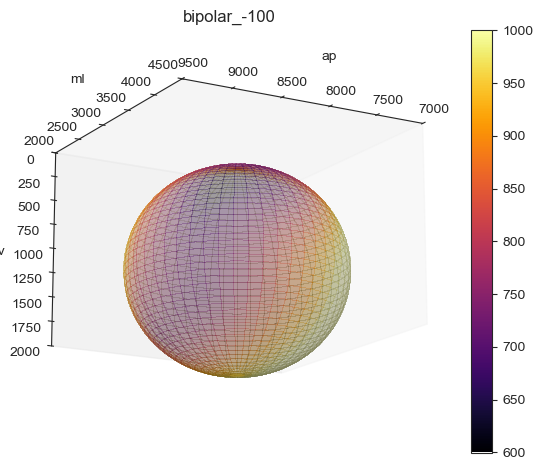

In [164]:
pol = 'bipolar'
for amp in ['_-25','_-50','_-100']:

  distances = avg_results[pol+amp]['dist']
  x = avg_results[pol+amp]['X']
  y = avg_results[pol+amp]['Y']
  z = avg_results[pol+amp]['Z']
  r = avg_results[pol+amp]['r']

  xs,ys,zs = [],[],[]
  for rec in ['_0','_1','_2','_3']:
    try:
      fitted_params_ = fit_dict[pol+amp+rec]
      xs.append(fitted_params_[0])
      ys.append(fitted_params_[1])
      zs.append(fitted_params_[2])
    except:pass
  fitted_params = [np.mean(np.array(xs)),np.mean(np.array(ys)),np.mean(np.array(zs))]

  fig = plt.figure()
  ax = fig.add_subplot(projection='3d')
  
  ax.view_init(elev=-15, azim=60, roll=0)
  
  ax.grid(False)
  scamap = plt.cm.ScalarMappable(cmap='inferno')
  scamap.set_clim(600,1000)
  fcolors = scamap.to_rgba(distances)
  # ax.plot_surface(X, Y, Z, facecolors=fcolors, cmap='inferno')

  ax.plot_surface(x+fitted_params[0], y+fitted_params[1], z+fitted_params[2],alpha=0.3,facecolors=fcolors,
                        linewidth=0, antialiased=False)
  ax.set_xlabel('ap')
  ax.set_ylabel('ml')
  ax.set_zlabel('dv')
  #
  ax.set_title(pol+amp)
  ax.set_xlim(7000, 9500)
  ax.set_ylim(2000, 4500)
  ax.set_zlim(0, 2000)
  ax.invert_zaxis()
  fig.colorbar(scamap,ax=ax)
  
  fig.tight_layout()